# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

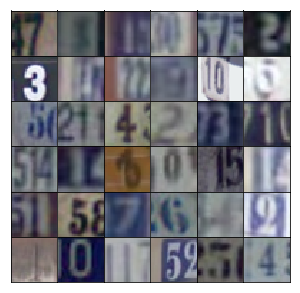

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer, 4*4*512
        x = tf.layers.dense(inputs=z, units=4*4*512, activation=None, name='dense_1')
        x = tf.reshape(x, shape=(-1, 4, 4, 512), name='input_reshape')
        x = tf.layers.batch_normalization(inputs=x, training=training, name='batch_norm_1')
        x = tf.nn.leaky_relu(x, alpha=alpha, name='leaky_relu_1')
        
        # CONV1 [8, 8, 256]
        x1 = tf.layers.conv2d_transpose(inputs=x, filters=256, kernel_size=5, strides=2, padding='SAME' ,activation=None ,name='conv_trans_1')
        x1 = tf.layers.batch_normalization(inputs=x1, training=training, name='batch_norm_2')
        x1 = tf.nn.leaky_relu(features=x1, alpha=alpha, name='leaky_relu_2')
        
        # CONV2 [16, 16, 128]
        x2 = tf.layers.conv2d_transpose(inputs=x1, filters=128, kernel_size=5, strides=2, padding='SAME' ,activation=None ,name='conv_trans_2')
        x2 = tf.layers.batch_normalization(inputs=x2, training=training, name='batch_norm_3')
        x2 = tf.nn.leaky_relu(features=x2, alpha=alpha, name='leaky_relu_3')
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(inputs=x2, filters=3, kernel_size=5, strides=2, padding='SAME')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(inputs=x, filters=64, kernel_size=5, strides=2, padding='same', name='conv1')
        x = tf.nn.leaky_relu(x)
        # 16x16x64
        
        x1 = tf.layers.conv2d(inputs=x, filters=128, kernel_size=5, strides=2, padding='same', name='conv2')
        x1 = tf.layers.batch_normalization(inputs=x1, training=True)
        x1 = tf.nn.leaky_relu(x1)
        # 8x8x128
        
        x2 = tf.layers.conv2d(inputs=x1, filters=256, kernel_size=5, strides=2, padding='same', name='conv3')
        x2 = tf.layers.batch_normalization(inputs=x2, training=True)
        x2 = tf.nn.leaky_relu(x2)
        # 4x4x256
        
        x3 = tf.reshape(tensor=x2, shape=(-1, 4*4*256))
        
        logits = tf.layers.dense(inputs=x3, units=1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        print(tf.GraphKeys.UPDATE_OPS)
        print(tf.get_collection(tf.GraphKeys.UPDATE_OPS))
        print(tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)))
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

update_ops
[<tf.Tensor 'generator/batch_norm_1/AssignMovingAvg:0' shape=(512,) dtype=float32_ref>, <tf.Tensor 'generator/batch_norm_1/AssignMovingAvg_1:0' shape=(512,) dtype=float32_ref>, <tf.Tensor 'generator/batch_norm_2/AssignMovingAvg:0' shape=(256,) dtype=float32_ref>, <tf.Tensor 'generator/batch_norm_2/AssignMovingAvg_1:0' shape=(256,) dtype=float32_ref>, <tf.Tensor 'generator/batch_norm_3/AssignMovingAvg:0' shape=(128,) dtype=float32_ref>, <tf.Tensor 'generator/batch_norm_3/AssignMovingAvg_1:0' shape=(128,) dtype=float32_ref>, <tf.Tensor 'discriminator/batch_normalization/AssignMovingAvg:0' shape=(128,) dtype=float32_ref>, <tf.Tensor 'discriminator/batch_normalization/AssignMovingAvg_1:0' shape=(128,) dtype=float32_ref>, <tf.Tensor 'discriminator/batch_normalization_2/AssignMovingAvg:0' shape=(256,) dtype=float32_ref>, <tf.Tensor 'discriminator/batch_normalization_2/AssignMovingAvg_1:0' shape=(256,) dtype=float32_ref>, <tf.Tensor 'discriminator_1/batch_normalization/AssignMoving

Epoch 1/25... Discriminator Loss: 0.0166... Generator Loss: 9.3657
Epoch 1/25... Discriminator Loss: 0.4172... Generator Loss: 4.2811
Epoch 1/25... Discriminator Loss: 0.6234... Generator Loss: 2.2530
Epoch 1/25... Discriminator Loss: 1.0039... Generator Loss: 0.6751
Epoch 1/25... Discriminator Loss: 1.1619... Generator Loss: 1.7025
Epoch 1/25... Discriminator Loss: 0.4723... Generator Loss: 1.2190
Epoch 1/25... Discriminator Loss: 0.5941... Generator Loss: 1.4315
Epoch 1/25... Discriminator Loss: 0.8262... Generator Loss: 2.5415
Epoch 1/25... Discriminator Loss: 1.0243... Generator Loss: 0.6415
Epoch 1/25... Discriminator Loss: 3.3074... Generator Loss: 0.1357


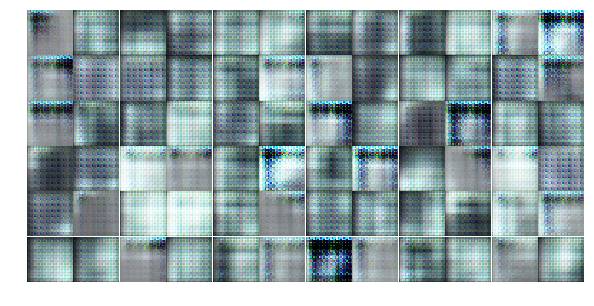

Epoch 1/25... Discriminator Loss: 1.2612... Generator Loss: 1.4065
Epoch 1/25... Discriminator Loss: 0.7046... Generator Loss: 2.0766
Epoch 1/25... Discriminator Loss: 0.7376... Generator Loss: 0.8721
Epoch 1/25... Discriminator Loss: 1.1929... Generator Loss: 0.8261
Epoch 1/25... Discriminator Loss: 0.4189... Generator Loss: 3.3982
Epoch 1/25... Discriminator Loss: 1.4588... Generator Loss: 0.7362
Epoch 1/25... Discriminator Loss: 0.7237... Generator Loss: 0.9705
Epoch 1/25... Discriminator Loss: 0.3683... Generator Loss: 1.5235
Epoch 1/25... Discriminator Loss: 0.7447... Generator Loss: 0.9149
Epoch 1/25... Discriminator Loss: 1.3161... Generator Loss: 1.1089


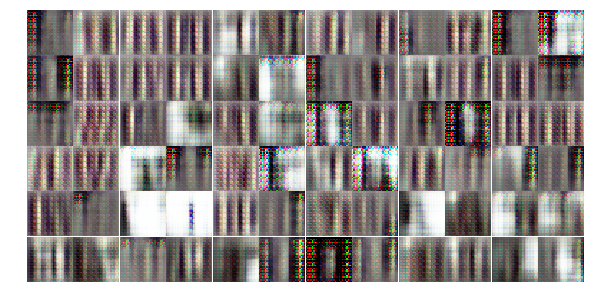

Epoch 1/25... Discriminator Loss: 1.4427... Generator Loss: 0.9124
Epoch 1/25... Discriminator Loss: 0.7871... Generator Loss: 1.0990
Epoch 1/25... Discriminator Loss: 0.8476... Generator Loss: 0.9373
Epoch 1/25... Discriminator Loss: 0.8399... Generator Loss: 1.1460
Epoch 1/25... Discriminator Loss: 0.9926... Generator Loss: 0.9840
Epoch 1/25... Discriminator Loss: 0.9522... Generator Loss: 1.0686
Epoch 1/25... Discriminator Loss: 1.5597... Generator Loss: 2.0502
Epoch 1/25... Discriminator Loss: 1.1952... Generator Loss: 1.0523
Epoch 1/25... Discriminator Loss: 1.4096... Generator Loss: 0.8271
Epoch 1/25... Discriminator Loss: 1.2732... Generator Loss: 0.8360


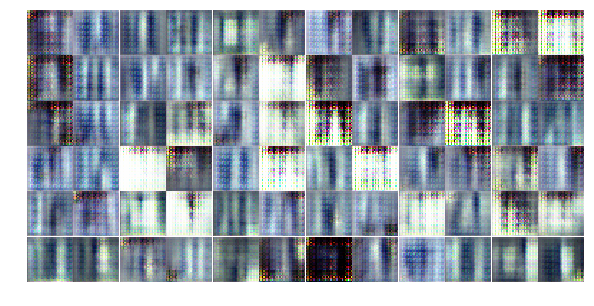

Epoch 1/25... Discriminator Loss: 1.5778... Generator Loss: 0.7044
Epoch 1/25... Discriminator Loss: 1.1739... Generator Loss: 0.7555
Epoch 1/25... Discriminator Loss: 1.0722... Generator Loss: 1.9518
Epoch 1/25... Discriminator Loss: 1.1049... Generator Loss: 0.8600
Epoch 1/25... Discriminator Loss: 0.8099... Generator Loss: 1.0636
Epoch 1/25... Discriminator Loss: 1.4147... Generator Loss: 1.2683
Epoch 1/25... Discriminator Loss: 1.3469... Generator Loss: 0.7731
Epoch 1/25... Discriminator Loss: 0.9274... Generator Loss: 1.0966
Epoch 1/25... Discriminator Loss: 0.9922... Generator Loss: 0.9637
Epoch 1/25... Discriminator Loss: 1.0525... Generator Loss: 1.1315


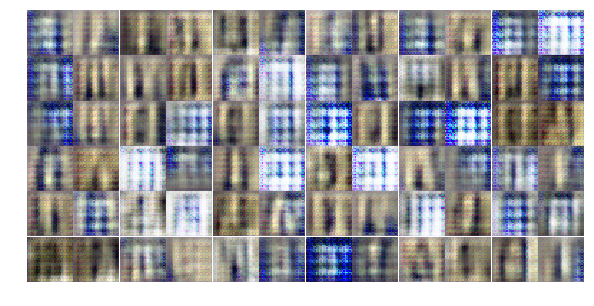

Epoch 1/25... Discriminator Loss: 0.6500... Generator Loss: 1.1294
Epoch 1/25... Discriminator Loss: 1.4896... Generator Loss: 0.6114
Epoch 1/25... Discriminator Loss: 1.0640... Generator Loss: 1.1546
Epoch 1/25... Discriminator Loss: 1.4593... Generator Loss: 1.0614
Epoch 1/25... Discriminator Loss: 1.2900... Generator Loss: 0.8188
Epoch 1/25... Discriminator Loss: 1.5510... Generator Loss: 0.5971
Epoch 1/25... Discriminator Loss: 1.5354... Generator Loss: 0.6908
Epoch 1/25... Discriminator Loss: 1.2728... Generator Loss: 0.8675
Epoch 1/25... Discriminator Loss: 1.3871... Generator Loss: 0.7145
Epoch 1/25... Discriminator Loss: 1.1097... Generator Loss: 0.9352


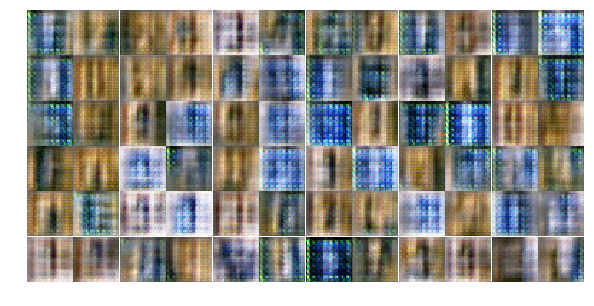

Epoch 1/25... Discriminator Loss: 1.1907... Generator Loss: 0.7870
Epoch 1/25... Discriminator Loss: 1.1280... Generator Loss: 1.4582
Epoch 1/25... Discriminator Loss: 1.2593... Generator Loss: 0.6194
Epoch 1/25... Discriminator Loss: 1.5716... Generator Loss: 1.0026
Epoch 1/25... Discriminator Loss: 1.3000... Generator Loss: 0.9798
Epoch 1/25... Discriminator Loss: 1.3758... Generator Loss: 0.7396
Epoch 1/25... Discriminator Loss: 1.5105... Generator Loss: 0.6062
Epoch 2/25... Discriminator Loss: 1.3173... Generator Loss: 0.8145
Epoch 2/25... Discriminator Loss: 1.3483... Generator Loss: 0.9030
Epoch 2/25... Discriminator Loss: 1.3490... Generator Loss: 0.9668


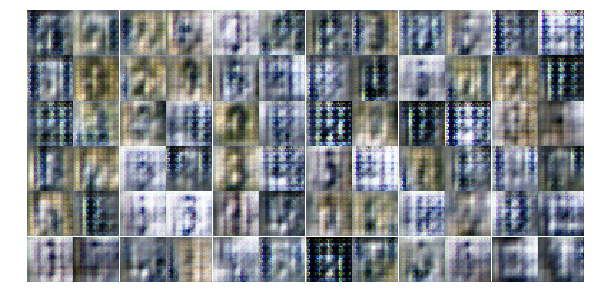

Epoch 2/25... Discriminator Loss: 1.3401... Generator Loss: 0.7779
Epoch 2/25... Discriminator Loss: 1.5111... Generator Loss: 0.8244
Epoch 2/25... Discriminator Loss: 1.1895... Generator Loss: 0.6998
Epoch 2/25... Discriminator Loss: 1.3724... Generator Loss: 1.0730
Epoch 2/25... Discriminator Loss: 1.2647... Generator Loss: 1.0507
Epoch 2/25... Discriminator Loss: 1.7981... Generator Loss: 0.8344
Epoch 2/25... Discriminator Loss: 1.3966... Generator Loss: 0.9669
Epoch 2/25... Discriminator Loss: 1.0302... Generator Loss: 1.0086
Epoch 2/25... Discriminator Loss: 1.0807... Generator Loss: 0.9253
Epoch 2/25... Discriminator Loss: 1.2593... Generator Loss: 0.8840


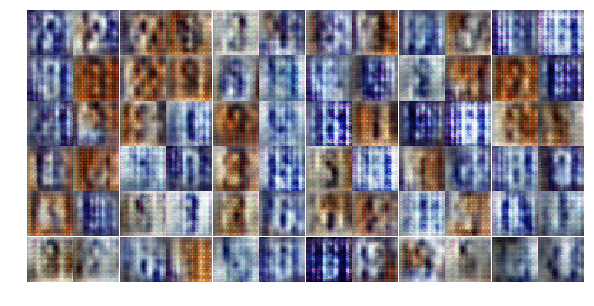

Epoch 2/25... Discriminator Loss: 1.3149... Generator Loss: 0.6772
Epoch 2/25... Discriminator Loss: 1.4431... Generator Loss: 0.9740
Epoch 2/25... Discriminator Loss: 1.6502... Generator Loss: 0.7474
Epoch 2/25... Discriminator Loss: 1.2926... Generator Loss: 0.7395
Epoch 2/25... Discriminator Loss: 1.0118... Generator Loss: 1.1189
Epoch 2/25... Discriminator Loss: 1.1564... Generator Loss: 0.8335
Epoch 2/25... Discriminator Loss: 1.1832... Generator Loss: 1.0116
Epoch 2/25... Discriminator Loss: 1.3172... Generator Loss: 1.2535
Epoch 2/25... Discriminator Loss: 1.3919... Generator Loss: 1.2848
Epoch 2/25... Discriminator Loss: 1.3046... Generator Loss: 0.8349


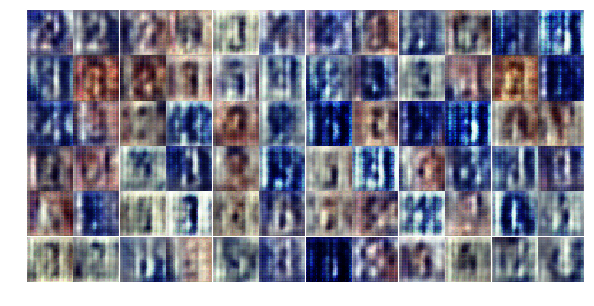

Epoch 2/25... Discriminator Loss: 1.3738... Generator Loss: 1.2482
Epoch 2/25... Discriminator Loss: 1.1464... Generator Loss: 0.9835
Epoch 2/25... Discriminator Loss: 1.3770... Generator Loss: 0.9090
Epoch 2/25... Discriminator Loss: 0.7536... Generator Loss: 1.2374
Epoch 2/25... Discriminator Loss: 1.0224... Generator Loss: 1.4377
Epoch 2/25... Discriminator Loss: 1.3455... Generator Loss: 0.7761
Epoch 2/25... Discriminator Loss: 1.5647... Generator Loss: 0.5932
Epoch 2/25... Discriminator Loss: 1.2281... Generator Loss: 0.8923
Epoch 2/25... Discriminator Loss: 1.5805... Generator Loss: 0.7320
Epoch 2/25... Discriminator Loss: 1.4152... Generator Loss: 0.6984


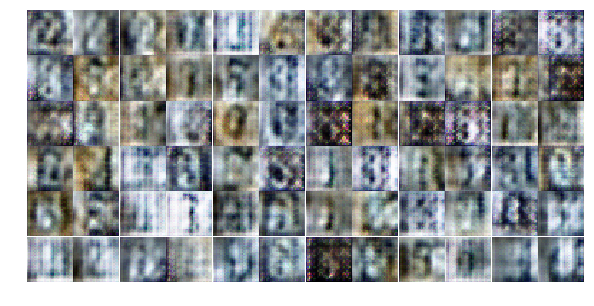

Epoch 2/25... Discriminator Loss: 1.2449... Generator Loss: 0.6841
Epoch 2/25... Discriminator Loss: 1.0737... Generator Loss: 1.0270
Epoch 2/25... Discriminator Loss: 1.2792... Generator Loss: 0.5314
Epoch 2/25... Discriminator Loss: 1.2710... Generator Loss: 0.8280
Epoch 2/25... Discriminator Loss: 1.2799... Generator Loss: 0.8491
Epoch 2/25... Discriminator Loss: 1.3326... Generator Loss: 0.7873
Epoch 2/25... Discriminator Loss: 1.4048... Generator Loss: 0.8719
Epoch 2/25... Discriminator Loss: 1.2821... Generator Loss: 0.7779
Epoch 2/25... Discriminator Loss: 1.4412... Generator Loss: 0.7945
Epoch 2/25... Discriminator Loss: 1.3226... Generator Loss: 0.7626


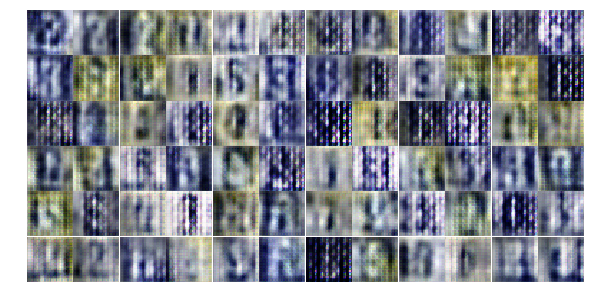

Epoch 2/25... Discriminator Loss: 1.2654... Generator Loss: 0.9090
Epoch 2/25... Discriminator Loss: 1.2240... Generator Loss: 0.8760
Epoch 2/25... Discriminator Loss: 1.4713... Generator Loss: 0.7433
Epoch 2/25... Discriminator Loss: 1.1510... Generator Loss: 0.8820
Epoch 2/25... Discriminator Loss: 1.2463... Generator Loss: 0.9342
Epoch 2/25... Discriminator Loss: 1.4287... Generator Loss: 0.7684
Epoch 2/25... Discriminator Loss: 1.2842... Generator Loss: 0.7849
Epoch 2/25... Discriminator Loss: 1.1799... Generator Loss: 0.9030
Epoch 2/25... Discriminator Loss: 1.3694... Generator Loss: 0.8694
Epoch 2/25... Discriminator Loss: 1.3012... Generator Loss: 0.9756


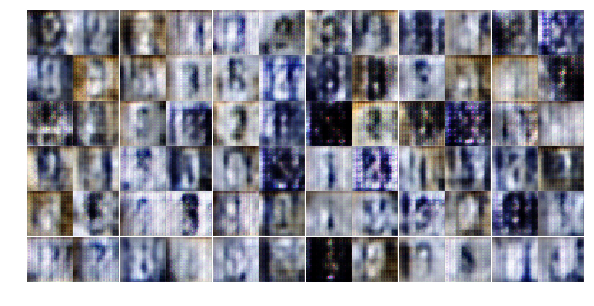

Epoch 2/25... Discriminator Loss: 1.2552... Generator Loss: 0.6057
Epoch 2/25... Discriminator Loss: 1.5842... Generator Loss: 1.5213
Epoch 2/25... Discriminator Loss: 1.1909... Generator Loss: 0.7777
Epoch 2/25... Discriminator Loss: 1.3821... Generator Loss: 0.8961
Epoch 3/25... Discriminator Loss: 0.9740... Generator Loss: 1.2619
Epoch 3/25... Discriminator Loss: 1.2137... Generator Loss: 0.8541
Epoch 3/25... Discriminator Loss: 1.5615... Generator Loss: 0.8529
Epoch 3/25... Discriminator Loss: 1.0297... Generator Loss: 1.2153
Epoch 3/25... Discriminator Loss: 1.3206... Generator Loss: 0.8017
Epoch 3/25... Discriminator Loss: 1.3176... Generator Loss: 0.7023


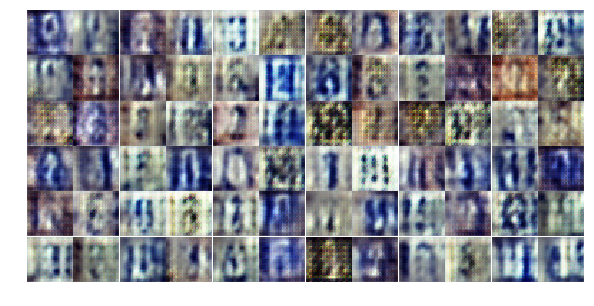

Epoch 3/25... Discriminator Loss: 1.2421... Generator Loss: 1.1190
Epoch 3/25... Discriminator Loss: 0.9858... Generator Loss: 0.9004
Epoch 3/25... Discriminator Loss: 1.2692... Generator Loss: 0.8115
Epoch 3/25... Discriminator Loss: 1.2373... Generator Loss: 0.8661
Epoch 3/25... Discriminator Loss: 1.5032... Generator Loss: 0.8832
Epoch 3/25... Discriminator Loss: 1.1539... Generator Loss: 0.8085
Epoch 3/25... Discriminator Loss: 1.0776... Generator Loss: 1.1552
Epoch 3/25... Discriminator Loss: 1.1736... Generator Loss: 1.0213
Epoch 3/25... Discriminator Loss: 1.1763... Generator Loss: 0.8648
Epoch 3/25... Discriminator Loss: 1.3757... Generator Loss: 0.5567


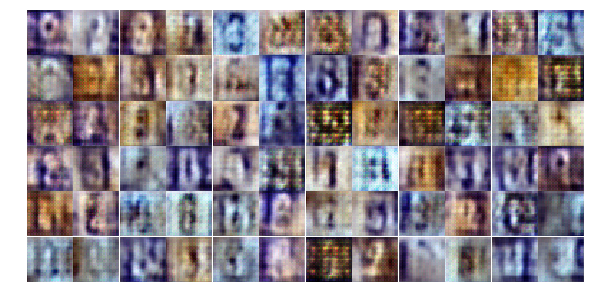

Epoch 3/25... Discriminator Loss: 1.1938... Generator Loss: 1.0710
Epoch 3/25... Discriminator Loss: 1.3046... Generator Loss: 0.8310
Epoch 3/25... Discriminator Loss: 1.2779... Generator Loss: 0.7709
Epoch 3/25... Discriminator Loss: 1.4909... Generator Loss: 0.8402
Epoch 3/25... Discriminator Loss: 1.4848... Generator Loss: 0.5016
Epoch 3/25... Discriminator Loss: 1.9980... Generator Loss: 2.7568
Epoch 3/25... Discriminator Loss: 1.2560... Generator Loss: 0.8457
Epoch 3/25... Discriminator Loss: 1.6185... Generator Loss: 1.0919
Epoch 3/25... Discriminator Loss: 1.2326... Generator Loss: 0.9104
Epoch 3/25... Discriminator Loss: 1.1817... Generator Loss: 0.8824


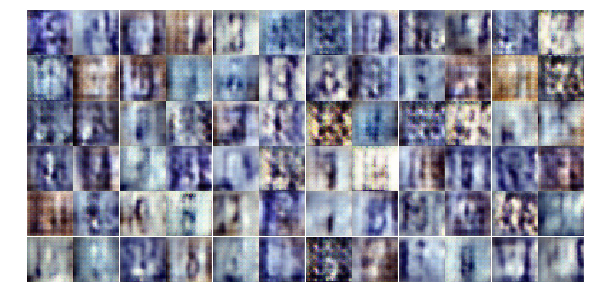

Epoch 3/25... Discriminator Loss: 1.1056... Generator Loss: 0.8048
Epoch 3/25... Discriminator Loss: 1.2345... Generator Loss: 0.8002
Epoch 3/25... Discriminator Loss: 1.3289... Generator Loss: 0.6212
Epoch 3/25... Discriminator Loss: 1.3616... Generator Loss: 0.6472
Epoch 3/25... Discriminator Loss: 1.6334... Generator Loss: 0.6275
Epoch 3/25... Discriminator Loss: 1.1226... Generator Loss: 0.8480
Epoch 3/25... Discriminator Loss: 1.2374... Generator Loss: 0.7616
Epoch 3/25... Discriminator Loss: 1.2867... Generator Loss: 0.8299
Epoch 3/25... Discriminator Loss: 1.1750... Generator Loss: 0.8760
Epoch 3/25... Discriminator Loss: 1.1214... Generator Loss: 0.6249


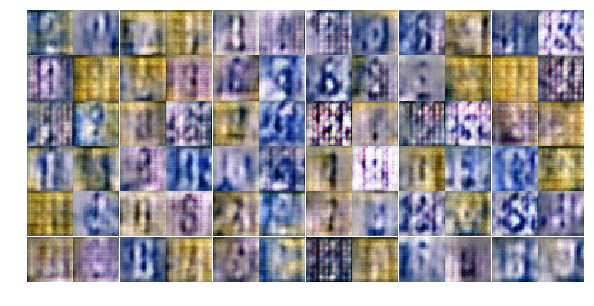

Epoch 3/25... Discriminator Loss: 1.0851... Generator Loss: 0.9416
Epoch 3/25... Discriminator Loss: 1.2042... Generator Loss: 0.7483
Epoch 3/25... Discriminator Loss: 1.1592... Generator Loss: 1.4398
Epoch 3/25... Discriminator Loss: 1.2287... Generator Loss: 0.7822
Epoch 3/25... Discriminator Loss: 1.6037... Generator Loss: 1.3014
Epoch 3/25... Discriminator Loss: 1.1553... Generator Loss: 0.8677
Epoch 3/25... Discriminator Loss: 1.3217... Generator Loss: 0.7920
Epoch 3/25... Discriminator Loss: 1.2530... Generator Loss: 0.8443
Epoch 3/25... Discriminator Loss: 1.2671... Generator Loss: 0.9448
Epoch 3/25... Discriminator Loss: 1.2693... Generator Loss: 0.6821


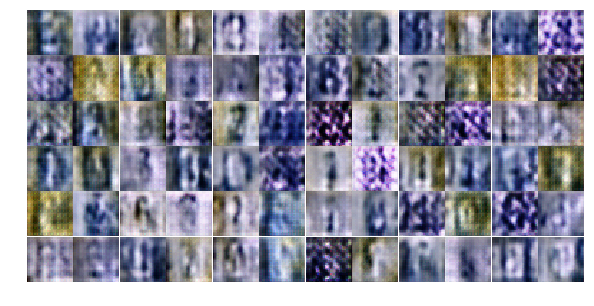

Epoch 3/25... Discriminator Loss: 1.3394... Generator Loss: 0.7423
Epoch 3/25... Discriminator Loss: 1.2115... Generator Loss: 0.7649
Epoch 3/25... Discriminator Loss: 1.1178... Generator Loss: 0.8102
Epoch 3/25... Discriminator Loss: 1.4244... Generator Loss: 0.6649
Epoch 3/25... Discriminator Loss: 1.0362... Generator Loss: 0.7430
Epoch 3/25... Discriminator Loss: 1.0800... Generator Loss: 0.9124
Epoch 3/25... Discriminator Loss: 1.3030... Generator Loss: 0.7588
Epoch 3/25... Discriminator Loss: 1.0054... Generator Loss: 0.8714
Epoch 3/25... Discriminator Loss: 1.1410... Generator Loss: 0.7823
Epoch 3/25... Discriminator Loss: 1.2601... Generator Loss: 0.8772


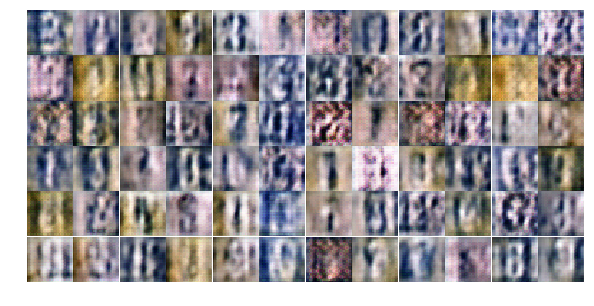

Epoch 3/25... Discriminator Loss: 1.4923... Generator Loss: 0.6620
Epoch 4/25... Discriminator Loss: 1.0125... Generator Loss: 0.8710
Epoch 4/25... Discriminator Loss: 1.3693... Generator Loss: 1.4010
Epoch 4/25... Discriminator Loss: 1.3292... Generator Loss: 0.5401
Epoch 4/25... Discriminator Loss: 1.1764... Generator Loss: 0.9376
Epoch 4/25... Discriminator Loss: 1.1056... Generator Loss: 1.1123
Epoch 4/25... Discriminator Loss: 1.1106... Generator Loss: 0.9605
Epoch 4/25... Discriminator Loss: 1.2788... Generator Loss: 0.7810
Epoch 4/25... Discriminator Loss: 1.3214... Generator Loss: 0.5888
Epoch 4/25... Discriminator Loss: 1.4352... Generator Loss: 0.6503


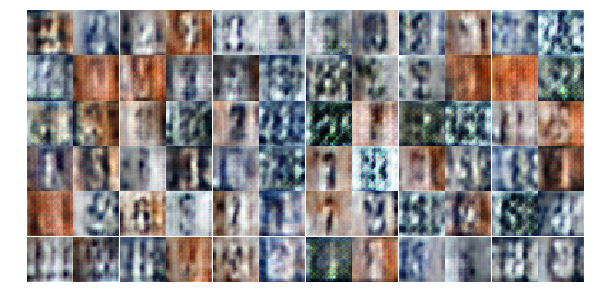

Epoch 4/25... Discriminator Loss: 1.3633... Generator Loss: 0.7804
Epoch 4/25... Discriminator Loss: 1.1433... Generator Loss: 0.8251
Epoch 4/25... Discriminator Loss: 1.1981... Generator Loss: 0.8828
Epoch 4/25... Discriminator Loss: 1.2498... Generator Loss: 0.8943
Epoch 4/25... Discriminator Loss: 1.3295... Generator Loss: 0.8745
Epoch 4/25... Discriminator Loss: 1.0076... Generator Loss: 0.8565
Epoch 4/25... Discriminator Loss: 1.0749... Generator Loss: 1.0301
Epoch 4/25... Discriminator Loss: 1.1858... Generator Loss: 0.9704
Epoch 4/25... Discriminator Loss: 1.1293... Generator Loss: 0.8473
Epoch 4/25... Discriminator Loss: 1.2644... Generator Loss: 1.2190


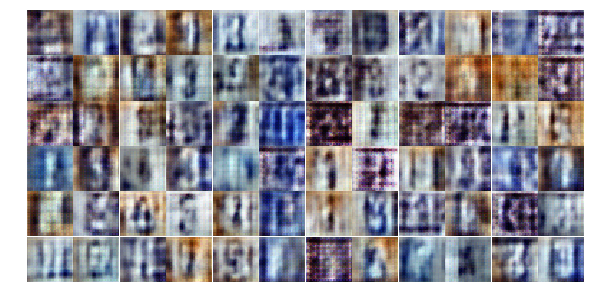

Epoch 4/25... Discriminator Loss: 1.2900... Generator Loss: 0.7741
Epoch 4/25... Discriminator Loss: 1.0865... Generator Loss: 1.2722
Epoch 4/25... Discriminator Loss: 1.3070... Generator Loss: 0.9466
Epoch 4/25... Discriminator Loss: 1.3407... Generator Loss: 0.6679
Epoch 4/25... Discriminator Loss: 1.1583... Generator Loss: 1.0770
Epoch 4/25... Discriminator Loss: 1.0780... Generator Loss: 1.1456
Epoch 4/25... Discriminator Loss: 1.4875... Generator Loss: 0.5690
Epoch 4/25... Discriminator Loss: 1.0106... Generator Loss: 0.7754
Epoch 4/25... Discriminator Loss: 1.1144... Generator Loss: 0.9164
Epoch 4/25... Discriminator Loss: 1.2357... Generator Loss: 0.8481


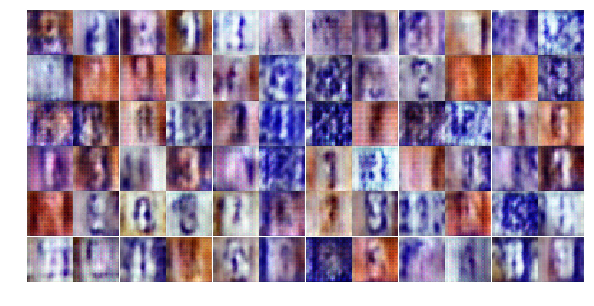

Epoch 4/25... Discriminator Loss: 1.0876... Generator Loss: 0.7724
Epoch 4/25... Discriminator Loss: 1.0825... Generator Loss: 1.2032
Epoch 4/25... Discriminator Loss: 1.0863... Generator Loss: 1.0713
Epoch 4/25... Discriminator Loss: 1.1297... Generator Loss: 1.7013
Epoch 4/25... Discriminator Loss: 1.2550... Generator Loss: 0.7472
Epoch 4/25... Discriminator Loss: 0.9643... Generator Loss: 1.1895
Epoch 4/25... Discriminator Loss: 1.0529... Generator Loss: 0.7675
Epoch 4/25... Discriminator Loss: 1.1367... Generator Loss: 1.1130
Epoch 4/25... Discriminator Loss: 1.0549... Generator Loss: 0.8915
Epoch 4/25... Discriminator Loss: 0.8982... Generator Loss: 0.9329


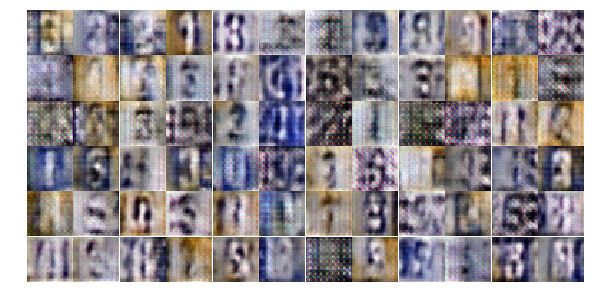

Epoch 4/25... Discriminator Loss: 1.4051... Generator Loss: 0.3801
Epoch 4/25... Discriminator Loss: 1.0985... Generator Loss: 0.8743
Epoch 4/25... Discriminator Loss: 1.3451... Generator Loss: 0.8331
Epoch 4/25... Discriminator Loss: 0.8976... Generator Loss: 1.2665
Epoch 4/25... Discriminator Loss: 0.9020... Generator Loss: 1.0284
Epoch 4/25... Discriminator Loss: 1.0429... Generator Loss: 0.7293
Epoch 4/25... Discriminator Loss: 0.6859... Generator Loss: 1.4854
Epoch 4/25... Discriminator Loss: 1.3030... Generator Loss: 0.7610
Epoch 4/25... Discriminator Loss: 1.0617... Generator Loss: 0.7967
Epoch 4/25... Discriminator Loss: 1.6187... Generator Loss: 0.5139


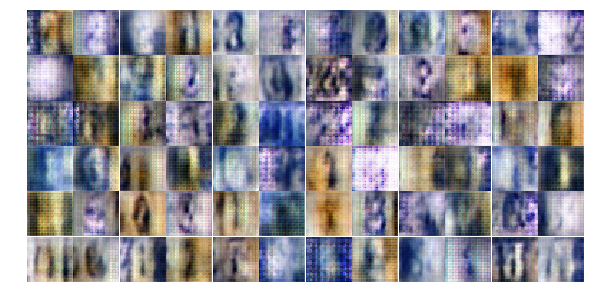

Epoch 4/25... Discriminator Loss: 0.9246... Generator Loss: 1.1169
Epoch 4/25... Discriminator Loss: 1.1452... Generator Loss: 1.1239
Epoch 4/25... Discriminator Loss: 1.0833... Generator Loss: 0.8017
Epoch 4/25... Discriminator Loss: 0.7245... Generator Loss: 1.4901
Epoch 4/25... Discriminator Loss: 1.2438... Generator Loss: 0.7805
Epoch 4/25... Discriminator Loss: 1.3592... Generator Loss: 0.7792
Epoch 4/25... Discriminator Loss: 0.9915... Generator Loss: 0.9839
Epoch 4/25... Discriminator Loss: 1.2050... Generator Loss: 0.8844
Epoch 4/25... Discriminator Loss: 1.1069... Generator Loss: 0.8922
Epoch 5/25... Discriminator Loss: 1.0008... Generator Loss: 0.9885


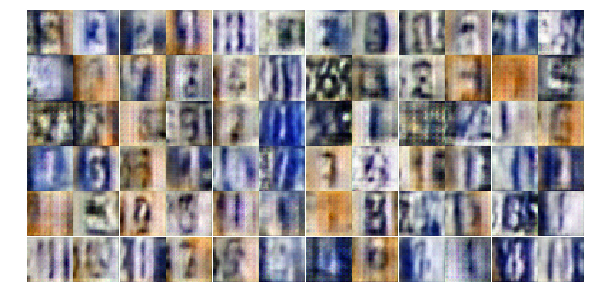

Epoch 5/25... Discriminator Loss: 1.1617... Generator Loss: 0.7499
Epoch 5/25... Discriminator Loss: 1.3085... Generator Loss: 0.6425
Epoch 5/25... Discriminator Loss: 1.3945... Generator Loss: 1.2122
Epoch 5/25... Discriminator Loss: 1.0078... Generator Loss: 0.9267
Epoch 5/25... Discriminator Loss: 1.3545... Generator Loss: 0.9519
Epoch 5/25... Discriminator Loss: 1.2041... Generator Loss: 0.9973
Epoch 5/25... Discriminator Loss: 1.4134... Generator Loss: 0.4959
Epoch 5/25... Discriminator Loss: 1.3350... Generator Loss: 0.8454
Epoch 5/25... Discriminator Loss: 1.1667... Generator Loss: 0.7881
Epoch 5/25... Discriminator Loss: 1.3495... Generator Loss: 0.8972


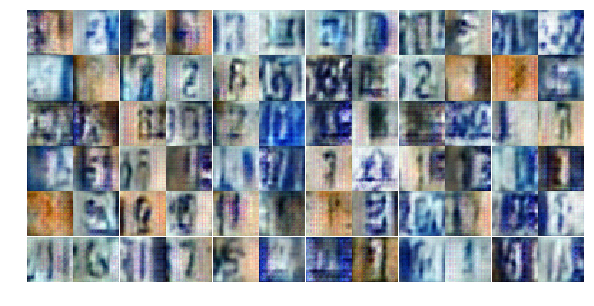

Epoch 5/25... Discriminator Loss: 1.0190... Generator Loss: 1.1182
Epoch 5/25... Discriminator Loss: 1.3829... Generator Loss: 1.4066
Epoch 5/25... Discriminator Loss: 1.1702... Generator Loss: 0.9505
Epoch 5/25... Discriminator Loss: 1.6700... Generator Loss: 0.3586
Epoch 5/25... Discriminator Loss: 1.1199... Generator Loss: 0.8772
Epoch 5/25... Discriminator Loss: 1.3125... Generator Loss: 0.5819
Epoch 5/25... Discriminator Loss: 1.5373... Generator Loss: 0.4468
Epoch 5/25... Discriminator Loss: 1.3267... Generator Loss: 0.4775
Epoch 5/25... Discriminator Loss: 1.0438... Generator Loss: 1.0463
Epoch 5/25... Discriminator Loss: 1.1352... Generator Loss: 0.9300


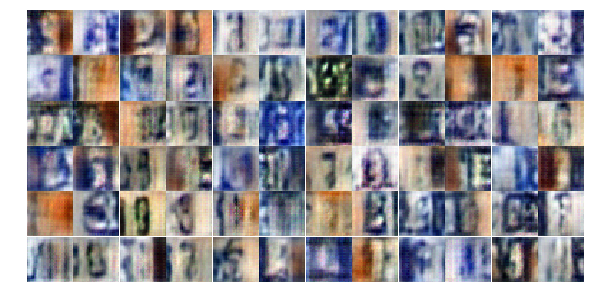

Epoch 5/25... Discriminator Loss: 1.3150... Generator Loss: 0.7585
Epoch 5/25... Discriminator Loss: 1.3135... Generator Loss: 1.2605
Epoch 5/25... Discriminator Loss: 1.4469... Generator Loss: 0.4246
Epoch 5/25... Discriminator Loss: 1.0594... Generator Loss: 0.8415
Epoch 5/25... Discriminator Loss: 1.3042... Generator Loss: 0.6932
Epoch 5/25... Discriminator Loss: 0.9986... Generator Loss: 0.8536
Epoch 5/25... Discriminator Loss: 1.4921... Generator Loss: 0.4085
Epoch 5/25... Discriminator Loss: 1.2028... Generator Loss: 0.8646
Epoch 5/25... Discriminator Loss: 1.3761... Generator Loss: 0.6741
Epoch 5/25... Discriminator Loss: 1.0290... Generator Loss: 1.3087


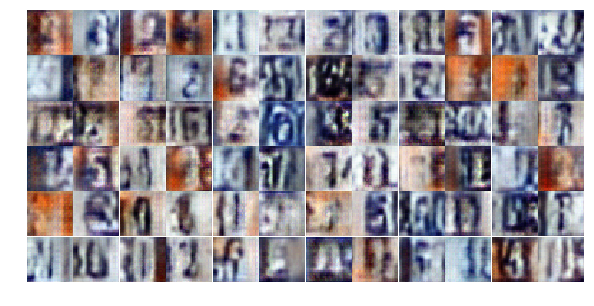

Epoch 5/25... Discriminator Loss: 1.4198... Generator Loss: 0.8413
Epoch 5/25... Discriminator Loss: 1.1700... Generator Loss: 0.7432
Epoch 5/25... Discriminator Loss: 1.2024... Generator Loss: 0.8985
Epoch 5/25... Discriminator Loss: 1.0972... Generator Loss: 1.3124
Epoch 5/25... Discriminator Loss: 1.3476... Generator Loss: 0.5926
Epoch 5/25... Discriminator Loss: 1.1491... Generator Loss: 1.1343
Epoch 5/25... Discriminator Loss: 1.1022... Generator Loss: 1.1180
Epoch 5/25... Discriminator Loss: 1.1943... Generator Loss: 0.8596
Epoch 5/25... Discriminator Loss: 1.2656... Generator Loss: 0.5654
Epoch 5/25... Discriminator Loss: 1.4243... Generator Loss: 0.6440


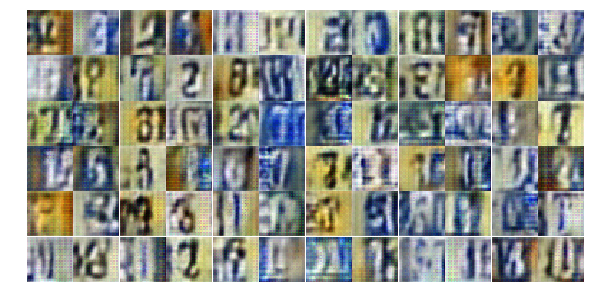

Epoch 5/25... Discriminator Loss: 1.2826... Generator Loss: 0.6047
Epoch 5/25... Discriminator Loss: 1.3404... Generator Loss: 0.4727
Epoch 5/25... Discriminator Loss: 1.5061... Generator Loss: 0.3792
Epoch 5/25... Discriminator Loss: 1.3597... Generator Loss: 0.6233
Epoch 5/25... Discriminator Loss: 1.3791... Generator Loss: 0.7914
Epoch 5/25... Discriminator Loss: 1.1451... Generator Loss: 0.7157
Epoch 5/25... Discriminator Loss: 1.3072... Generator Loss: 0.7397
Epoch 5/25... Discriminator Loss: 1.1684... Generator Loss: 1.1144
Epoch 5/25... Discriminator Loss: 1.3411... Generator Loss: 0.4840
Epoch 5/25... Discriminator Loss: 1.2362... Generator Loss: 0.7968


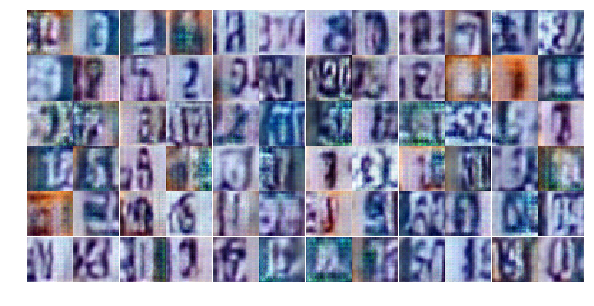

Epoch 5/25... Discriminator Loss: 1.1551... Generator Loss: 0.7630
Epoch 5/25... Discriminator Loss: 1.1988... Generator Loss: 0.6358
Epoch 5/25... Discriminator Loss: 1.4394... Generator Loss: 0.9245
Epoch 5/25... Discriminator Loss: 1.3801... Generator Loss: 0.4143
Epoch 5/25... Discriminator Loss: 1.7080... Generator Loss: 0.2935
Epoch 5/25... Discriminator Loss: 1.1979... Generator Loss: 1.2568
Epoch 6/25... Discriminator Loss: 1.2411... Generator Loss: 0.7501
Epoch 6/25... Discriminator Loss: 1.1693... Generator Loss: 1.5661
Epoch 6/25... Discriminator Loss: 1.2211... Generator Loss: 1.1239
Epoch 6/25... Discriminator Loss: 1.3046... Generator Loss: 0.5671


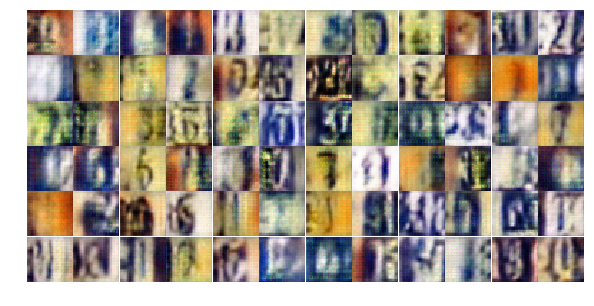

Epoch 6/25... Discriminator Loss: 1.5464... Generator Loss: 1.3901
Epoch 6/25... Discriminator Loss: 1.4137... Generator Loss: 1.0512
Epoch 6/25... Discriminator Loss: 1.1170... Generator Loss: 1.4404
Epoch 6/25... Discriminator Loss: 1.2531... Generator Loss: 0.7599
Epoch 6/25... Discriminator Loss: 1.2124... Generator Loss: 0.6801
Epoch 6/25... Discriminator Loss: 1.1842... Generator Loss: 0.6073
Epoch 6/25... Discriminator Loss: 1.1299... Generator Loss: 1.0842
Epoch 6/25... Discriminator Loss: 1.2842... Generator Loss: 0.6589
Epoch 6/25... Discriminator Loss: 1.2634... Generator Loss: 0.5987
Epoch 6/25... Discriminator Loss: 1.2863... Generator Loss: 0.5896


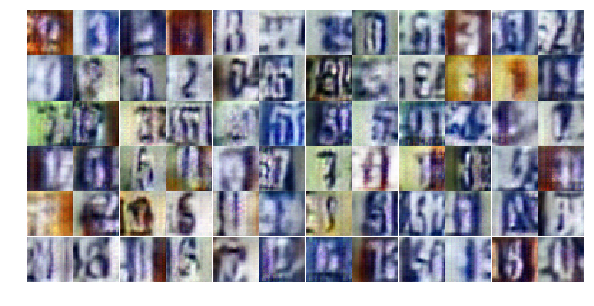

Epoch 6/25... Discriminator Loss: 1.2072... Generator Loss: 0.7364
Epoch 6/25... Discriminator Loss: 1.2530... Generator Loss: 1.0052
Epoch 6/25... Discriminator Loss: 1.3385... Generator Loss: 0.4849
Epoch 6/25... Discriminator Loss: 1.0291... Generator Loss: 0.9794
Epoch 6/25... Discriminator Loss: 1.1034... Generator Loss: 0.6638
Epoch 6/25... Discriminator Loss: 1.0382... Generator Loss: 0.8418
Epoch 6/25... Discriminator Loss: 1.0485... Generator Loss: 0.8320
Epoch 6/25... Discriminator Loss: 1.2839... Generator Loss: 0.8960
Epoch 6/25... Discriminator Loss: 1.3145... Generator Loss: 0.4467
Epoch 6/25... Discriminator Loss: 1.1862... Generator Loss: 0.8160


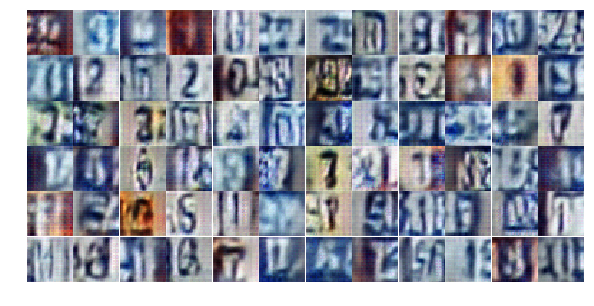

Epoch 6/25... Discriminator Loss: 1.5904... Generator Loss: 0.4196
Epoch 6/25... Discriminator Loss: 0.8322... Generator Loss: 1.1109
Epoch 6/25... Discriminator Loss: 1.3166... Generator Loss: 0.5930
Epoch 6/25... Discriminator Loss: 1.4439... Generator Loss: 0.6265
Epoch 6/25... Discriminator Loss: 1.2283... Generator Loss: 1.1367
Epoch 6/25... Discriminator Loss: 1.7696... Generator Loss: 0.2831
Epoch 6/25... Discriminator Loss: 1.2012... Generator Loss: 0.6841
Epoch 6/25... Discriminator Loss: 0.9033... Generator Loss: 1.2575
Epoch 6/25... Discriminator Loss: 1.1644... Generator Loss: 0.7256
Epoch 6/25... Discriminator Loss: 1.3321... Generator Loss: 0.5521


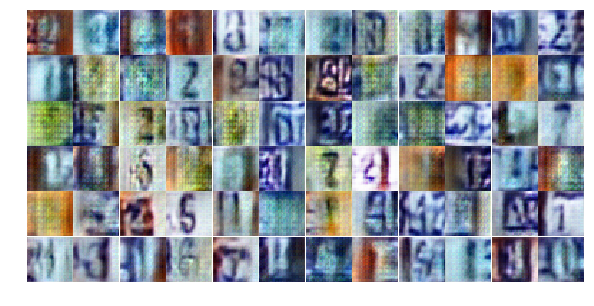

Epoch 6/25... Discriminator Loss: 1.4683... Generator Loss: 0.5462
Epoch 6/25... Discriminator Loss: 1.2560... Generator Loss: 0.6234
Epoch 6/25... Discriminator Loss: 1.1553... Generator Loss: 0.8381
Epoch 6/25... Discriminator Loss: 1.3945... Generator Loss: 0.5162
Epoch 6/25... Discriminator Loss: 1.1458... Generator Loss: 0.6551
Epoch 6/25... Discriminator Loss: 1.1827... Generator Loss: 0.6421
Epoch 6/25... Discriminator Loss: 1.3458... Generator Loss: 0.4548
Epoch 6/25... Discriminator Loss: 0.9785... Generator Loss: 1.8921
Epoch 6/25... Discriminator Loss: 1.3162... Generator Loss: 0.4574
Epoch 6/25... Discriminator Loss: 1.1076... Generator Loss: 0.5835


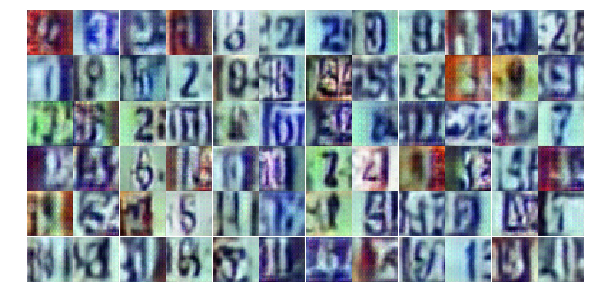

Epoch 6/25... Discriminator Loss: 1.0919... Generator Loss: 1.0381
Epoch 6/25... Discriminator Loss: 1.4190... Generator Loss: 0.5256
Epoch 6/25... Discriminator Loss: 1.3757... Generator Loss: 0.4846
Epoch 6/25... Discriminator Loss: 1.2154... Generator Loss: 0.5893
Epoch 6/25... Discriminator Loss: 1.3639... Generator Loss: 0.4304
Epoch 6/25... Discriminator Loss: 1.0931... Generator Loss: 0.8871
Epoch 6/25... Discriminator Loss: 1.1379... Generator Loss: 0.8047
Epoch 6/25... Discriminator Loss: 1.1833... Generator Loss: 0.9060
Epoch 6/25... Discriminator Loss: 1.0725... Generator Loss: 1.2841
Epoch 6/25... Discriminator Loss: 1.3979... Generator Loss: 0.5649


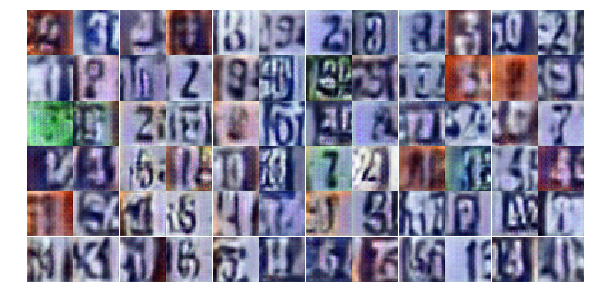

Epoch 6/25... Discriminator Loss: 1.0591... Generator Loss: 1.1251
Epoch 6/25... Discriminator Loss: 1.1511... Generator Loss: 1.1354
Epoch 6/25... Discriminator Loss: 1.0141... Generator Loss: 1.3003
Epoch 7/25... Discriminator Loss: 1.0862... Generator Loss: 0.8182
Epoch 7/25... Discriminator Loss: 1.1539... Generator Loss: 0.7289
Epoch 7/25... Discriminator Loss: 0.9396... Generator Loss: 1.1445
Epoch 7/25... Discriminator Loss: 1.2201... Generator Loss: 0.6642
Epoch 7/25... Discriminator Loss: 1.2211... Generator Loss: 0.6365
Epoch 7/25... Discriminator Loss: 1.0434... Generator Loss: 0.8201
Epoch 7/25... Discriminator Loss: 0.9847... Generator Loss: 0.8145


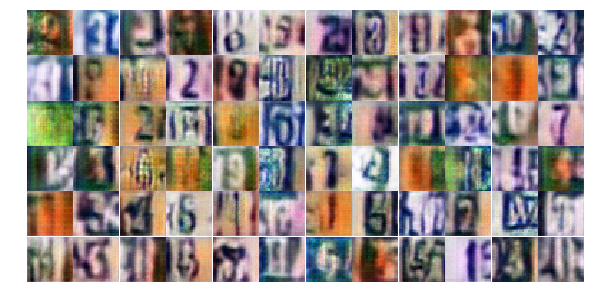

Epoch 7/25... Discriminator Loss: 0.9820... Generator Loss: 1.5108
Epoch 7/25... Discriminator Loss: 1.1820... Generator Loss: 0.9624
Epoch 7/25... Discriminator Loss: 1.2593... Generator Loss: 0.6098
Epoch 7/25... Discriminator Loss: 1.2456... Generator Loss: 0.9827
Epoch 7/25... Discriminator Loss: 1.2946... Generator Loss: 0.6321
Epoch 7/25... Discriminator Loss: 1.1096... Generator Loss: 0.7853
Epoch 7/25... Discriminator Loss: 0.8485... Generator Loss: 1.2933
Epoch 7/25... Discriminator Loss: 1.2757... Generator Loss: 0.7183
Epoch 7/25... Discriminator Loss: 1.1636... Generator Loss: 0.8133
Epoch 7/25... Discriminator Loss: 1.1363... Generator Loss: 0.7480


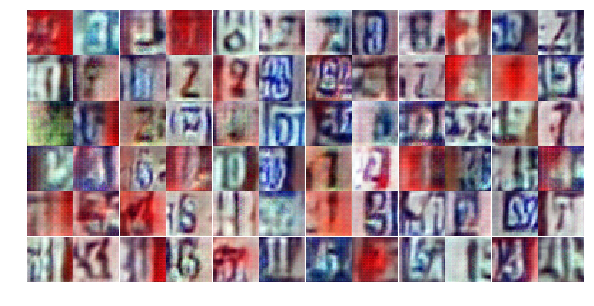

Epoch 7/25... Discriminator Loss: 1.2349... Generator Loss: 1.3819
Epoch 7/25... Discriminator Loss: 1.2081... Generator Loss: 1.2699
Epoch 7/25... Discriminator Loss: 1.3500... Generator Loss: 0.6293
Epoch 7/25... Discriminator Loss: 1.1335... Generator Loss: 0.7971
Epoch 7/25... Discriminator Loss: 0.9587... Generator Loss: 0.9928
Epoch 7/25... Discriminator Loss: 0.9924... Generator Loss: 1.1813
Epoch 7/25... Discriminator Loss: 0.9201... Generator Loss: 0.8874
Epoch 7/25... Discriminator Loss: 1.6019... Generator Loss: 0.3274
Epoch 7/25... Discriminator Loss: 1.0251... Generator Loss: 1.2423
Epoch 7/25... Discriminator Loss: 1.3112... Generator Loss: 0.7227


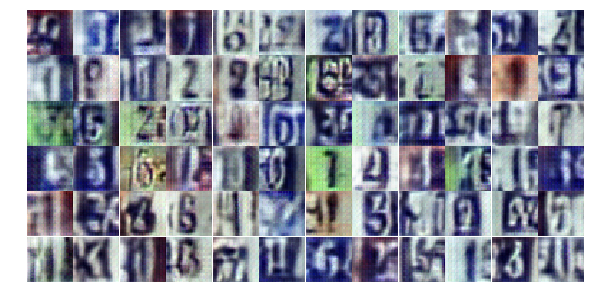

Epoch 7/25... Discriminator Loss: 1.2555... Generator Loss: 0.7570
Epoch 7/25... Discriminator Loss: 1.6301... Generator Loss: 0.2970
Epoch 7/25... Discriminator Loss: 0.8294... Generator Loss: 1.0210
Epoch 7/25... Discriminator Loss: 0.9907... Generator Loss: 0.7425
Epoch 7/25... Discriminator Loss: 1.0058... Generator Loss: 1.0249
Epoch 7/25... Discriminator Loss: 1.6989... Generator Loss: 0.3866
Epoch 7/25... Discriminator Loss: 1.2988... Generator Loss: 0.4962
Epoch 7/25... Discriminator Loss: 1.2829... Generator Loss: 0.6974
Epoch 7/25... Discriminator Loss: 1.3511... Generator Loss: 0.5177
Epoch 7/25... Discriminator Loss: 1.2938... Generator Loss: 0.4940


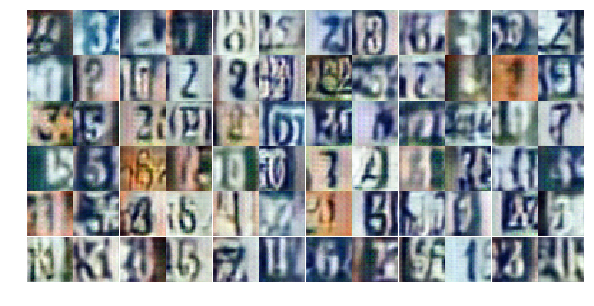

Epoch 7/25... Discriminator Loss: 1.1244... Generator Loss: 0.7237
Epoch 7/25... Discriminator Loss: 1.6110... Generator Loss: 1.5941
Epoch 7/25... Discriminator Loss: 1.0863... Generator Loss: 1.3286
Epoch 7/25... Discriminator Loss: 0.4826... Generator Loss: 1.4075
Epoch 7/25... Discriminator Loss: 1.6292... Generator Loss: 1.3739
Epoch 7/25... Discriminator Loss: 0.9983... Generator Loss: 0.8238
Epoch 7/25... Discriminator Loss: 1.6202... Generator Loss: 0.3003
Epoch 7/25... Discriminator Loss: 1.5157... Generator Loss: 0.8353
Epoch 7/25... Discriminator Loss: 1.1991... Generator Loss: 0.9673
Epoch 7/25... Discriminator Loss: 1.1790... Generator Loss: 1.1481


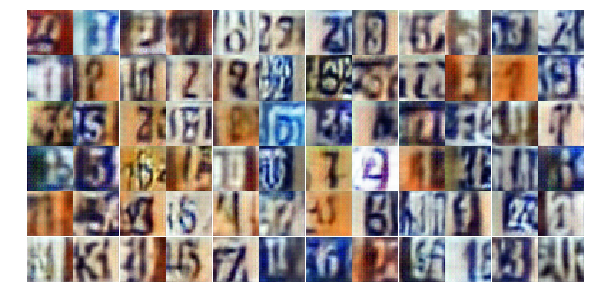

Epoch 7/25... Discriminator Loss: 1.2777... Generator Loss: 0.5949
Epoch 7/25... Discriminator Loss: 1.2760... Generator Loss: 0.6313
Epoch 7/25... Discriminator Loss: 1.2107... Generator Loss: 0.8179
Epoch 7/25... Discriminator Loss: 1.2052... Generator Loss: 0.7380
Epoch 7/25... Discriminator Loss: 0.9375... Generator Loss: 1.1361
Epoch 7/25... Discriminator Loss: 0.6497... Generator Loss: 1.2413
Epoch 7/25... Discriminator Loss: 1.3794... Generator Loss: 0.5132
Epoch 7/25... Discriminator Loss: 1.6314... Generator Loss: 1.4072
Epoch 7/25... Discriminator Loss: 1.4762... Generator Loss: 0.8160
Epoch 7/25... Discriminator Loss: 1.3050... Generator Loss: 0.7381


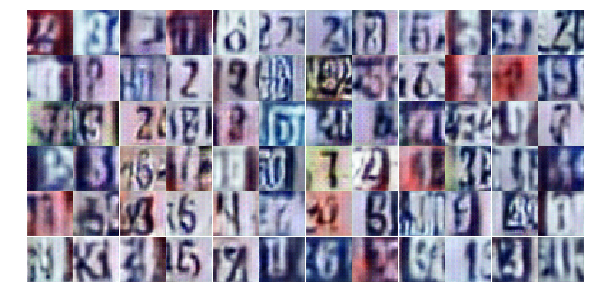

Epoch 7/25... Discriminator Loss: 0.9492... Generator Loss: 1.3583
Epoch 8/25... Discriminator Loss: 1.3288... Generator Loss: 0.6147
Epoch 8/25... Discriminator Loss: 1.2993... Generator Loss: 0.4981
Epoch 8/25... Discriminator Loss: 1.2325... Generator Loss: 0.8683
Epoch 8/25... Discriminator Loss: 1.0103... Generator Loss: 0.9803
Epoch 8/25... Discriminator Loss: 1.3563... Generator Loss: 0.4809
Epoch 8/25... Discriminator Loss: 1.3977... Generator Loss: 0.4305
Epoch 8/25... Discriminator Loss: 0.8877... Generator Loss: 1.5220
Epoch 8/25... Discriminator Loss: 1.4232... Generator Loss: 0.3840
Epoch 8/25... Discriminator Loss: 1.1223... Generator Loss: 0.5828


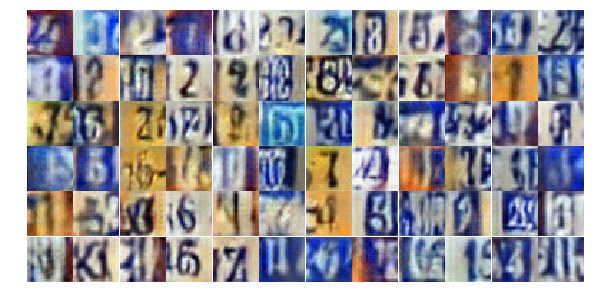

Epoch 8/25... Discriminator Loss: 0.8151... Generator Loss: 1.3804
Epoch 8/25... Discriminator Loss: 0.9581... Generator Loss: 0.8137
Epoch 8/25... Discriminator Loss: 1.3325... Generator Loss: 0.4453
Epoch 8/25... Discriminator Loss: 0.8228... Generator Loss: 1.1593
Epoch 8/25... Discriminator Loss: 1.0945... Generator Loss: 0.8600
Epoch 8/25... Discriminator Loss: 1.3094... Generator Loss: 1.8027
Epoch 8/25... Discriminator Loss: 1.1200... Generator Loss: 0.7659
Epoch 8/25... Discriminator Loss: 0.9279... Generator Loss: 1.2251
Epoch 8/25... Discriminator Loss: 0.9132... Generator Loss: 1.2682
Epoch 8/25... Discriminator Loss: 1.4047... Generator Loss: 0.4985


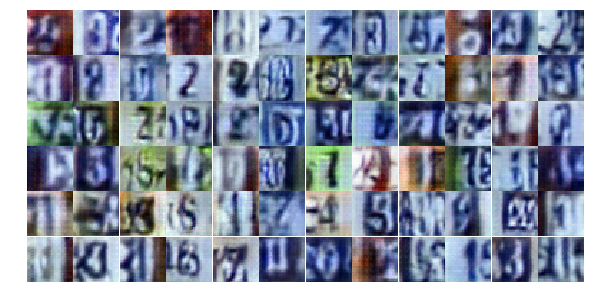

Epoch 8/25... Discriminator Loss: 1.0732... Generator Loss: 1.1610
Epoch 8/25... Discriminator Loss: 1.0733... Generator Loss: 0.6387
Epoch 8/25... Discriminator Loss: 1.3978... Generator Loss: 0.8639
Epoch 8/25... Discriminator Loss: 1.3102... Generator Loss: 0.5769
Epoch 8/25... Discriminator Loss: 0.7462... Generator Loss: 1.3909
Epoch 8/25... Discriminator Loss: 1.3901... Generator Loss: 0.5031
Epoch 8/25... Discriminator Loss: 1.2643... Generator Loss: 1.7374
Epoch 8/25... Discriminator Loss: 0.7300... Generator Loss: 1.0896
Epoch 8/25... Discriminator Loss: 1.4534... Generator Loss: 1.8199
Epoch 8/25... Discriminator Loss: 0.8789... Generator Loss: 1.3248


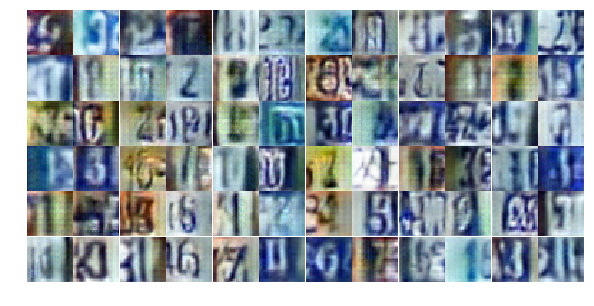

Epoch 8/25... Discriminator Loss: 0.7406... Generator Loss: 1.4767
Epoch 8/25... Discriminator Loss: 1.1142... Generator Loss: 0.8009
Epoch 8/25... Discriminator Loss: 0.9624... Generator Loss: 0.8315
Epoch 8/25... Discriminator Loss: 0.8283... Generator Loss: 1.1434
Epoch 8/25... Discriminator Loss: 1.1909... Generator Loss: 0.7692
Epoch 8/25... Discriminator Loss: 0.8953... Generator Loss: 0.8885
Epoch 8/25... Discriminator Loss: 1.1025... Generator Loss: 0.6692
Epoch 8/25... Discriminator Loss: 0.9482... Generator Loss: 1.2097
Epoch 8/25... Discriminator Loss: 1.0886... Generator Loss: 0.9595
Epoch 8/25... Discriminator Loss: 1.3718... Generator Loss: 0.8513


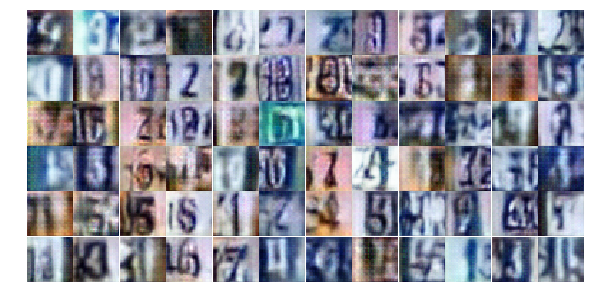

Epoch 8/25... Discriminator Loss: 0.7882... Generator Loss: 1.2900
Epoch 8/25... Discriminator Loss: 1.2008... Generator Loss: 1.3050
Epoch 8/25... Discriminator Loss: 0.8235... Generator Loss: 0.9906
Epoch 8/25... Discriminator Loss: 1.0310... Generator Loss: 0.6298
Epoch 8/25... Discriminator Loss: 1.1638... Generator Loss: 0.7150
Epoch 8/25... Discriminator Loss: 1.0466... Generator Loss: 0.6544
Epoch 8/25... Discriminator Loss: 1.1124... Generator Loss: 1.4350
Epoch 8/25... Discriminator Loss: 1.1575... Generator Loss: 0.7755
Epoch 8/25... Discriminator Loss: 0.7168... Generator Loss: 1.5694
Epoch 8/25... Discriminator Loss: 0.9936... Generator Loss: 1.7519


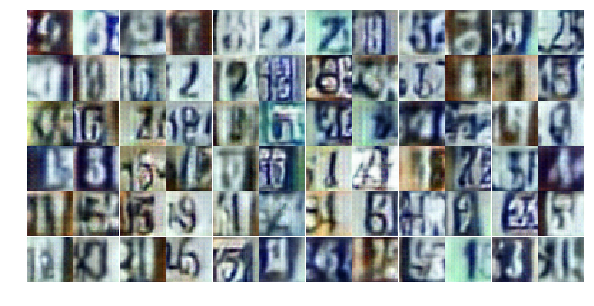

Epoch 8/25... Discriminator Loss: 1.5410... Generator Loss: 1.2303
Epoch 8/25... Discriminator Loss: 1.2746... Generator Loss: 0.5571
Epoch 8/25... Discriminator Loss: 1.4527... Generator Loss: 0.3793
Epoch 8/25... Discriminator Loss: 1.2046... Generator Loss: 0.6171
Epoch 8/25... Discriminator Loss: 0.9395... Generator Loss: 1.2709
Epoch 8/25... Discriminator Loss: 1.1957... Generator Loss: 0.6133
Epoch 8/25... Discriminator Loss: 0.9949... Generator Loss: 0.8381
Epoch 8/25... Discriminator Loss: 1.2131... Generator Loss: 0.7875
Epoch 9/25... Discriminator Loss: 1.2526... Generator Loss: 0.5564
Epoch 9/25... Discriminator Loss: 1.3365... Generator Loss: 0.4658


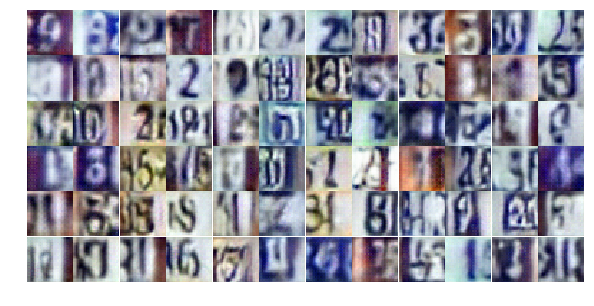

Epoch 9/25... Discriminator Loss: 1.2882... Generator Loss: 0.5591
Epoch 9/25... Discriminator Loss: 1.4362... Generator Loss: 0.4182
Epoch 9/25... Discriminator Loss: 1.0657... Generator Loss: 0.7808
Epoch 9/25... Discriminator Loss: 0.7391... Generator Loss: 1.2601
Epoch 9/25... Discriminator Loss: 0.9433... Generator Loss: 0.8488
Epoch 9/25... Discriminator Loss: 1.5703... Generator Loss: 0.3750
Epoch 9/25... Discriminator Loss: 0.8558... Generator Loss: 1.2972
Epoch 9/25... Discriminator Loss: 1.1171... Generator Loss: 1.1495
Epoch 9/25... Discriminator Loss: 0.8077... Generator Loss: 1.9596
Epoch 9/25... Discriminator Loss: 1.2143... Generator Loss: 1.7822


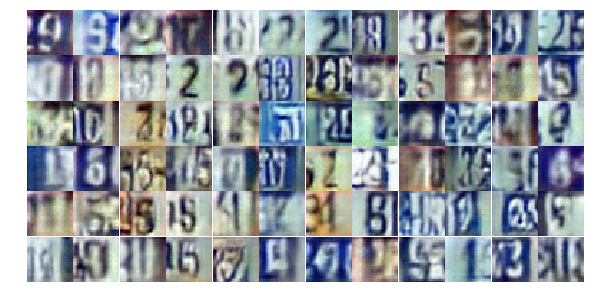

Epoch 9/25... Discriminator Loss: 1.0336... Generator Loss: 0.7336
Epoch 9/25... Discriminator Loss: 1.4448... Generator Loss: 0.4065
Epoch 9/25... Discriminator Loss: 1.8046... Generator Loss: 1.1064
Epoch 9/25... Discriminator Loss: 1.2893... Generator Loss: 0.4997
Epoch 9/25... Discriminator Loss: 0.7282... Generator Loss: 1.7707
Epoch 9/25... Discriminator Loss: 0.7571... Generator Loss: 1.5743
Epoch 9/25... Discriminator Loss: 1.5664... Generator Loss: 0.3750
Epoch 9/25... Discriminator Loss: 1.4137... Generator Loss: 0.4213
Epoch 9/25... Discriminator Loss: 1.6624... Generator Loss: 0.3281
Epoch 9/25... Discriminator Loss: 1.4892... Generator Loss: 0.3989


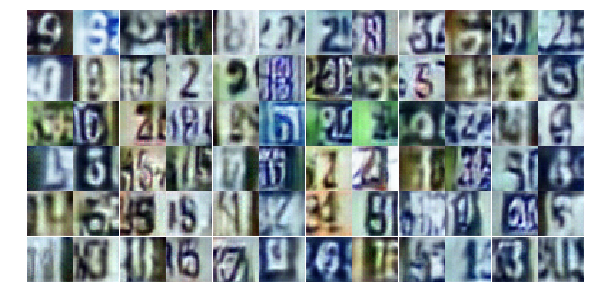

Epoch 9/25... Discriminator Loss: 0.9833... Generator Loss: 0.8959
Epoch 9/25... Discriminator Loss: 1.1734... Generator Loss: 0.5798
Epoch 9/25... Discriminator Loss: 0.5478... Generator Loss: 1.4553
Epoch 9/25... Discriminator Loss: 1.0884... Generator Loss: 0.5694
Epoch 9/25... Discriminator Loss: 1.0002... Generator Loss: 0.9647
Epoch 9/25... Discriminator Loss: 1.0644... Generator Loss: 0.9702
Epoch 9/25... Discriminator Loss: 1.0635... Generator Loss: 0.7305
Epoch 9/25... Discriminator Loss: 1.1314... Generator Loss: 0.6113
Epoch 9/25... Discriminator Loss: 1.0028... Generator Loss: 0.7937
Epoch 9/25... Discriminator Loss: 1.2183... Generator Loss: 2.4715


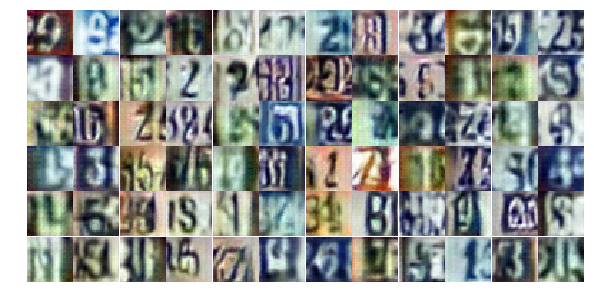

Epoch 9/25... Discriminator Loss: 1.4453... Generator Loss: 0.4132
Epoch 9/25... Discriminator Loss: 1.2398... Generator Loss: 0.5156
Epoch 9/25... Discriminator Loss: 1.5615... Generator Loss: 1.3922
Epoch 9/25... Discriminator Loss: 1.0673... Generator Loss: 0.9757
Epoch 9/25... Discriminator Loss: 0.6983... Generator Loss: 1.9643
Epoch 9/25... Discriminator Loss: 1.3190... Generator Loss: 0.4294
Epoch 9/25... Discriminator Loss: 1.3037... Generator Loss: 0.9090
Epoch 9/25... Discriminator Loss: 0.3875... Generator Loss: 1.9263
Epoch 9/25... Discriminator Loss: 1.5139... Generator Loss: 0.4072
Epoch 9/25... Discriminator Loss: 1.5927... Generator Loss: 0.3304


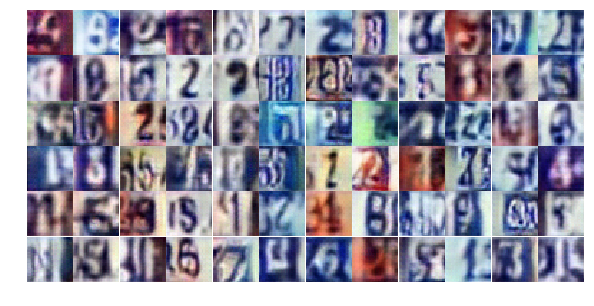

Epoch 9/25... Discriminator Loss: 1.2223... Generator Loss: 0.7830
Epoch 9/25... Discriminator Loss: 0.9965... Generator Loss: 0.8606
Epoch 9/25... Discriminator Loss: 0.9757... Generator Loss: 0.7519
Epoch 9/25... Discriminator Loss: 1.3426... Generator Loss: 0.8342
Epoch 9/25... Discriminator Loss: 1.0687... Generator Loss: 1.8011
Epoch 9/25... Discriminator Loss: 1.0095... Generator Loss: 0.8420
Epoch 9/25... Discriminator Loss: 0.7186... Generator Loss: 1.7018
Epoch 9/25... Discriminator Loss: 1.0372... Generator Loss: 0.9496
Epoch 9/25... Discriminator Loss: 0.9362... Generator Loss: 2.4188
Epoch 9/25... Discriminator Loss: 1.3628... Generator Loss: 0.5535


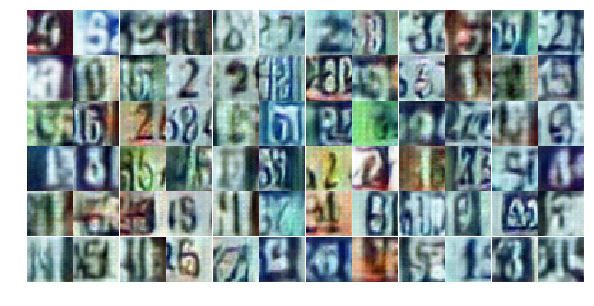

Epoch 9/25... Discriminator Loss: 0.8025... Generator Loss: 1.4650
Epoch 9/25... Discriminator Loss: 2.3481... Generator Loss: 0.3449
Epoch 9/25... Discriminator Loss: 1.1221... Generator Loss: 0.7044
Epoch 9/25... Discriminator Loss: 1.1999... Generator Loss: 0.5054
Epoch 9/25... Discriminator Loss: 0.8355... Generator Loss: 0.9558
Epoch 10/25... Discriminator Loss: 1.2155... Generator Loss: 0.6562
Epoch 10/25... Discriminator Loss: 0.9317... Generator Loss: 1.4303
Epoch 10/25... Discriminator Loss: 1.2223... Generator Loss: 0.6479
Epoch 10/25... Discriminator Loss: 0.8218... Generator Loss: 1.0357
Epoch 10/25... Discriminator Loss: 1.0966... Generator Loss: 0.6702


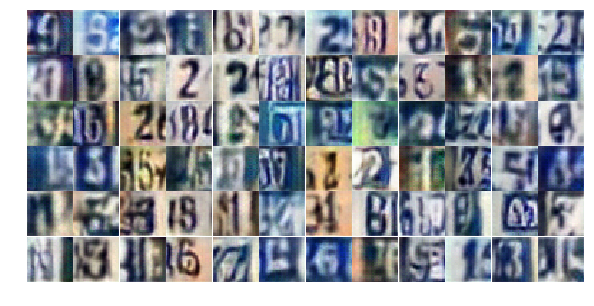

Epoch 10/25... Discriminator Loss: 1.2566... Generator Loss: 0.8935
Epoch 10/25... Discriminator Loss: 0.7320... Generator Loss: 1.2535
Epoch 10/25... Discriminator Loss: 0.6909... Generator Loss: 1.4418
Epoch 10/25... Discriminator Loss: 1.0957... Generator Loss: 0.8922
Epoch 10/25... Discriminator Loss: 1.0008... Generator Loss: 0.6666
Epoch 10/25... Discriminator Loss: 0.9796... Generator Loss: 1.4435
Epoch 10/25... Discriminator Loss: 1.0022... Generator Loss: 1.0618
Epoch 10/25... Discriminator Loss: 1.2395... Generator Loss: 0.5459
Epoch 10/25... Discriminator Loss: 1.5181... Generator Loss: 0.4447
Epoch 10/25... Discriminator Loss: 1.0148... Generator Loss: 1.3402


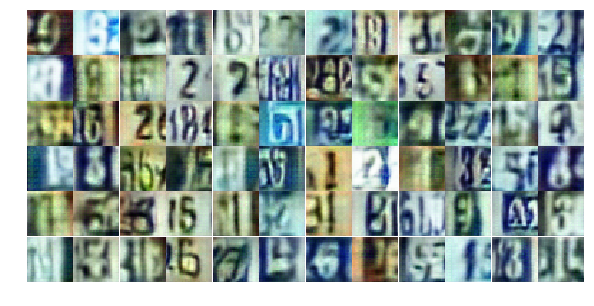

Epoch 10/25... Discriminator Loss: 0.8431... Generator Loss: 1.0765
Epoch 10/25... Discriminator Loss: 1.3935... Generator Loss: 0.4849
Epoch 10/25... Discriminator Loss: 0.8301... Generator Loss: 2.3811
Epoch 10/25... Discriminator Loss: 1.3298... Generator Loss: 0.4536
Epoch 10/25... Discriminator Loss: 0.9764... Generator Loss: 0.9286
Epoch 10/25... Discriminator Loss: 1.1292... Generator Loss: 0.6377
Epoch 10/25... Discriminator Loss: 1.8655... Generator Loss: 0.4745
Epoch 10/25... Discriminator Loss: 1.1544... Generator Loss: 0.9313
Epoch 10/25... Discriminator Loss: 0.7945... Generator Loss: 1.4030
Epoch 10/25... Discriminator Loss: 0.8913... Generator Loss: 1.8380


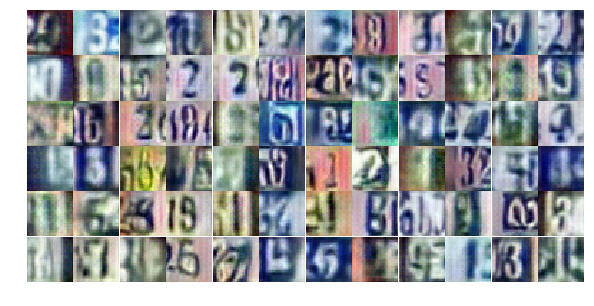

Epoch 10/25... Discriminator Loss: 0.5454... Generator Loss: 1.9471
Epoch 10/25... Discriminator Loss: 0.9251... Generator Loss: 0.8997
Epoch 10/25... Discriminator Loss: 0.7833... Generator Loss: 1.2224
Epoch 10/25... Discriminator Loss: 0.7744... Generator Loss: 1.5756
Epoch 10/25... Discriminator Loss: 1.7312... Generator Loss: 0.3350
Epoch 10/25... Discriminator Loss: 0.9164... Generator Loss: 0.9746
Epoch 10/25... Discriminator Loss: 0.6896... Generator Loss: 1.2516
Epoch 10/25... Discriminator Loss: 1.2604... Generator Loss: 1.4435
Epoch 10/25... Discriminator Loss: 0.8682... Generator Loss: 0.8471
Epoch 10/25... Discriminator Loss: 0.6711... Generator Loss: 1.2845


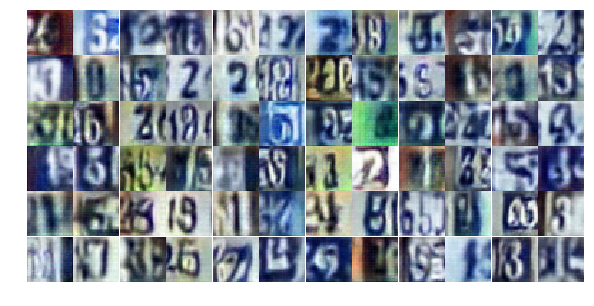

Epoch 10/25... Discriminator Loss: 1.0416... Generator Loss: 1.7477
Epoch 10/25... Discriminator Loss: 1.1167... Generator Loss: 0.6766
Epoch 10/25... Discriminator Loss: 1.2601... Generator Loss: 0.5838
Epoch 10/25... Discriminator Loss: 1.6078... Generator Loss: 1.4242
Epoch 10/25... Discriminator Loss: 0.9101... Generator Loss: 0.9789
Epoch 10/25... Discriminator Loss: 0.9472... Generator Loss: 0.8032
Epoch 10/25... Discriminator Loss: 0.6902... Generator Loss: 1.4906
Epoch 10/25... Discriminator Loss: 1.1703... Generator Loss: 0.6399
Epoch 10/25... Discriminator Loss: 0.6545... Generator Loss: 1.4456
Epoch 10/25... Discriminator Loss: 1.0744... Generator Loss: 1.1431


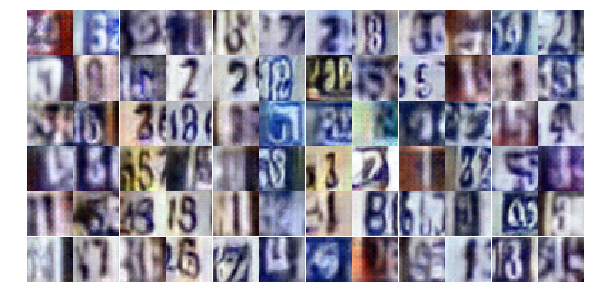

Epoch 10/25... Discriminator Loss: 1.1185... Generator Loss: 0.6120
Epoch 10/25... Discriminator Loss: 0.9208... Generator Loss: 0.7454
Epoch 10/25... Discriminator Loss: 1.5986... Generator Loss: 0.4508
Epoch 10/25... Discriminator Loss: 1.2554... Generator Loss: 0.5608
Epoch 10/25... Discriminator Loss: 1.2175... Generator Loss: 0.6667
Epoch 10/25... Discriminator Loss: 1.6630... Generator Loss: 0.3157
Epoch 10/25... Discriminator Loss: 0.6912... Generator Loss: 1.5020
Epoch 10/25... Discriminator Loss: 1.1575... Generator Loss: 0.6610
Epoch 10/25... Discriminator Loss: 0.9795... Generator Loss: 1.0584
Epoch 10/25... Discriminator Loss: 0.5738... Generator Loss: 1.7634


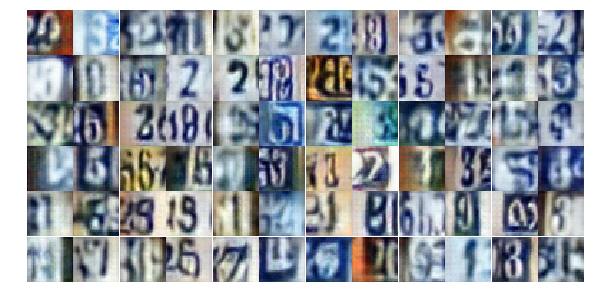

Epoch 10/25... Discriminator Loss: 1.1925... Generator Loss: 0.6186
Epoch 10/25... Discriminator Loss: 0.7498... Generator Loss: 1.0598
Epoch 10/25... Discriminator Loss: 1.3322... Generator Loss: 0.4501
Epoch 11/25... Discriminator Loss: 1.4257... Generator Loss: 0.4816
Epoch 11/25... Discriminator Loss: 1.3062... Generator Loss: 0.4573
Epoch 11/25... Discriminator Loss: 1.3040... Generator Loss: 0.5263
Epoch 11/25... Discriminator Loss: 0.9757... Generator Loss: 1.1784
Epoch 11/25... Discriminator Loss: 0.8811... Generator Loss: 1.0459
Epoch 11/25... Discriminator Loss: 0.9177... Generator Loss: 0.7538
Epoch 11/25... Discriminator Loss: 0.3678... Generator Loss: 1.9403


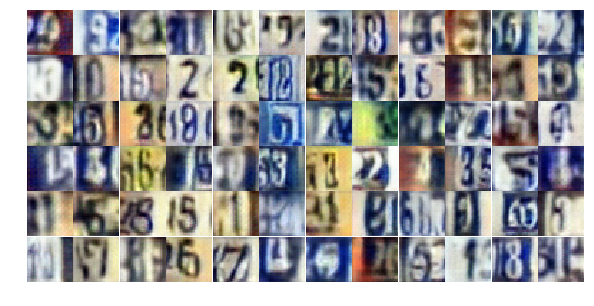

Epoch 11/25... Discriminator Loss: 0.8015... Generator Loss: 2.0516
Epoch 11/25... Discriminator Loss: 1.4063... Generator Loss: 1.5929
Epoch 11/25... Discriminator Loss: 1.1810... Generator Loss: 0.5798
Epoch 11/25... Discriminator Loss: 0.9182... Generator Loss: 1.8042
Epoch 11/25... Discriminator Loss: 1.1216... Generator Loss: 1.9622
Epoch 11/25... Discriminator Loss: 0.6176... Generator Loss: 1.1316
Epoch 11/25... Discriminator Loss: 1.2713... Generator Loss: 0.5483
Epoch 11/25... Discriminator Loss: 0.8404... Generator Loss: 2.4017
Epoch 11/25... Discriminator Loss: 1.1367... Generator Loss: 0.9330
Epoch 11/25... Discriminator Loss: 1.3757... Generator Loss: 0.4330


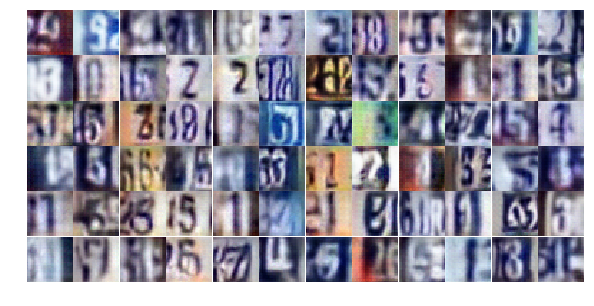

Epoch 11/25... Discriminator Loss: 1.2077... Generator Loss: 0.6013
Epoch 11/25... Discriminator Loss: 0.9541... Generator Loss: 2.1592
Epoch 11/25... Discriminator Loss: 1.7672... Generator Loss: 0.2859
Epoch 11/25... Discriminator Loss: 0.9478... Generator Loss: 0.7880
Epoch 11/25... Discriminator Loss: 0.6764... Generator Loss: 1.0459
Epoch 11/25... Discriminator Loss: 0.9110... Generator Loss: 2.6410
Epoch 11/25... Discriminator Loss: 0.6131... Generator Loss: 1.1408
Epoch 11/25... Discriminator Loss: 1.5365... Generator Loss: 0.3624
Epoch 11/25... Discriminator Loss: 0.5176... Generator Loss: 2.6341
Epoch 11/25... Discriminator Loss: 0.9317... Generator Loss: 0.7820


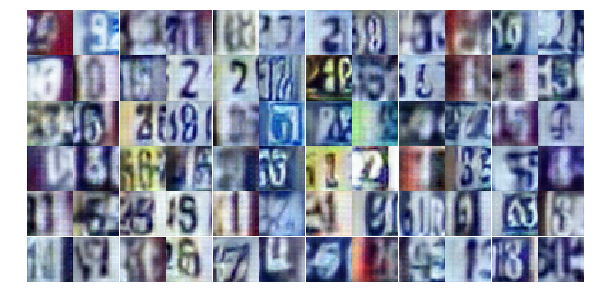

Epoch 11/25... Discriminator Loss: 1.2817... Generator Loss: 0.7992
Epoch 11/25... Discriminator Loss: 0.9883... Generator Loss: 0.7760
Epoch 11/25... Discriminator Loss: 0.9066... Generator Loss: 0.8880
Epoch 11/25... Discriminator Loss: 0.7482... Generator Loss: 0.8980
Epoch 11/25... Discriminator Loss: 0.9966... Generator Loss: 0.9122
Epoch 11/25... Discriminator Loss: 2.1988... Generator Loss: 0.1845
Epoch 11/25... Discriminator Loss: 1.5291... Generator Loss: 0.3778
Epoch 11/25... Discriminator Loss: 1.4362... Generator Loss: 0.4198
Epoch 11/25... Discriminator Loss: 1.1372... Generator Loss: 1.7515
Epoch 11/25... Discriminator Loss: 1.5788... Generator Loss: 0.5809


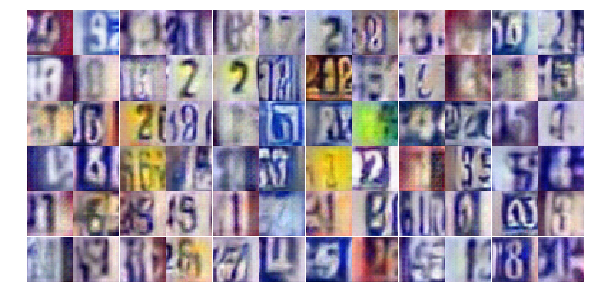

Epoch 11/25... Discriminator Loss: 1.2564... Generator Loss: 3.7445
Epoch 11/25... Discriminator Loss: 1.1178... Generator Loss: 0.7424
Epoch 11/25... Discriminator Loss: 0.9082... Generator Loss: 0.8420
Epoch 11/25... Discriminator Loss: 1.0607... Generator Loss: 0.7005
Epoch 11/25... Discriminator Loss: 1.6641... Generator Loss: 0.3280
Epoch 11/25... Discriminator Loss: 1.5005... Generator Loss: 0.3840
Epoch 11/25... Discriminator Loss: 0.7575... Generator Loss: 1.3607
Epoch 11/25... Discriminator Loss: 0.8331... Generator Loss: 0.8455
Epoch 11/25... Discriminator Loss: 1.3982... Generator Loss: 0.4602
Epoch 11/25... Discriminator Loss: 0.6499... Generator Loss: 1.9884


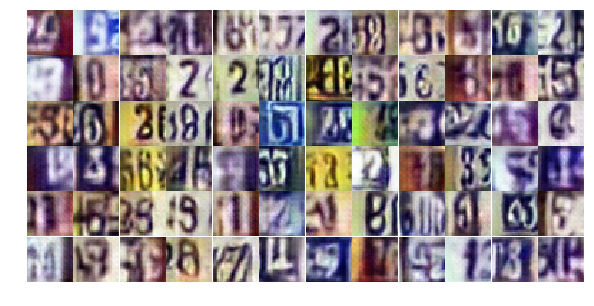

Epoch 11/25... Discriminator Loss: 0.7525... Generator Loss: 2.0935
Epoch 11/25... Discriminator Loss: 0.7724... Generator Loss: 1.0206
Epoch 11/25... Discriminator Loss: 1.2530... Generator Loss: 2.7399
Epoch 11/25... Discriminator Loss: 0.5352... Generator Loss: 1.6149
Epoch 11/25... Discriminator Loss: 1.9748... Generator Loss: 0.3157
Epoch 11/25... Discriminator Loss: 1.2493... Generator Loss: 0.7532
Epoch 11/25... Discriminator Loss: 1.1603... Generator Loss: 0.6505
Epoch 11/25... Discriminator Loss: 0.9216... Generator Loss: 0.9178
Epoch 11/25... Discriminator Loss: 1.9638... Generator Loss: 1.3880
Epoch 11/25... Discriminator Loss: 0.8431... Generator Loss: 2.0848


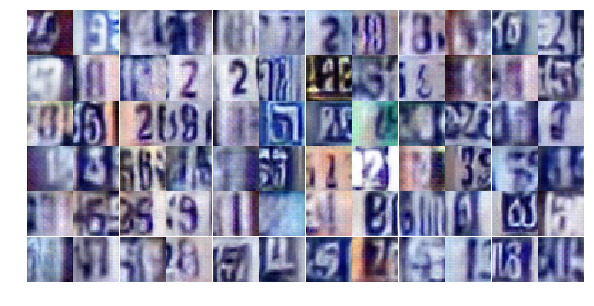

Epoch 12/25... Discriminator Loss: 1.4436... Generator Loss: 0.4113
Epoch 12/25... Discriminator Loss: 0.9169... Generator Loss: 1.5789
Epoch 12/25... Discriminator Loss: 1.7597... Generator Loss: 0.2966
Epoch 12/25... Discriminator Loss: 0.8672... Generator Loss: 1.1238
Epoch 12/25... Discriminator Loss: 0.4756... Generator Loss: 1.5695
Epoch 12/25... Discriminator Loss: 0.9043... Generator Loss: 0.9010
Epoch 12/25... Discriminator Loss: 1.0243... Generator Loss: 0.6941
Epoch 12/25... Discriminator Loss: 1.1457... Generator Loss: 0.6406
Epoch 12/25... Discriminator Loss: 0.9814... Generator Loss: 0.9962
Epoch 12/25... Discriminator Loss: 1.1762... Generator Loss: 0.8807


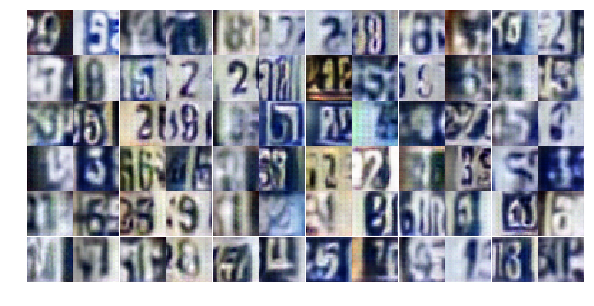

Epoch 12/25... Discriminator Loss: 0.9282... Generator Loss: 1.0880
Epoch 12/25... Discriminator Loss: 1.0270... Generator Loss: 0.7618
Epoch 12/25... Discriminator Loss: 0.4247... Generator Loss: 3.3071
Epoch 12/25... Discriminator Loss: 0.5422... Generator Loss: 1.6312
Epoch 12/25... Discriminator Loss: 1.0717... Generator Loss: 1.3559
Epoch 12/25... Discriminator Loss: 1.7316... Generator Loss: 0.3326
Epoch 12/25... Discriminator Loss: 2.5782... Generator Loss: 0.1841
Epoch 12/25... Discriminator Loss: 0.5317... Generator Loss: 1.4416
Epoch 12/25... Discriminator Loss: 0.6183... Generator Loss: 1.4668
Epoch 12/25... Discriminator Loss: 0.9509... Generator Loss: 1.1968


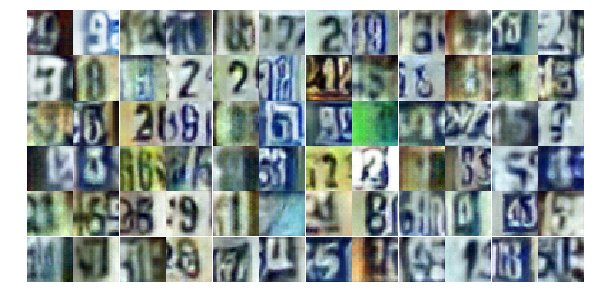

Epoch 12/25... Discriminator Loss: 1.0945... Generator Loss: 2.3609
Epoch 12/25... Discriminator Loss: 1.3734... Generator Loss: 0.5275
Epoch 12/25... Discriminator Loss: 0.9021... Generator Loss: 0.9788
Epoch 12/25... Discriminator Loss: 0.5095... Generator Loss: 1.4753
Epoch 12/25... Discriminator Loss: 1.3926... Generator Loss: 0.4648
Epoch 12/25... Discriminator Loss: 0.8764... Generator Loss: 0.7803
Epoch 12/25... Discriminator Loss: 1.1505... Generator Loss: 0.8948
Epoch 12/25... Discriminator Loss: 0.8228... Generator Loss: 1.3374
Epoch 12/25... Discriminator Loss: 0.7319... Generator Loss: 1.5450
Epoch 12/25... Discriminator Loss: 1.4023... Generator Loss: 0.4644


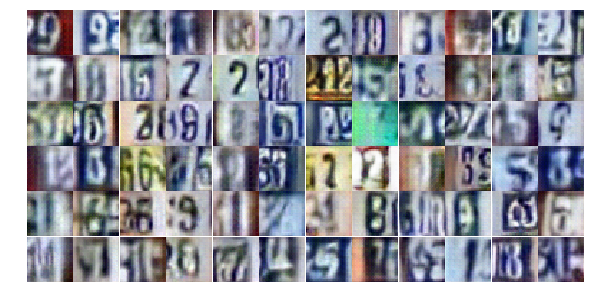

Epoch 12/25... Discriminator Loss: 1.5430... Generator Loss: 0.3788
Epoch 12/25... Discriminator Loss: 1.1896... Generator Loss: 0.5206
Epoch 12/25... Discriminator Loss: 0.5246... Generator Loss: 2.3049
Epoch 12/25... Discriminator Loss: 1.4184... Generator Loss: 0.4038
Epoch 12/25... Discriminator Loss: 1.3975... Generator Loss: 1.6207
Epoch 12/25... Discriminator Loss: 1.2290... Generator Loss: 0.6366
Epoch 12/25... Discriminator Loss: 1.8109... Generator Loss: 0.3142
Epoch 12/25... Discriminator Loss: 1.0965... Generator Loss: 0.7588
Epoch 12/25... Discriminator Loss: 1.0437... Generator Loss: 0.7487
Epoch 12/25... Discriminator Loss: 0.8708... Generator Loss: 1.5564


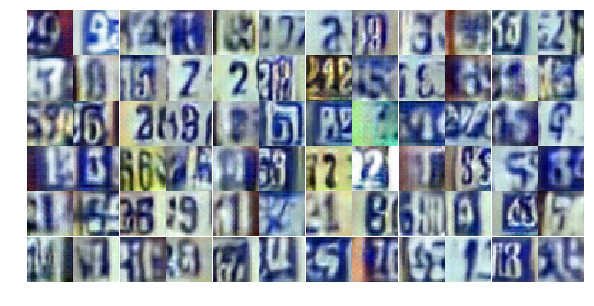

Epoch 12/25... Discriminator Loss: 1.0311... Generator Loss: 0.6867
Epoch 12/25... Discriminator Loss: 1.2021... Generator Loss: 0.8189
Epoch 12/25... Discriminator Loss: 0.3837... Generator Loss: 1.8304
Epoch 12/25... Discriminator Loss: 1.2879... Generator Loss: 0.4572
Epoch 12/25... Discriminator Loss: 1.2508... Generator Loss: 2.2383
Epoch 12/25... Discriminator Loss: 1.9237... Generator Loss: 0.4544
Epoch 12/25... Discriminator Loss: 1.2660... Generator Loss: 0.5187
Epoch 12/25... Discriminator Loss: 1.3930... Generator Loss: 0.5780
Epoch 12/25... Discriminator Loss: 1.1805... Generator Loss: 0.7490
Epoch 12/25... Discriminator Loss: 0.6441... Generator Loss: 1.0806


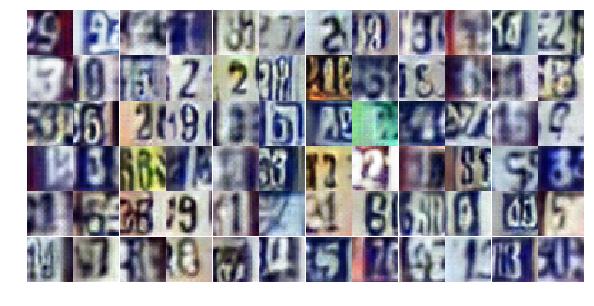

Epoch 12/25... Discriminator Loss: 0.3414... Generator Loss: 1.7845
Epoch 12/25... Discriminator Loss: 1.0709... Generator Loss: 1.3081
Epoch 12/25... Discriminator Loss: 1.1100... Generator Loss: 1.4519
Epoch 12/25... Discriminator Loss: 1.4143... Generator Loss: 0.5321
Epoch 12/25... Discriminator Loss: 1.1425... Generator Loss: 0.6586
Epoch 12/25... Discriminator Loss: 1.1358... Generator Loss: 0.7863
Epoch 12/25... Discriminator Loss: 1.4124... Generator Loss: 0.4724
Epoch 13/25... Discriminator Loss: 1.2956... Generator Loss: 0.4775
Epoch 13/25... Discriminator Loss: 0.6202... Generator Loss: 1.1122
Epoch 13/25... Discriminator Loss: 1.0553... Generator Loss: 0.7278


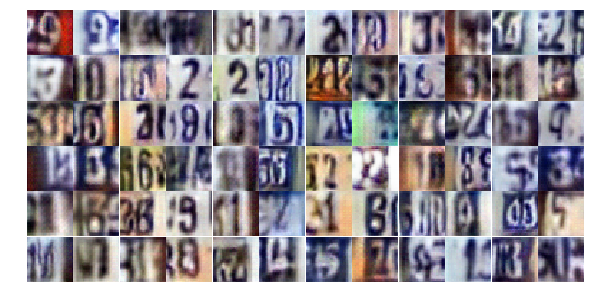

Epoch 13/25... Discriminator Loss: 0.6563... Generator Loss: 1.9186
Epoch 13/25... Discriminator Loss: 1.1539... Generator Loss: 3.5527
Epoch 13/25... Discriminator Loss: 1.3507... Generator Loss: 0.4628
Epoch 13/25... Discriminator Loss: 1.2674... Generator Loss: 0.6415
Epoch 13/25... Discriminator Loss: 1.0025... Generator Loss: 0.6647
Epoch 13/25... Discriminator Loss: 1.1274... Generator Loss: 0.6046
Epoch 13/25... Discriminator Loss: 1.0432... Generator Loss: 0.8460
Epoch 13/25... Discriminator Loss: 0.8926... Generator Loss: 0.9137
Epoch 13/25... Discriminator Loss: 0.5795... Generator Loss: 1.4526
Epoch 13/25... Discriminator Loss: 0.4203... Generator Loss: 1.5743


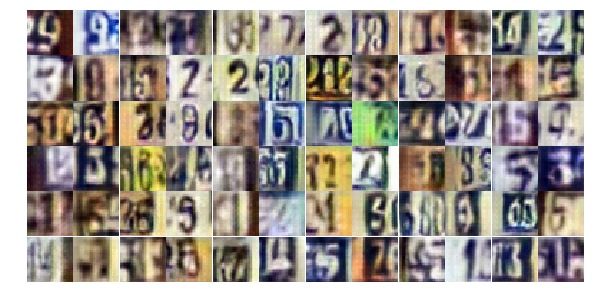

Epoch 13/25... Discriminator Loss: 0.8422... Generator Loss: 1.3040
Epoch 13/25... Discriminator Loss: 0.5231... Generator Loss: 1.2152
Epoch 13/25... Discriminator Loss: 1.4479... Generator Loss: 0.4112
Epoch 13/25... Discriminator Loss: 1.0051... Generator Loss: 0.8973
Epoch 13/25... Discriminator Loss: 0.7589... Generator Loss: 1.0396
Epoch 13/25... Discriminator Loss: 1.2237... Generator Loss: 0.7066
Epoch 13/25... Discriminator Loss: 1.4964... Generator Loss: 1.0747
Epoch 13/25... Discriminator Loss: 1.0086... Generator Loss: 0.7797
Epoch 13/25... Discriminator Loss: 0.6680... Generator Loss: 1.5994
Epoch 13/25... Discriminator Loss: 0.9196... Generator Loss: 0.7497


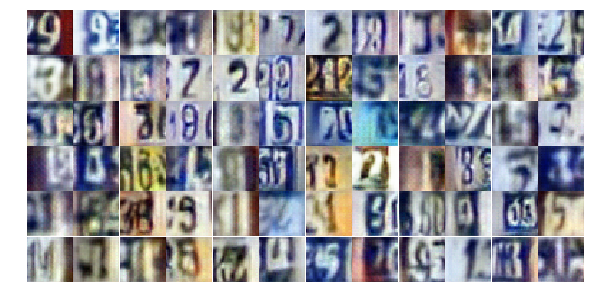

Epoch 13/25... Discriminator Loss: 1.4525... Generator Loss: 0.3780
Epoch 13/25... Discriminator Loss: 2.1332... Generator Loss: 2.0837
Epoch 13/25... Discriminator Loss: 0.9448... Generator Loss: 1.1072
Epoch 13/25... Discriminator Loss: 0.8332... Generator Loss: 0.9452
Epoch 13/25... Discriminator Loss: 1.1586... Generator Loss: 0.6200
Epoch 13/25... Discriminator Loss: 2.0737... Generator Loss: 0.2479
Epoch 13/25... Discriminator Loss: 0.8000... Generator Loss: 1.0635
Epoch 13/25... Discriminator Loss: 0.9271... Generator Loss: 1.1249
Epoch 13/25... Discriminator Loss: 1.1915... Generator Loss: 0.6224
Epoch 13/25... Discriminator Loss: 0.7730... Generator Loss: 0.8919


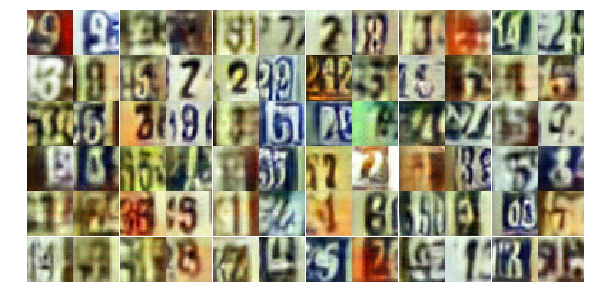

Epoch 13/25... Discriminator Loss: 1.1816... Generator Loss: 0.5783
Epoch 13/25... Discriminator Loss: 1.0886... Generator Loss: 1.2952
Epoch 13/25... Discriminator Loss: 0.7330... Generator Loss: 1.1509
Epoch 13/25... Discriminator Loss: 1.2422... Generator Loss: 0.5566
Epoch 13/25... Discriminator Loss: 1.0079... Generator Loss: 0.6845
Epoch 13/25... Discriminator Loss: 0.5103... Generator Loss: 1.6726
Epoch 13/25... Discriminator Loss: 0.8806... Generator Loss: 0.8073
Epoch 13/25... Discriminator Loss: 1.1386... Generator Loss: 1.6283
Epoch 13/25... Discriminator Loss: 1.2003... Generator Loss: 0.5478
Epoch 13/25... Discriminator Loss: 0.3233... Generator Loss: 1.8102


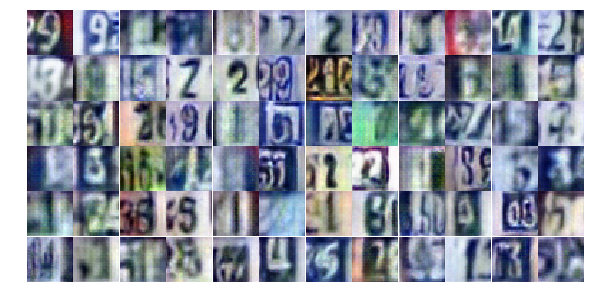

Epoch 13/25... Discriminator Loss: 0.6007... Generator Loss: 1.1659
Epoch 13/25... Discriminator Loss: 1.1899... Generator Loss: 0.6082
Epoch 13/25... Discriminator Loss: 1.5098... Generator Loss: 0.5520
Epoch 13/25... Discriminator Loss: 0.9316... Generator Loss: 1.0283
Epoch 13/25... Discriminator Loss: 0.8430... Generator Loss: 0.9279
Epoch 13/25... Discriminator Loss: 1.5140... Generator Loss: 0.4154
Epoch 13/25... Discriminator Loss: 1.4371... Generator Loss: 0.4187
Epoch 13/25... Discriminator Loss: 0.8824... Generator Loss: 2.3426
Epoch 13/25... Discriminator Loss: 0.9813... Generator Loss: 0.9381
Epoch 13/25... Discriminator Loss: 0.3230... Generator Loss: 1.7476


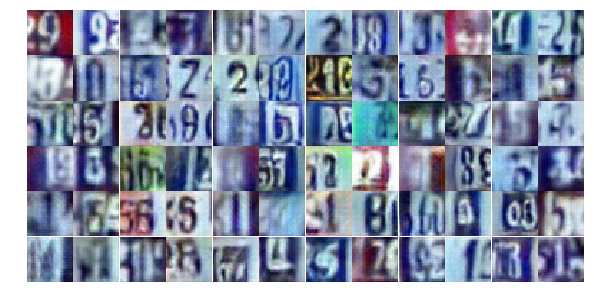

Epoch 13/25... Discriminator Loss: 0.5195... Generator Loss: 1.1696
Epoch 13/25... Discriminator Loss: 1.4380... Generator Loss: 0.4323
Epoch 13/25... Discriminator Loss: 2.2472... Generator Loss: 3.2805
Epoch 13/25... Discriminator Loss: 1.0446... Generator Loss: 0.8494
Epoch 14/25... Discriminator Loss: 0.9715... Generator Loss: 1.3608
Epoch 14/25... Discriminator Loss: 0.9128... Generator Loss: 1.0117
Epoch 14/25... Discriminator Loss: 1.4920... Generator Loss: 0.3642
Epoch 14/25... Discriminator Loss: 0.7062... Generator Loss: 1.5418
Epoch 14/25... Discriminator Loss: 1.1134... Generator Loss: 0.5970
Epoch 14/25... Discriminator Loss: 0.8896... Generator Loss: 1.0204


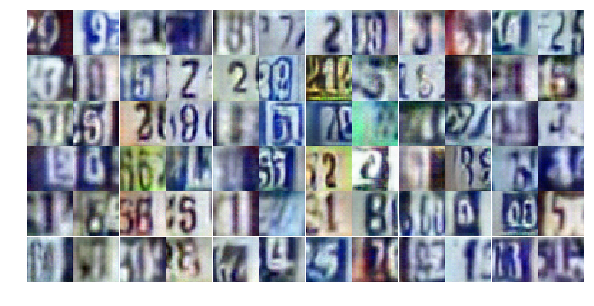

Epoch 14/25... Discriminator Loss: 1.0937... Generator Loss: 1.1789
Epoch 14/25... Discriminator Loss: 1.2979... Generator Loss: 0.5252
Epoch 14/25... Discriminator Loss: 1.0992... Generator Loss: 0.7627
Epoch 14/25... Discriminator Loss: 1.0786... Generator Loss: 0.6714
Epoch 14/25... Discriminator Loss: 1.6669... Generator Loss: 0.3899
Epoch 14/25... Discriminator Loss: 1.0859... Generator Loss: 0.7062
Epoch 14/25... Discriminator Loss: 0.3431... Generator Loss: 2.3790
Epoch 14/25... Discriminator Loss: 1.7767... Generator Loss: 0.2569
Epoch 14/25... Discriminator Loss: 1.2436... Generator Loss: 0.6196
Epoch 14/25... Discriminator Loss: 2.1332... Generator Loss: 0.2272


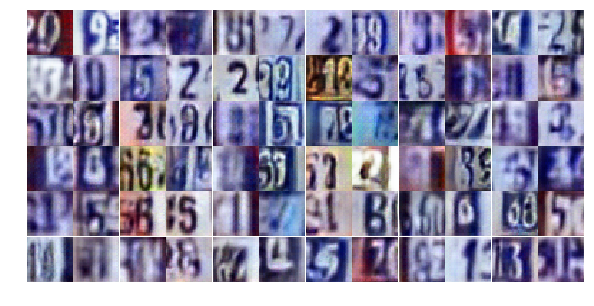

Epoch 14/25... Discriminator Loss: 1.2618... Generator Loss: 0.4828
Epoch 14/25... Discriminator Loss: 0.5389... Generator Loss: 1.9249
Epoch 14/25... Discriminator Loss: 1.1635... Generator Loss: 0.5938
Epoch 14/25... Discriminator Loss: 0.8116... Generator Loss: 1.0186
Epoch 14/25... Discriminator Loss: 1.0173... Generator Loss: 1.5207
Epoch 14/25... Discriminator Loss: 0.8984... Generator Loss: 0.9103
Epoch 14/25... Discriminator Loss: 1.0048... Generator Loss: 0.7007
Epoch 14/25... Discriminator Loss: 1.3183... Generator Loss: 0.5200
Epoch 14/25... Discriminator Loss: 0.9086... Generator Loss: 0.7975
Epoch 14/25... Discriminator Loss: 1.0719... Generator Loss: 0.6543


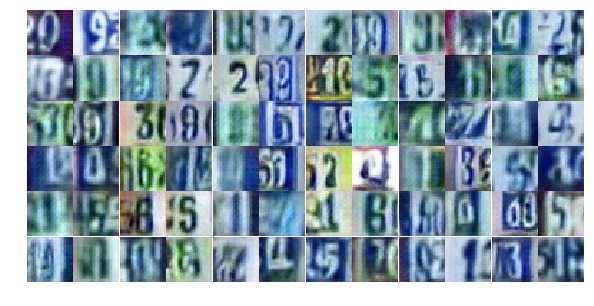

Epoch 14/25... Discriminator Loss: 1.8868... Generator Loss: 0.2579
Epoch 14/25... Discriminator Loss: 0.9983... Generator Loss: 1.6097
Epoch 14/25... Discriminator Loss: 0.7525... Generator Loss: 1.1846
Epoch 14/25... Discriminator Loss: 0.6543... Generator Loss: 1.3032
Epoch 14/25... Discriminator Loss: 0.9642... Generator Loss: 0.7856
Epoch 14/25... Discriminator Loss: 1.1817... Generator Loss: 0.6646
Epoch 14/25... Discriminator Loss: 0.8876... Generator Loss: 1.3269
Epoch 14/25... Discriminator Loss: 0.2795... Generator Loss: 4.2148
Epoch 14/25... Discriminator Loss: 0.8847... Generator Loss: 0.8896
Epoch 14/25... Discriminator Loss: 1.3685... Generator Loss: 0.9441


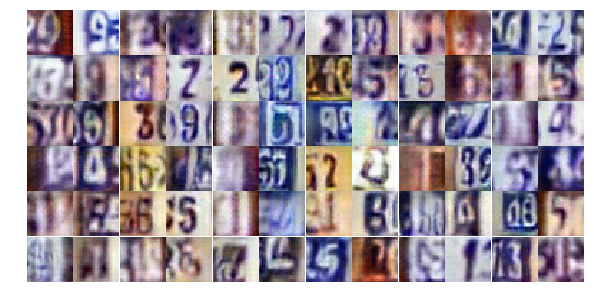

Epoch 14/25... Discriminator Loss: 1.4873... Generator Loss: 0.4872
Epoch 14/25... Discriminator Loss: 1.1942... Generator Loss: 1.1591
Epoch 14/25... Discriminator Loss: 1.0683... Generator Loss: 0.8744
Epoch 14/25... Discriminator Loss: 0.5699... Generator Loss: 1.3362
Epoch 14/25... Discriminator Loss: 1.4610... Generator Loss: 0.5551
Epoch 14/25... Discriminator Loss: 1.1770... Generator Loss: 1.1894
Epoch 14/25... Discriminator Loss: 0.9901... Generator Loss: 0.9452
Epoch 14/25... Discriminator Loss: 1.0521... Generator Loss: 0.7827
Epoch 14/25... Discriminator Loss: 1.4762... Generator Loss: 0.3860
Epoch 14/25... Discriminator Loss: 0.9005... Generator Loss: 2.1418


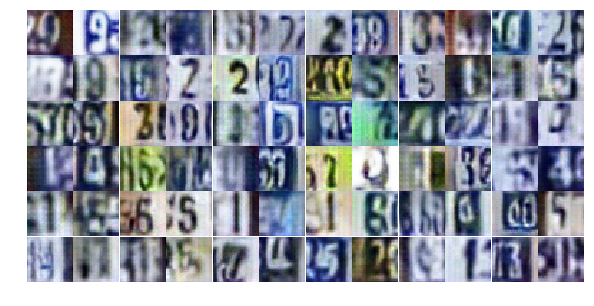

Epoch 14/25... Discriminator Loss: 1.8406... Generator Loss: 0.2951
Epoch 14/25... Discriminator Loss: 1.5152... Generator Loss: 0.4423
Epoch 14/25... Discriminator Loss: 0.9982... Generator Loss: 0.9336
Epoch 14/25... Discriminator Loss: 1.2479... Generator Loss: 0.4986
Epoch 14/25... Discriminator Loss: 1.1575... Generator Loss: 0.7852
Epoch 14/25... Discriminator Loss: 1.8069... Generator Loss: 0.2719
Epoch 14/25... Discriminator Loss: 0.5339... Generator Loss: 2.5566
Epoch 14/25... Discriminator Loss: 1.3728... Generator Loss: 0.5562
Epoch 14/25... Discriminator Loss: 1.0751... Generator Loss: 0.7310
Epoch 14/25... Discriminator Loss: 1.1426... Generator Loss: 0.8169


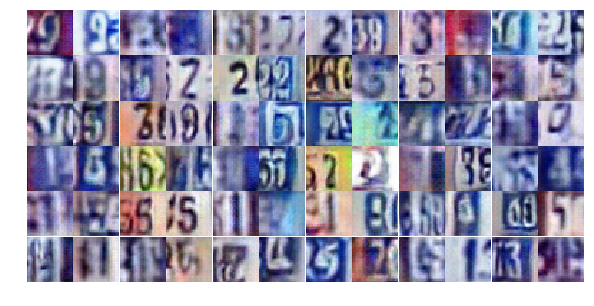

Epoch 14/25... Discriminator Loss: 1.1097... Generator Loss: 0.7175
Epoch 14/25... Discriminator Loss: 1.0591... Generator Loss: 0.9109
Epoch 15/25... Discriminator Loss: 1.0673... Generator Loss: 0.6777
Epoch 15/25... Discriminator Loss: 0.8440... Generator Loss: 0.8582
Epoch 15/25... Discriminator Loss: 0.7738... Generator Loss: 0.8962
Epoch 15/25... Discriminator Loss: 1.3111... Generator Loss: 0.6799
Epoch 15/25... Discriminator Loss: 1.6824... Generator Loss: 0.3447
Epoch 15/25... Discriminator Loss: 1.5032... Generator Loss: 0.4602
Epoch 15/25... Discriminator Loss: 1.4489... Generator Loss: 0.4589
Epoch 15/25... Discriminator Loss: 0.7137... Generator Loss: 1.0733


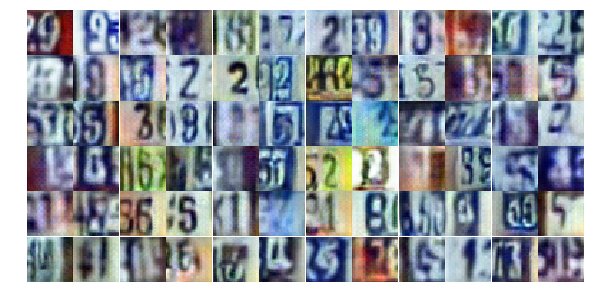

Epoch 15/25... Discriminator Loss: 0.7845... Generator Loss: 0.9523
Epoch 15/25... Discriminator Loss: 1.2547... Generator Loss: 3.0166
Epoch 15/25... Discriminator Loss: 1.2245... Generator Loss: 0.4674
Epoch 15/25... Discriminator Loss: 1.2616... Generator Loss: 0.5529
Epoch 15/25... Discriminator Loss: 1.3542... Generator Loss: 0.5299
Epoch 15/25... Discriminator Loss: 0.5597... Generator Loss: 1.4039
Epoch 15/25... Discriminator Loss: 1.7422... Generator Loss: 0.3084
Epoch 15/25... Discriminator Loss: 0.7865... Generator Loss: 0.9537
Epoch 15/25... Discriminator Loss: 0.5923... Generator Loss: 4.4061
Epoch 15/25... Discriminator Loss: 2.5898... Generator Loss: 0.1451


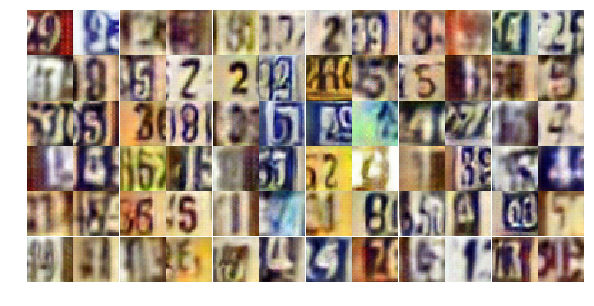

Epoch 15/25... Discriminator Loss: 1.9200... Generator Loss: 0.3398
Epoch 15/25... Discriminator Loss: 0.8292... Generator Loss: 1.0624
Epoch 15/25... Discriminator Loss: 0.6332... Generator Loss: 1.8121
Epoch 15/25... Discriminator Loss: 1.1922... Generator Loss: 0.5984
Epoch 15/25... Discriminator Loss: 1.4212... Generator Loss: 0.4146
Epoch 15/25... Discriminator Loss: 0.8800... Generator Loss: 0.9859
Epoch 15/25... Discriminator Loss: 1.4089... Generator Loss: 0.5713
Epoch 15/25... Discriminator Loss: 0.6619... Generator Loss: 1.1126
Epoch 15/25... Discriminator Loss: 0.1751... Generator Loss: 2.6034
Epoch 15/25... Discriminator Loss: 0.6611... Generator Loss: 1.2731


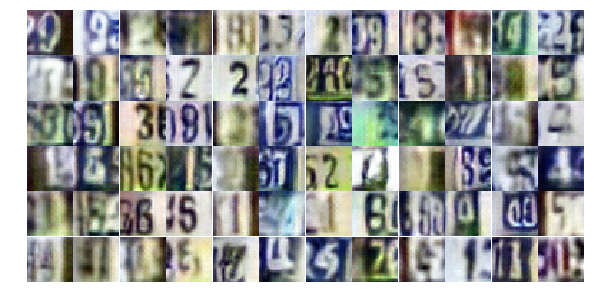

Epoch 15/25... Discriminator Loss: 0.4111... Generator Loss: 1.6230
Epoch 15/25... Discriminator Loss: 0.5050... Generator Loss: 3.3571
Epoch 15/25... Discriminator Loss: 0.7628... Generator Loss: 0.9224
Epoch 15/25... Discriminator Loss: 1.2138... Generator Loss: 1.4778
Epoch 15/25... Discriminator Loss: 0.3666... Generator Loss: 3.1963
Epoch 15/25... Discriminator Loss: 0.9663... Generator Loss: 1.0156
Epoch 15/25... Discriminator Loss: 1.1502... Generator Loss: 0.9465
Epoch 15/25... Discriminator Loss: 0.5667... Generator Loss: 1.5774
Epoch 15/25... Discriminator Loss: 0.8455... Generator Loss: 1.2131
Epoch 15/25... Discriminator Loss: 1.4200... Generator Loss: 0.5160


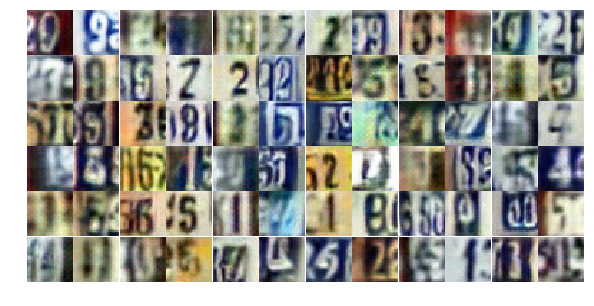

Epoch 15/25... Discriminator Loss: 0.7151... Generator Loss: 1.6043
Epoch 15/25... Discriminator Loss: 1.3182... Generator Loss: 0.5374
Epoch 15/25... Discriminator Loss: 0.3486... Generator Loss: 2.1759
Epoch 15/25... Discriminator Loss: 1.5467... Generator Loss: 0.3742
Epoch 15/25... Discriminator Loss: 0.7388... Generator Loss: 0.9551
Epoch 15/25... Discriminator Loss: 0.7970... Generator Loss: 1.1352
Epoch 15/25... Discriminator Loss: 0.4730... Generator Loss: 1.5800
Epoch 15/25... Discriminator Loss: 0.1714... Generator Loss: 2.8117
Epoch 15/25... Discriminator Loss: 1.9057... Generator Loss: 0.3802
Epoch 15/25... Discriminator Loss: 0.7839... Generator Loss: 1.4376


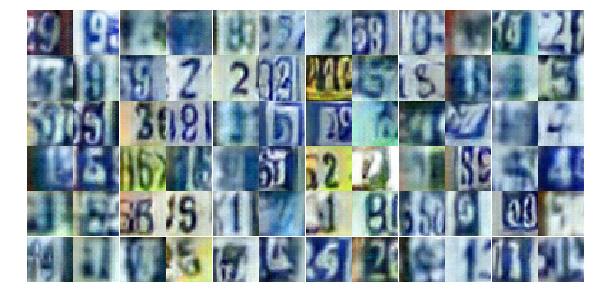

Epoch 15/25... Discriminator Loss: 1.8776... Generator Loss: 0.2574
Epoch 15/25... Discriminator Loss: 0.8809... Generator Loss: 1.0948
Epoch 15/25... Discriminator Loss: 0.7003... Generator Loss: 1.0381
Epoch 15/25... Discriminator Loss: 1.1861... Generator Loss: 0.6463
Epoch 15/25... Discriminator Loss: 1.3187... Generator Loss: 0.5147
Epoch 15/25... Discriminator Loss: 1.2189... Generator Loss: 3.6673
Epoch 15/25... Discriminator Loss: 1.3194... Generator Loss: 0.6213
Epoch 15/25... Discriminator Loss: 1.1716... Generator Loss: 1.1500
Epoch 15/25... Discriminator Loss: 1.6964... Generator Loss: 0.3746
Epoch 16/25... Discriminator Loss: 1.5496... Generator Loss: 0.4494


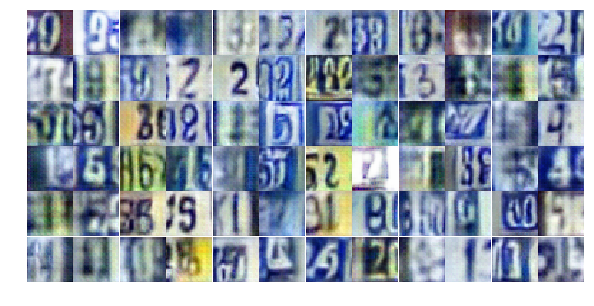

Epoch 16/25... Discriminator Loss: 0.8618... Generator Loss: 0.8214
Epoch 16/25... Discriminator Loss: 2.2533... Generator Loss: 0.1999
Epoch 16/25... Discriminator Loss: 1.1927... Generator Loss: 1.2589
Epoch 16/25... Discriminator Loss: 1.8011... Generator Loss: 2.4436
Epoch 16/25... Discriminator Loss: 1.0348... Generator Loss: 0.9594
Epoch 16/25... Discriminator Loss: 1.6085... Generator Loss: 0.3948
Epoch 16/25... Discriminator Loss: 1.8622... Generator Loss: 0.2847
Epoch 16/25... Discriminator Loss: 1.5581... Generator Loss: 0.4604
Epoch 16/25... Discriminator Loss: 1.1148... Generator Loss: 0.6469
Epoch 16/25... Discriminator Loss: 0.7992... Generator Loss: 1.2659


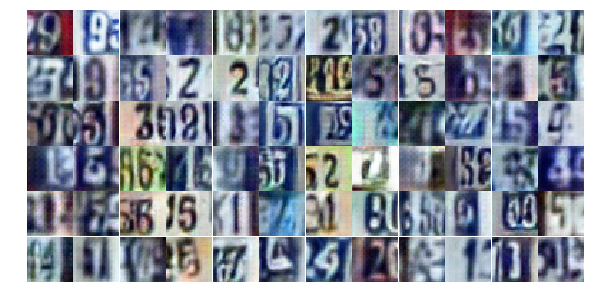

Epoch 16/25... Discriminator Loss: 1.9121... Generator Loss: 0.3059
Epoch 16/25... Discriminator Loss: 1.6494... Generator Loss: 0.3149
Epoch 16/25... Discriminator Loss: 1.0527... Generator Loss: 0.8280
Epoch 16/25... Discriminator Loss: 1.7210... Generator Loss: 0.3284
Epoch 16/25... Discriminator Loss: 1.0759... Generator Loss: 0.6853
Epoch 16/25... Discriminator Loss: 1.4638... Generator Loss: 0.4062
Epoch 16/25... Discriminator Loss: 1.2501... Generator Loss: 0.5856
Epoch 16/25... Discriminator Loss: 0.3523... Generator Loss: 1.7432
Epoch 16/25... Discriminator Loss: 0.8746... Generator Loss: 1.0756
Epoch 16/25... Discriminator Loss: 0.7107... Generator Loss: 1.3884


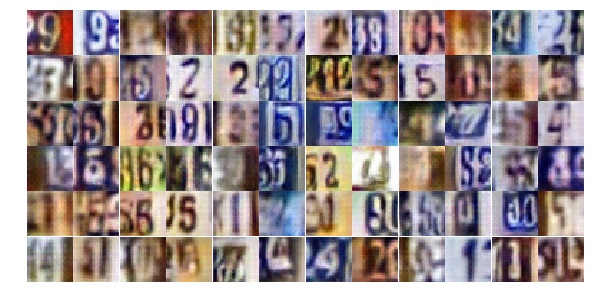

Epoch 16/25... Discriminator Loss: 0.4341... Generator Loss: 1.6425
Epoch 16/25... Discriminator Loss: 0.6437... Generator Loss: 1.1372
Epoch 16/25... Discriminator Loss: 1.2377... Generator Loss: 0.6752
Epoch 16/25... Discriminator Loss: 1.1726... Generator Loss: 0.6238
Epoch 16/25... Discriminator Loss: 0.8608... Generator Loss: 1.0322
Epoch 16/25... Discriminator Loss: 0.4745... Generator Loss: 1.3973
Epoch 16/25... Discriminator Loss: 1.0356... Generator Loss: 0.7263
Epoch 16/25... Discriminator Loss: 0.5012... Generator Loss: 1.3928
Epoch 16/25... Discriminator Loss: 0.8692... Generator Loss: 2.4334
Epoch 16/25... Discriminator Loss: 1.3083... Generator Loss: 0.5436


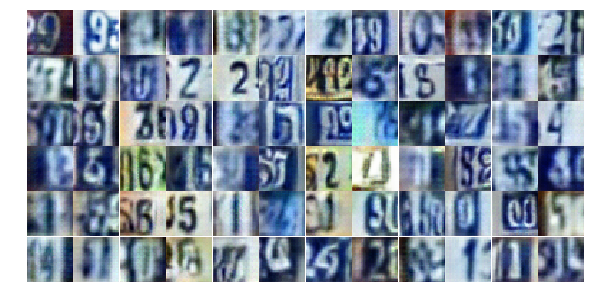

Epoch 16/25... Discriminator Loss: 0.9324... Generator Loss: 0.8584
Epoch 16/25... Discriminator Loss: 1.0333... Generator Loss: 0.9098
Epoch 16/25... Discriminator Loss: 0.8919... Generator Loss: 0.9954
Epoch 16/25... Discriminator Loss: 0.8763... Generator Loss: 1.0197
Epoch 16/25... Discriminator Loss: 1.5567... Generator Loss: 0.4152
Epoch 16/25... Discriminator Loss: 0.8291... Generator Loss: 0.9829
Epoch 16/25... Discriminator Loss: 1.3798... Generator Loss: 0.4964
Epoch 16/25... Discriminator Loss: 1.2429... Generator Loss: 0.5209
Epoch 16/25... Discriminator Loss: 1.3488... Generator Loss: 0.4685
Epoch 16/25... Discriminator Loss: 0.7853... Generator Loss: 1.4209


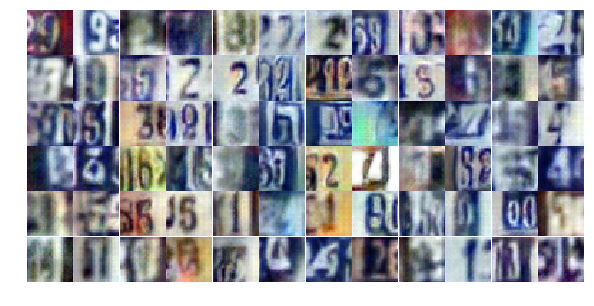

Epoch 16/25... Discriminator Loss: 0.7108... Generator Loss: 1.2525
Epoch 16/25... Discriminator Loss: 0.6104... Generator Loss: 1.2630
Epoch 16/25... Discriminator Loss: 1.7918... Generator Loss: 0.3935
Epoch 16/25... Discriminator Loss: 0.9829... Generator Loss: 0.7181
Epoch 16/25... Discriminator Loss: 1.1622... Generator Loss: 0.6415
Epoch 16/25... Discriminator Loss: 1.8370... Generator Loss: 0.3804
Epoch 16/25... Discriminator Loss: 0.8070... Generator Loss: 1.7788
Epoch 16/25... Discriminator Loss: 1.3780... Generator Loss: 1.8685
Epoch 16/25... Discriminator Loss: 0.8974... Generator Loss: 0.9825
Epoch 16/25... Discriminator Loss: 1.0198... Generator Loss: 0.7690


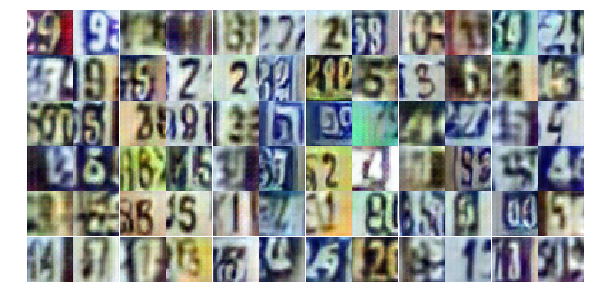

Epoch 16/25... Discriminator Loss: 1.4092... Generator Loss: 0.5650
Epoch 16/25... Discriminator Loss: 1.1912... Generator Loss: 0.6795
Epoch 16/25... Discriminator Loss: 1.3593... Generator Loss: 0.5156
Epoch 16/25... Discriminator Loss: 0.6010... Generator Loss: 1.1438
Epoch 16/25... Discriminator Loss: 0.6472... Generator Loss: 1.1931
Epoch 16/25... Discriminator Loss: 0.8860... Generator Loss: 0.8163
Epoch 17/25... Discriminator Loss: 0.7359... Generator Loss: 1.1157
Epoch 17/25... Discriminator Loss: 1.0907... Generator Loss: 0.8715
Epoch 17/25... Discriminator Loss: 0.9208... Generator Loss: 0.8722
Epoch 17/25... Discriminator Loss: 1.0525... Generator Loss: 1.4050


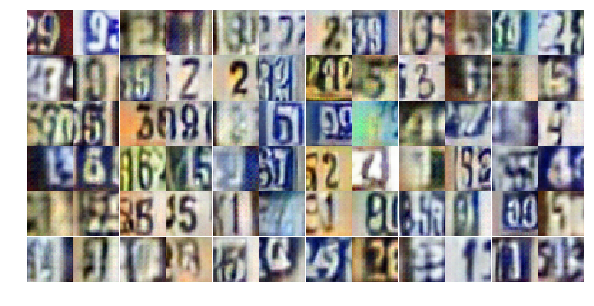

Epoch 17/25... Discriminator Loss: 1.0751... Generator Loss: 0.7188
Epoch 17/25... Discriminator Loss: 0.7093... Generator Loss: 1.0519
Epoch 17/25... Discriminator Loss: 0.7989... Generator Loss: 0.9252
Epoch 17/25... Discriminator Loss: 1.5995... Generator Loss: 0.3436
Epoch 17/25... Discriminator Loss: 1.1318... Generator Loss: 0.9133
Epoch 17/25... Discriminator Loss: 2.2019... Generator Loss: 0.1877
Epoch 17/25... Discriminator Loss: 1.4894... Generator Loss: 0.4634
Epoch 17/25... Discriminator Loss: 1.1739... Generator Loss: 0.5558
Epoch 17/25... Discriminator Loss: 0.9521... Generator Loss: 0.7718
Epoch 17/25... Discriminator Loss: 0.9774... Generator Loss: 3.9409


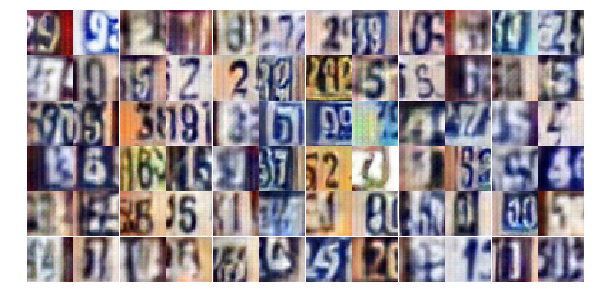

Epoch 17/25... Discriminator Loss: 0.7280... Generator Loss: 1.5809
Epoch 17/25... Discriminator Loss: 0.4703... Generator Loss: 1.9287
Epoch 17/25... Discriminator Loss: 0.4972... Generator Loss: 1.4042
Epoch 17/25... Discriminator Loss: 0.3229... Generator Loss: 1.8100
Epoch 17/25... Discriminator Loss: 0.2768... Generator Loss: 1.8837
Epoch 17/25... Discriminator Loss: 0.1885... Generator Loss: 2.2011
Epoch 17/25... Discriminator Loss: 0.2324... Generator Loss: 2.1199
Epoch 17/25... Discriminator Loss: 0.0662... Generator Loss: 3.4919
Epoch 17/25... Discriminator Loss: 1.1674... Generator Loss: 3.3399
Epoch 17/25... Discriminator Loss: 0.6914... Generator Loss: 1.9687


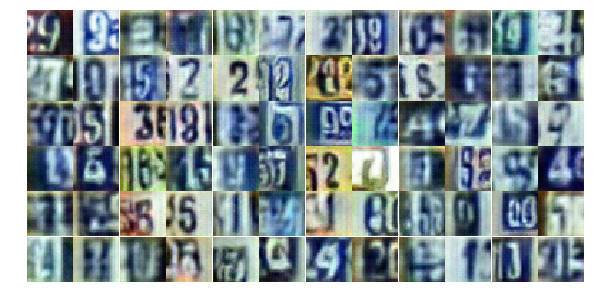

Epoch 17/25... Discriminator Loss: 1.6246... Generator Loss: 0.4235
Epoch 17/25... Discriminator Loss: 0.7079... Generator Loss: 1.1433
Epoch 17/25... Discriminator Loss: 0.7832... Generator Loss: 1.0731
Epoch 17/25... Discriminator Loss: 1.9526... Generator Loss: 0.3164
Epoch 17/25... Discriminator Loss: 1.8847... Generator Loss: 0.2979
Epoch 17/25... Discriminator Loss: 0.9592... Generator Loss: 0.8383
Epoch 17/25... Discriminator Loss: 1.2379... Generator Loss: 0.5993
Epoch 17/25... Discriminator Loss: 0.9972... Generator Loss: 0.8973
Epoch 17/25... Discriminator Loss: 1.3174... Generator Loss: 0.6105
Epoch 17/25... Discriminator Loss: 0.7854... Generator Loss: 1.0570


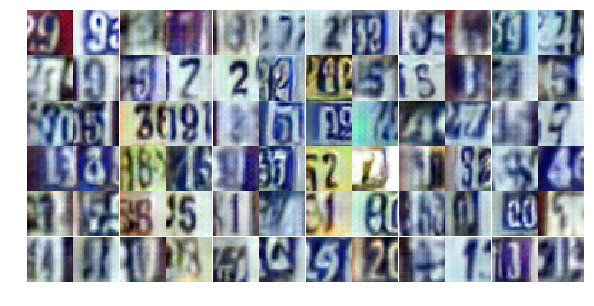

Epoch 17/25... Discriminator Loss: 1.0943... Generator Loss: 0.7287
Epoch 17/25... Discriminator Loss: 1.8730... Generator Loss: 0.3383
Epoch 17/25... Discriminator Loss: 1.0293... Generator Loss: 0.7357
Epoch 17/25... Discriminator Loss: 0.9050... Generator Loss: 1.0248
Epoch 17/25... Discriminator Loss: 1.2866... Generator Loss: 0.6204
Epoch 17/25... Discriminator Loss: 0.8357... Generator Loss: 1.0929
Epoch 17/25... Discriminator Loss: 1.2622... Generator Loss: 0.5761
Epoch 17/25... Discriminator Loss: 0.4275... Generator Loss: 2.0193
Epoch 17/25... Discriminator Loss: 0.3695... Generator Loss: 1.7671
Epoch 17/25... Discriminator Loss: 1.4293... Generator Loss: 0.4380


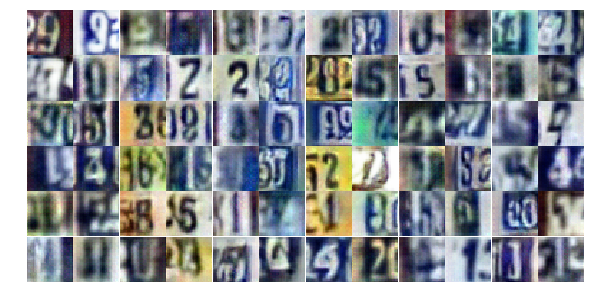

Epoch 17/25... Discriminator Loss: 0.6433... Generator Loss: 1.1312
Epoch 17/25... Discriminator Loss: 0.6244... Generator Loss: 2.3127
Epoch 17/25... Discriminator Loss: 1.4067... Generator Loss: 1.2276
Epoch 17/25... Discriminator Loss: 0.9975... Generator Loss: 2.8142
Epoch 17/25... Discriminator Loss: 0.7689... Generator Loss: 1.2254
Epoch 17/25... Discriminator Loss: 0.6010... Generator Loss: 1.1652
Epoch 17/25... Discriminator Loss: 0.6671... Generator Loss: 2.9179
Epoch 17/25... Discriminator Loss: 1.3918... Generator Loss: 0.4920
Epoch 17/25... Discriminator Loss: 0.7109... Generator Loss: 1.5079
Epoch 17/25... Discriminator Loss: 1.6958... Generator Loss: 0.3638


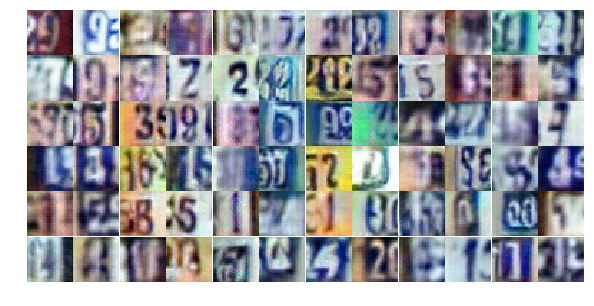

Epoch 17/25... Discriminator Loss: 1.4354... Generator Loss: 0.4518
Epoch 17/25... Discriminator Loss: 0.9307... Generator Loss: 1.1237
Epoch 17/25... Discriminator Loss: 0.6534... Generator Loss: 1.1824
Epoch 17/25... Discriminator Loss: 0.7821... Generator Loss: 1.2501
Epoch 18/25... Discriminator Loss: 0.8908... Generator Loss: 1.0049
Epoch 18/25... Discriminator Loss: 1.1138... Generator Loss: 0.8182
Epoch 18/25... Discriminator Loss: 1.6759... Generator Loss: 0.4473
Epoch 18/25... Discriminator Loss: 1.0024... Generator Loss: 0.7520
Epoch 18/25... Discriminator Loss: 1.1671... Generator Loss: 0.7167
Epoch 18/25... Discriminator Loss: 0.7245... Generator Loss: 1.1830


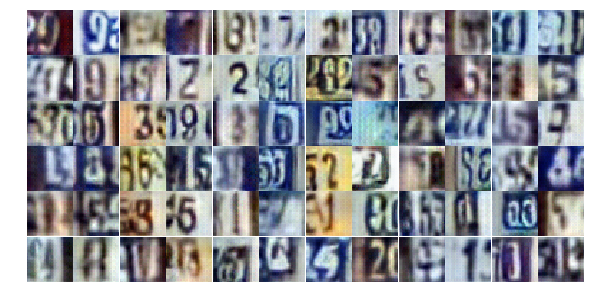

Epoch 18/25... Discriminator Loss: 0.5705... Generator Loss: 1.3996
Epoch 18/25... Discriminator Loss: 0.9795... Generator Loss: 1.0841
Epoch 18/25... Discriminator Loss: 0.8580... Generator Loss: 0.9871
Epoch 18/25... Discriminator Loss: 0.6177... Generator Loss: 1.3479
Epoch 18/25... Discriminator Loss: 1.6591... Generator Loss: 0.3356
Epoch 18/25... Discriminator Loss: 1.1455... Generator Loss: 0.7736
Epoch 18/25... Discriminator Loss: 1.1552... Generator Loss: 0.6242
Epoch 18/25... Discriminator Loss: 1.2940... Generator Loss: 0.5382
Epoch 18/25... Discriminator Loss: 0.5591... Generator Loss: 2.1706
Epoch 18/25... Discriminator Loss: 0.4523... Generator Loss: 1.6998


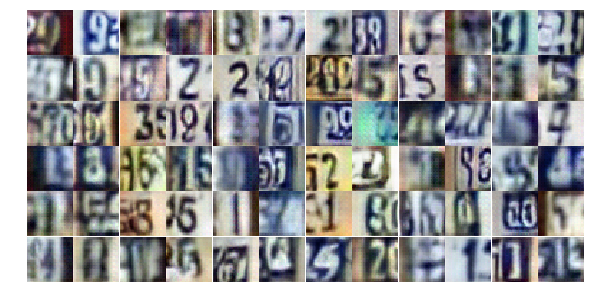

Epoch 18/25... Discriminator Loss: 0.2226... Generator Loss: 2.2830
Epoch 18/25... Discriminator Loss: 0.7294... Generator Loss: 1.0160
Epoch 18/25... Discriminator Loss: 1.3442... Generator Loss: 2.9973
Epoch 18/25... Discriminator Loss: 1.0930... Generator Loss: 0.7446
Epoch 18/25... Discriminator Loss: 1.4936... Generator Loss: 0.4903
Epoch 18/25... Discriminator Loss: 0.8450... Generator Loss: 1.2266
Epoch 18/25... Discriminator Loss: 0.9730... Generator Loss: 1.1286
Epoch 18/25... Discriminator Loss: 0.8552... Generator Loss: 0.9047
Epoch 18/25... Discriminator Loss: 0.7473... Generator Loss: 1.0644
Epoch 18/25... Discriminator Loss: 0.1879... Generator Loss: 2.3892


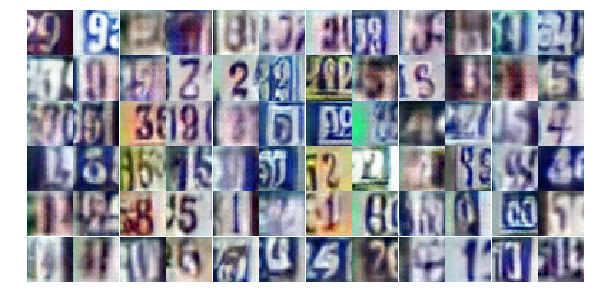

Epoch 18/25... Discriminator Loss: 0.6507... Generator Loss: 1.4072
Epoch 18/25... Discriminator Loss: 0.9829... Generator Loss: 1.1032
Epoch 18/25... Discriminator Loss: 1.1562... Generator Loss: 0.5715
Epoch 18/25... Discriminator Loss: 1.2462... Generator Loss: 0.4976
Epoch 18/25... Discriminator Loss: 1.7200... Generator Loss: 0.2965
Epoch 18/25... Discriminator Loss: 0.8334... Generator Loss: 0.8965
Epoch 18/25... Discriminator Loss: 0.6504... Generator Loss: 1.3579
Epoch 18/25... Discriminator Loss: 0.5025... Generator Loss: 2.0771
Epoch 18/25... Discriminator Loss: 1.8642... Generator Loss: 0.3485
Epoch 18/25... Discriminator Loss: 1.0104... Generator Loss: 0.8050


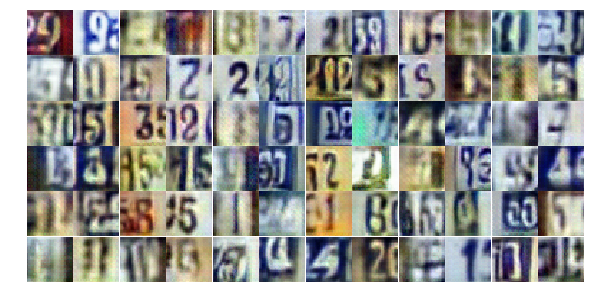

Epoch 18/25... Discriminator Loss: 1.7424... Generator Loss: 0.3234
Epoch 18/25... Discriminator Loss: 1.2168... Generator Loss: 1.2436
Epoch 18/25... Discriminator Loss: 0.7264... Generator Loss: 1.2716
Epoch 18/25... Discriminator Loss: 0.6725... Generator Loss: 1.3424
Epoch 18/25... Discriminator Loss: 1.0734... Generator Loss: 0.9753
Epoch 18/25... Discriminator Loss: 0.8592... Generator Loss: 0.8183
Epoch 18/25... Discriminator Loss: 1.6506... Generator Loss: 0.4497
Epoch 18/25... Discriminator Loss: 1.2459... Generator Loss: 2.4259
Epoch 18/25... Discriminator Loss: 0.8644... Generator Loss: 1.0249
Epoch 18/25... Discriminator Loss: 0.3894... Generator Loss: 1.9723


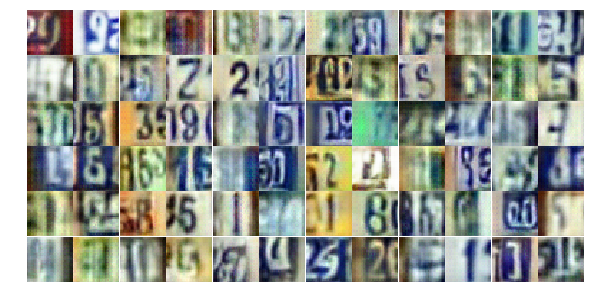

Epoch 18/25... Discriminator Loss: 0.6601... Generator Loss: 1.2469
Epoch 18/25... Discriminator Loss: 1.1740... Generator Loss: 0.6198
Epoch 18/25... Discriminator Loss: 1.3784... Generator Loss: 0.6018
Epoch 18/25... Discriminator Loss: 1.8483... Generator Loss: 0.2801
Epoch 18/25... Discriminator Loss: 0.7742... Generator Loss: 1.0307
Epoch 18/25... Discriminator Loss: 0.7522... Generator Loss: 1.1366
Epoch 18/25... Discriminator Loss: 0.1790... Generator Loss: 2.5218
Epoch 18/25... Discriminator Loss: 0.8232... Generator Loss: 1.0450
Epoch 18/25... Discriminator Loss: 1.9788... Generator Loss: 0.3575
Epoch 18/25... Discriminator Loss: 0.6113... Generator Loss: 1.1686


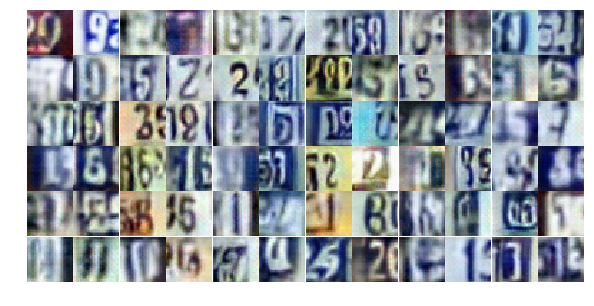

Epoch 18/25... Discriminator Loss: 0.7097... Generator Loss: 1.8436
Epoch 19/25... Discriminator Loss: 1.2136... Generator Loss: 0.6544
Epoch 19/25... Discriminator Loss: 1.6954... Generator Loss: 0.5110
Epoch 19/25... Discriminator Loss: 1.3360... Generator Loss: 0.5654
Epoch 19/25... Discriminator Loss: 0.8399... Generator Loss: 1.2624
Epoch 19/25... Discriminator Loss: 0.8731... Generator Loss: 1.0226
Epoch 19/25... Discriminator Loss: 0.7033... Generator Loss: 1.1838
Epoch 19/25... Discriminator Loss: 0.9418... Generator Loss: 0.8867
Epoch 19/25... Discriminator Loss: 2.9726... Generator Loss: 0.1177
Epoch 19/25... Discriminator Loss: 1.2809... Generator Loss: 2.2872


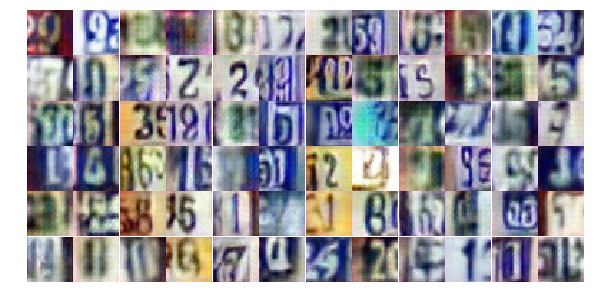

Epoch 19/25... Discriminator Loss: 1.5694... Generator Loss: 0.4451
Epoch 19/25... Discriminator Loss: 0.9119... Generator Loss: 0.9736
Epoch 19/25... Discriminator Loss: 1.4658... Generator Loss: 0.4601
Epoch 19/25... Discriminator Loss: 1.5184... Generator Loss: 0.4495
Epoch 19/25... Discriminator Loss: 0.7608... Generator Loss: 1.2484
Epoch 19/25... Discriminator Loss: 0.5492... Generator Loss: 1.5567
Epoch 19/25... Discriminator Loss: 1.5628... Generator Loss: 0.5299
Epoch 19/25... Discriminator Loss: 1.3820... Generator Loss: 0.5013
Epoch 19/25... Discriminator Loss: 1.3536... Generator Loss: 0.6918
Epoch 19/25... Discriminator Loss: 2.0419... Generator Loss: 0.2454


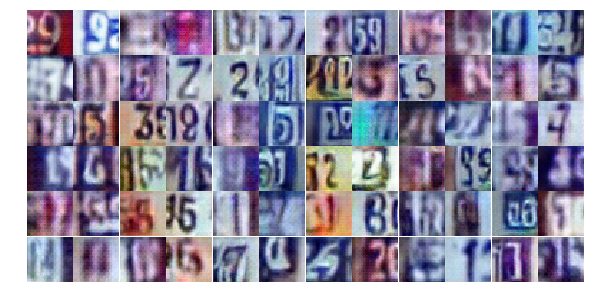

Epoch 19/25... Discriminator Loss: 0.9135... Generator Loss: 1.0953
Epoch 19/25... Discriminator Loss: 1.4656... Generator Loss: 0.5506
Epoch 19/25... Discriminator Loss: 1.5499... Generator Loss: 0.4902
Epoch 19/25... Discriminator Loss: 1.1118... Generator Loss: 0.6925
Epoch 19/25... Discriminator Loss: 1.2538... Generator Loss: 0.5622
Epoch 19/25... Discriminator Loss: 0.9709... Generator Loss: 1.1206
Epoch 19/25... Discriminator Loss: 1.1236... Generator Loss: 0.6328
Epoch 19/25... Discriminator Loss: 0.7477... Generator Loss: 1.0904
Epoch 19/25... Discriminator Loss: 0.7733... Generator Loss: 1.5032
Epoch 19/25... Discriminator Loss: 1.3005... Generator Loss: 0.6575


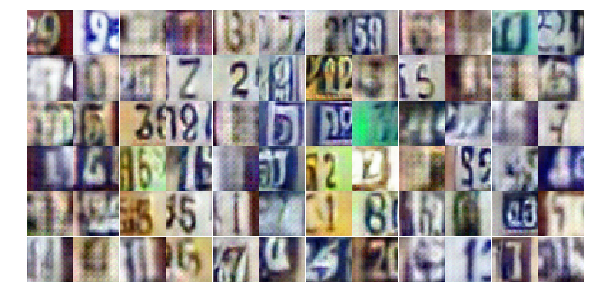

Epoch 19/25... Discriminator Loss: 1.4065... Generator Loss: 0.6219
Epoch 19/25... Discriminator Loss: 0.8255... Generator Loss: 1.0454
Epoch 19/25... Discriminator Loss: 1.5311... Generator Loss: 0.4249
Epoch 19/25... Discriminator Loss: 0.8617... Generator Loss: 0.9089
Epoch 19/25... Discriminator Loss: 0.9901... Generator Loss: 0.7861
Epoch 19/25... Discriminator Loss: 1.5116... Generator Loss: 0.4698
Epoch 19/25... Discriminator Loss: 0.8868... Generator Loss: 1.9373
Epoch 19/25... Discriminator Loss: 0.6986... Generator Loss: 1.2338
Epoch 19/25... Discriminator Loss: 0.6857... Generator Loss: 2.9578
Epoch 19/25... Discriminator Loss: 0.2473... Generator Loss: 2.2101


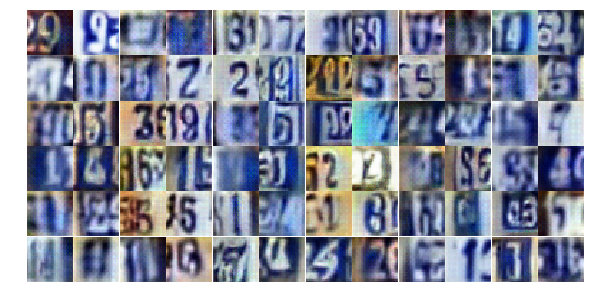

Epoch 19/25... Discriminator Loss: 0.5920... Generator Loss: 1.4805
Epoch 19/25... Discriminator Loss: 1.6340... Generator Loss: 0.4283
Epoch 19/25... Discriminator Loss: 0.9780... Generator Loss: 0.8959
Epoch 19/25... Discriminator Loss: 0.7996... Generator Loss: 1.0578
Epoch 19/25... Discriminator Loss: 1.0403... Generator Loss: 0.8140
Epoch 19/25... Discriminator Loss: 0.2977... Generator Loss: 2.9070
Epoch 19/25... Discriminator Loss: 0.1369... Generator Loss: 3.5886
Epoch 19/25... Discriminator Loss: 0.8587... Generator Loss: 0.9077
Epoch 19/25... Discriminator Loss: 0.9468... Generator Loss: 1.0108
Epoch 19/25... Discriminator Loss: 1.2638... Generator Loss: 0.6244


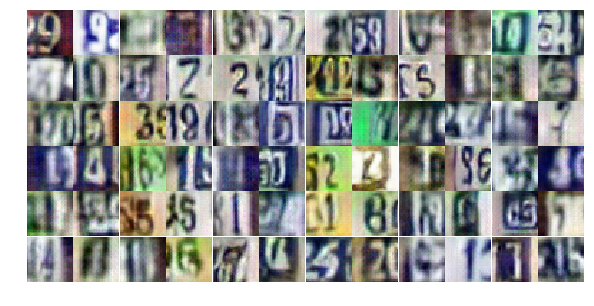

Epoch 19/25... Discriminator Loss: 1.6848... Generator Loss: 0.3548
Epoch 19/25... Discriminator Loss: 1.1490... Generator Loss: 0.8250
Epoch 19/25... Discriminator Loss: 0.4245... Generator Loss: 1.7960
Epoch 19/25... Discriminator Loss: 1.0453... Generator Loss: 0.7036
Epoch 19/25... Discriminator Loss: 1.0861... Generator Loss: 0.7251
Epoch 19/25... Discriminator Loss: 0.2221... Generator Loss: 2.9377
Epoch 19/25... Discriminator Loss: 0.6933... Generator Loss: 1.1297
Epoch 19/25... Discriminator Loss: 0.6627... Generator Loss: 1.3416
Epoch 20/25... Discriminator Loss: 1.4820... Generator Loss: 0.5323
Epoch 20/25... Discriminator Loss: 1.0261... Generator Loss: 0.8827


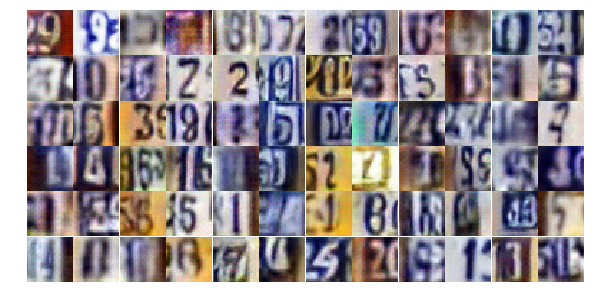

Epoch 20/25... Discriminator Loss: 0.6156... Generator Loss: 1.4350
Epoch 20/25... Discriminator Loss: 0.8598... Generator Loss: 1.0933
Epoch 20/25... Discriminator Loss: 2.6537... Generator Loss: 0.2057
Epoch 20/25... Discriminator Loss: 1.0885... Generator Loss: 1.2153
Epoch 20/25... Discriminator Loss: 0.6878... Generator Loss: 1.1566
Epoch 20/25... Discriminator Loss: 1.2712... Generator Loss: 0.5595
Epoch 20/25... Discriminator Loss: 0.6035... Generator Loss: 1.8891
Epoch 20/25... Discriminator Loss: 0.7051... Generator Loss: 1.4143
Epoch 20/25... Discriminator Loss: 0.9347... Generator Loss: 1.4291
Epoch 20/25... Discriminator Loss: 0.5862... Generator Loss: 1.3131


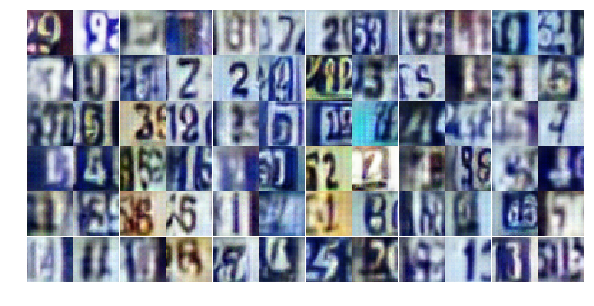

Epoch 20/25... Discriminator Loss: 2.0849... Generator Loss: 0.2144
Epoch 20/25... Discriminator Loss: 1.8839... Generator Loss: 0.2835
Epoch 20/25... Discriminator Loss: 1.1244... Generator Loss: 1.2896
Epoch 20/25... Discriminator Loss: 0.9766... Generator Loss: 0.9684
Epoch 20/25... Discriminator Loss: 1.2219... Generator Loss: 0.7056
Epoch 20/25... Discriminator Loss: 1.0882... Generator Loss: 0.8511
Epoch 20/25... Discriminator Loss: 0.9578... Generator Loss: 0.8052
Epoch 20/25... Discriminator Loss: 0.8107... Generator Loss: 0.8874
Epoch 20/25... Discriminator Loss: 1.1988... Generator Loss: 0.6507
Epoch 20/25... Discriminator Loss: 0.8263... Generator Loss: 2.0533


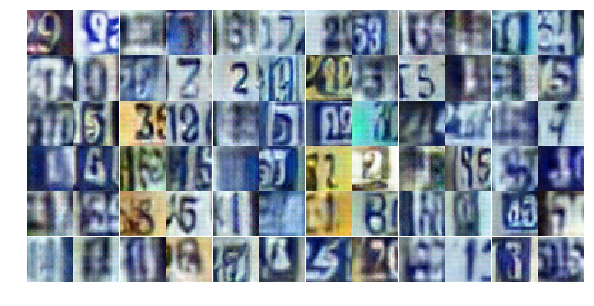

Epoch 20/25... Discriminator Loss: 0.0821... Generator Loss: 3.1674
Epoch 20/25... Discriminator Loss: 1.9258... Generator Loss: 0.4161
Epoch 20/25... Discriminator Loss: 0.8175... Generator Loss: 3.8673
Epoch 20/25... Discriminator Loss: 1.5616... Generator Loss: 0.4944
Epoch 20/25... Discriminator Loss: 1.8317... Generator Loss: 0.4274
Epoch 20/25... Discriminator Loss: 0.7236... Generator Loss: 1.3774
Epoch 20/25... Discriminator Loss: 1.7390... Generator Loss: 0.3501
Epoch 20/25... Discriminator Loss: 0.7127... Generator Loss: 1.4341
Epoch 20/25... Discriminator Loss: 0.2221... Generator Loss: 2.7230
Epoch 20/25... Discriminator Loss: 0.0975... Generator Loss: 3.4295


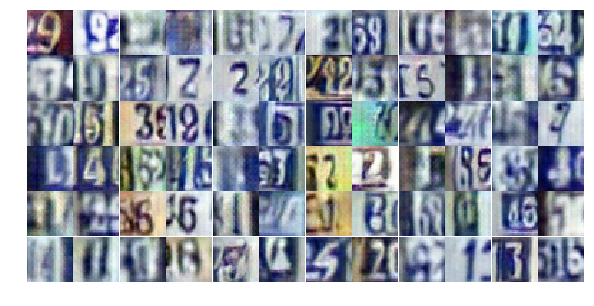

Epoch 20/25... Discriminator Loss: 1.4629... Generator Loss: 2.4385
Epoch 20/25... Discriminator Loss: 0.6831... Generator Loss: 1.2113
Epoch 20/25... Discriminator Loss: 0.7421... Generator Loss: 2.0002
Epoch 20/25... Discriminator Loss: 0.7606... Generator Loss: 1.3309
Epoch 20/25... Discriminator Loss: 0.9821... Generator Loss: 0.8861
Epoch 20/25... Discriminator Loss: 1.1632... Generator Loss: 0.7376
Epoch 20/25... Discriminator Loss: 0.3814... Generator Loss: 1.8238
Epoch 20/25... Discriminator Loss: 0.1573... Generator Loss: 2.8721
Epoch 20/25... Discriminator Loss: 0.4859... Generator Loss: 1.3398
Epoch 20/25... Discriminator Loss: 1.3171... Generator Loss: 2.5090


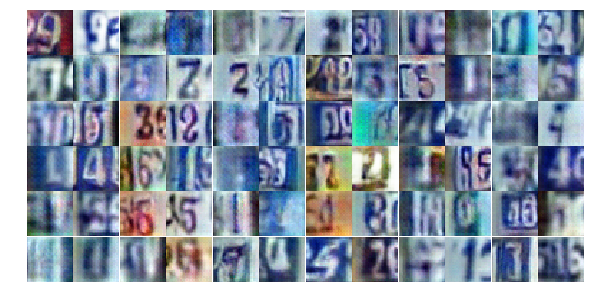

Epoch 20/25... Discriminator Loss: 1.2287... Generator Loss: 0.6937
Epoch 20/25... Discriminator Loss: 1.2184... Generator Loss: 0.6287
Epoch 20/25... Discriminator Loss: 1.0377... Generator Loss: 3.9488
Epoch 20/25... Discriminator Loss: 1.1044... Generator Loss: 0.8572
Epoch 20/25... Discriminator Loss: 1.1125... Generator Loss: 0.7958
Epoch 20/25... Discriminator Loss: 0.9312... Generator Loss: 0.8494
Epoch 20/25... Discriminator Loss: 1.5669... Generator Loss: 0.4779
Epoch 20/25... Discriminator Loss: 0.6555... Generator Loss: 1.4108
Epoch 20/25... Discriminator Loss: 0.4346... Generator Loss: 1.8579
Epoch 20/25... Discriminator Loss: 0.7131... Generator Loss: 2.9631


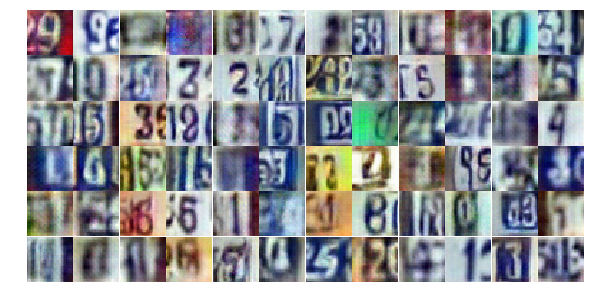

Epoch 20/25... Discriminator Loss: 0.4450... Generator Loss: 2.1471
Epoch 20/25... Discriminator Loss: 0.5216... Generator Loss: 2.3828
Epoch 20/25... Discriminator Loss: 0.7417... Generator Loss: 1.4910
Epoch 20/25... Discriminator Loss: 1.3291... Generator Loss: 0.6251
Epoch 20/25... Discriminator Loss: 0.7842... Generator Loss: 1.1183
Epoch 20/25... Discriminator Loss: 1.7010... Generator Loss: 0.4298
Epoch 21/25... Discriminator Loss: 1.8433... Generator Loss: 0.3747
Epoch 21/25... Discriminator Loss: 0.7495... Generator Loss: 1.5498
Epoch 21/25... Discriminator Loss: 0.1869... Generator Loss: 2.8699
Epoch 21/25... Discriminator Loss: 1.0852... Generator Loss: 0.6637


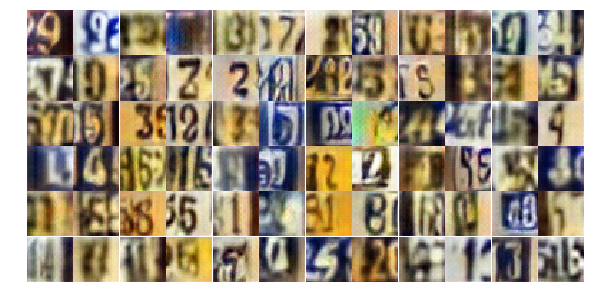

Epoch 21/25... Discriminator Loss: 0.3936... Generator Loss: 1.7713
Epoch 21/25... Discriminator Loss: 0.9031... Generator Loss: 0.8273
Epoch 21/25... Discriminator Loss: 0.0227... Generator Loss: 5.8511
Epoch 21/25... Discriminator Loss: 2.0499... Generator Loss: 0.2403
Epoch 21/25... Discriminator Loss: 0.6050... Generator Loss: 1.2029
Epoch 21/25... Discriminator Loss: 0.5601... Generator Loss: 1.3557
Epoch 21/25... Discriminator Loss: 0.4617... Generator Loss: 1.4957
Epoch 21/25... Discriminator Loss: 2.5573... Generator Loss: 0.2061
Epoch 21/25... Discriminator Loss: 1.2290... Generator Loss: 0.9876
Epoch 21/25... Discriminator Loss: 0.9663... Generator Loss: 0.9594


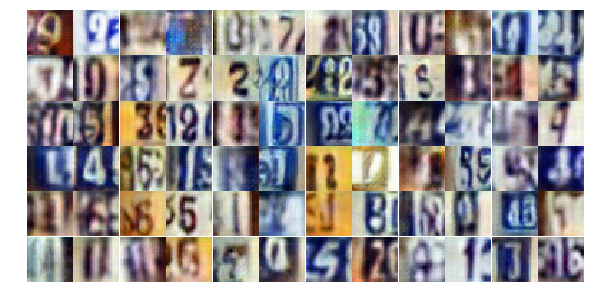

Epoch 21/25... Discriminator Loss: 0.4782... Generator Loss: 1.4495
Epoch 21/25... Discriminator Loss: 1.1995... Generator Loss: 0.6683
Epoch 21/25... Discriminator Loss: 2.2079... Generator Loss: 0.2876
Epoch 21/25... Discriminator Loss: 1.0179... Generator Loss: 0.7709
Epoch 21/25... Discriminator Loss: 0.6497... Generator Loss: 1.9811
Epoch 21/25... Discriminator Loss: 1.3791... Generator Loss: 0.7199
Epoch 21/25... Discriminator Loss: 1.0653... Generator Loss: 1.5400
Epoch 21/25... Discriminator Loss: 0.3634... Generator Loss: 2.1231
Epoch 21/25... Discriminator Loss: 0.8702... Generator Loss: 0.8743
Epoch 21/25... Discriminator Loss: 0.6272... Generator Loss: 1.4177


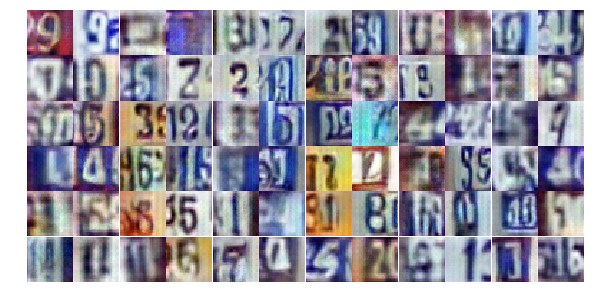

Epoch 21/25... Discriminator Loss: 1.4753... Generator Loss: 0.4895
Epoch 21/25... Discriminator Loss: 0.6866... Generator Loss: 1.2043
Epoch 21/25... Discriminator Loss: 1.0813... Generator Loss: 0.7096
Epoch 21/25... Discriminator Loss: 0.6393... Generator Loss: 1.4081
Epoch 21/25... Discriminator Loss: 1.2444... Generator Loss: 0.6072
Epoch 21/25... Discriminator Loss: 2.1531... Generator Loss: 0.3288
Epoch 21/25... Discriminator Loss: 0.8652... Generator Loss: 1.0023
Epoch 21/25... Discriminator Loss: 1.4264... Generator Loss: 0.5174
Epoch 21/25... Discriminator Loss: 0.9399... Generator Loss: 0.9242
Epoch 21/25... Discriminator Loss: 1.7420... Generator Loss: 0.4688


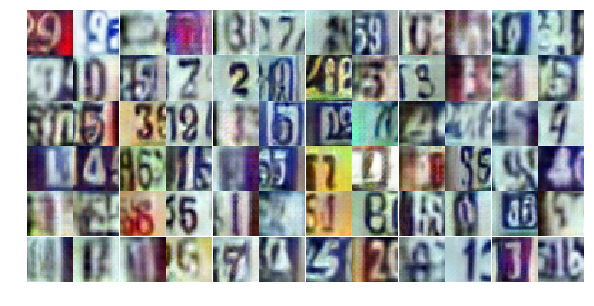

Epoch 21/25... Discriminator Loss: 1.2735... Generator Loss: 0.6164
Epoch 21/25... Discriminator Loss: 0.7976... Generator Loss: 1.0408
Epoch 21/25... Discriminator Loss: 2.3291... Generator Loss: 0.2136
Epoch 21/25... Discriminator Loss: 0.6910... Generator Loss: 1.1506
Epoch 21/25... Discriminator Loss: 0.6609... Generator Loss: 1.5489
Epoch 21/25... Discriminator Loss: 1.0719... Generator Loss: 0.7096
Epoch 21/25... Discriminator Loss: 1.0366... Generator Loss: 0.8231
Epoch 21/25... Discriminator Loss: 1.1769... Generator Loss: 0.5824
Epoch 21/25... Discriminator Loss: 0.2893... Generator Loss: 2.4618
Epoch 21/25... Discriminator Loss: 0.5758... Generator Loss: 2.4063


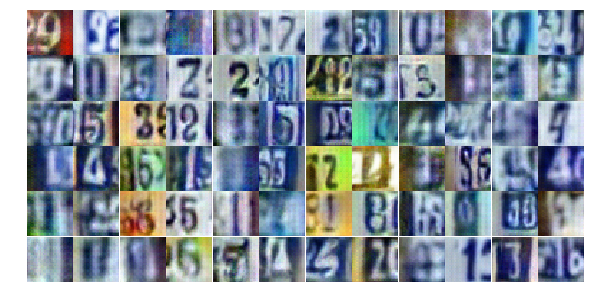

Epoch 21/25... Discriminator Loss: 1.3638... Generator Loss: 0.7068
Epoch 21/25... Discriminator Loss: 2.3997... Generator Loss: 0.2208
Epoch 21/25... Discriminator Loss: 0.6037... Generator Loss: 1.4156
Epoch 21/25... Discriminator Loss: 1.1213... Generator Loss: 0.6566
Epoch 21/25... Discriminator Loss: 0.5000... Generator Loss: 2.1233
Epoch 21/25... Discriminator Loss: 0.6333... Generator Loss: 1.3518
Epoch 21/25... Discriminator Loss: 0.3060... Generator Loss: 2.0493
Epoch 21/25... Discriminator Loss: 2.1121... Generator Loss: 0.4553
Epoch 21/25... Discriminator Loss: 1.1738... Generator Loss: 0.5870
Epoch 21/25... Discriminator Loss: 0.5704... Generator Loss: 1.4180


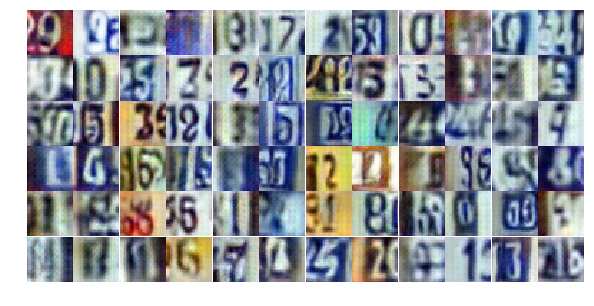

Epoch 21/25... Discriminator Loss: 0.7647... Generator Loss: 1.2093
Epoch 21/25... Discriminator Loss: 0.9788... Generator Loss: 0.8061
Epoch 21/25... Discriminator Loss: 0.9033... Generator Loss: 1.0265
Epoch 22/25... Discriminator Loss: 1.3307... Generator Loss: 0.5535
Epoch 22/25... Discriminator Loss: 1.1264... Generator Loss: 1.3774
Epoch 22/25... Discriminator Loss: 1.0304... Generator Loss: 2.4935
Epoch 22/25... Discriminator Loss: 1.0047... Generator Loss: 0.8713
Epoch 22/25... Discriminator Loss: 0.6498... Generator Loss: 1.1329
Epoch 22/25... Discriminator Loss: 1.7377... Generator Loss: 0.4014
Epoch 22/25... Discriminator Loss: 1.4016... Generator Loss: 0.4883


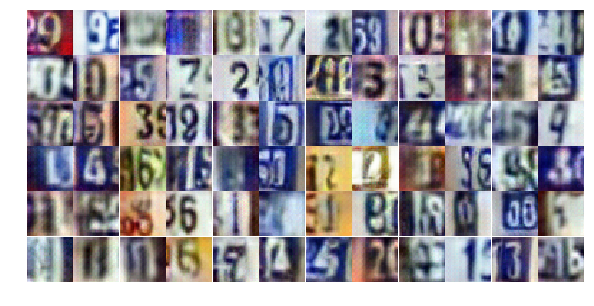

Epoch 22/25... Discriminator Loss: 0.6894... Generator Loss: 1.4257
Epoch 22/25... Discriminator Loss: 1.3496... Generator Loss: 0.7242
Epoch 22/25... Discriminator Loss: 1.5700... Generator Loss: 0.5040
Epoch 22/25... Discriminator Loss: 1.4781... Generator Loss: 0.4067
Epoch 22/25... Discriminator Loss: 1.1929... Generator Loss: 0.9503
Epoch 22/25... Discriminator Loss: 0.7375... Generator Loss: 1.0822
Epoch 22/25... Discriminator Loss: 0.7588... Generator Loss: 1.1055
Epoch 22/25... Discriminator Loss: 0.6369... Generator Loss: 1.3922
Epoch 22/25... Discriminator Loss: 0.8076... Generator Loss: 1.3147
Epoch 22/25... Discriminator Loss: 1.9668... Generator Loss: 0.4252


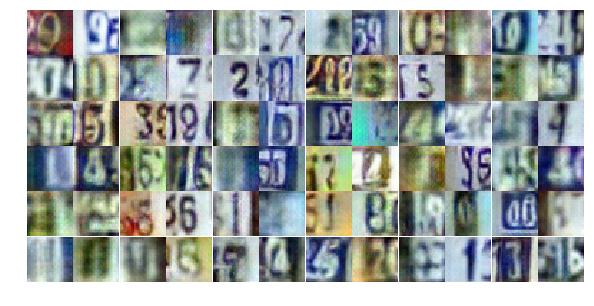

Epoch 22/25... Discriminator Loss: 1.1858... Generator Loss: 0.7498
Epoch 22/25... Discriminator Loss: 0.8116... Generator Loss: 1.0253
Epoch 22/25... Discriminator Loss: 1.7462... Generator Loss: 0.3378
Epoch 22/25... Discriminator Loss: 0.7529... Generator Loss: 1.0747
Epoch 22/25... Discriminator Loss: 0.5170... Generator Loss: 1.5733
Epoch 22/25... Discriminator Loss: 1.8369... Generator Loss: 0.4189
Epoch 22/25... Discriminator Loss: 0.2866... Generator Loss: 2.1738
Epoch 22/25... Discriminator Loss: 0.3160... Generator Loss: 1.8582
Epoch 22/25... Discriminator Loss: 1.5507... Generator Loss: 0.4904
Epoch 22/25... Discriminator Loss: 2.1770... Generator Loss: 0.2399


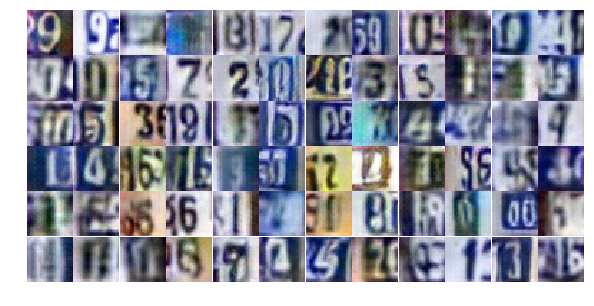

Epoch 22/25... Discriminator Loss: 0.3999... Generator Loss: 1.9098
Epoch 22/25... Discriminator Loss: 1.0141... Generator Loss: 1.0549
Epoch 22/25... Discriminator Loss: 0.7627... Generator Loss: 1.5239
Epoch 22/25... Discriminator Loss: 1.2592... Generator Loss: 0.7104
Epoch 22/25... Discriminator Loss: 0.8929... Generator Loss: 1.6204
Epoch 22/25... Discriminator Loss: 0.4909... Generator Loss: 1.5311
Epoch 22/25... Discriminator Loss: 1.3552... Generator Loss: 0.6176
Epoch 22/25... Discriminator Loss: 0.2720... Generator Loss: 2.0815
Epoch 22/25... Discriminator Loss: 1.2704... Generator Loss: 0.5538
Epoch 22/25... Discriminator Loss: 0.5206... Generator Loss: 1.2412


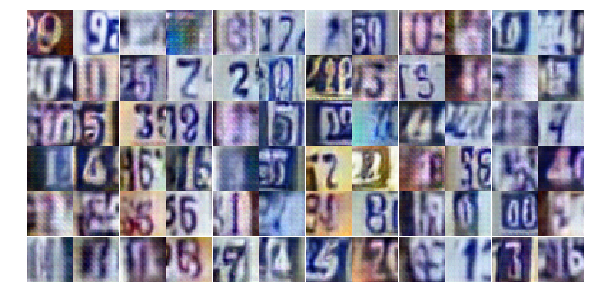

Epoch 22/25... Discriminator Loss: 0.3325... Generator Loss: 1.8574
Epoch 22/25... Discriminator Loss: 0.5068... Generator Loss: 2.5217
Epoch 22/25... Discriminator Loss: 0.3797... Generator Loss: 2.0041
Epoch 22/25... Discriminator Loss: 0.7318... Generator Loss: 1.0483
Epoch 22/25... Discriminator Loss: 0.5912... Generator Loss: 1.7252
Epoch 22/25... Discriminator Loss: 0.4459... Generator Loss: 1.5373
Epoch 22/25... Discriminator Loss: 0.8918... Generator Loss: 1.0449
Epoch 22/25... Discriminator Loss: 1.9657... Generator Loss: 2.2323
Epoch 22/25... Discriminator Loss: 1.0966... Generator Loss: 0.9729
Epoch 22/25... Discriminator Loss: 0.9646... Generator Loss: 0.9734


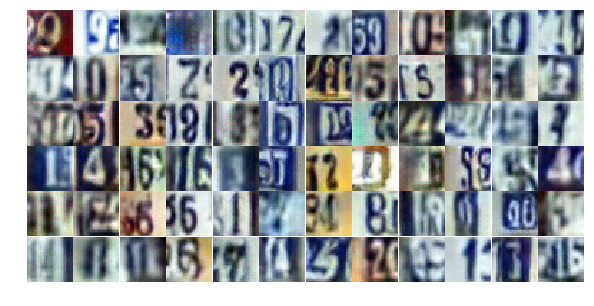

Epoch 22/25... Discriminator Loss: 0.3179... Generator Loss: 4.4749
Epoch 22/25... Discriminator Loss: 0.4649... Generator Loss: 1.5331
Epoch 22/25... Discriminator Loss: 0.4575... Generator Loss: 1.3940
Epoch 22/25... Discriminator Loss: 1.1508... Generator Loss: 0.8045
Epoch 22/25... Discriminator Loss: 1.1866... Generator Loss: 0.9745
Epoch 22/25... Discriminator Loss: 0.8766... Generator Loss: 0.9972
Epoch 22/25... Discriminator Loss: 2.1265... Generator Loss: 0.2674
Epoch 22/25... Discriminator Loss: 0.7469... Generator Loss: 1.2460
Epoch 22/25... Discriminator Loss: 1.0100... Generator Loss: 1.5527
Epoch 22/25... Discriminator Loss: 1.3292... Generator Loss: 0.6285


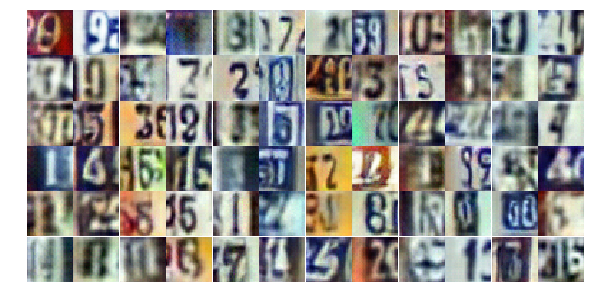

Epoch 23/25... Discriminator Loss: 0.9746... Generator Loss: 0.8169
Epoch 23/25... Discriminator Loss: 0.5065... Generator Loss: 1.6066
Epoch 23/25... Discriminator Loss: 1.3730... Generator Loss: 0.5778
Epoch 23/25... Discriminator Loss: 0.3676... Generator Loss: 2.1243
Epoch 23/25... Discriminator Loss: 0.6956... Generator Loss: 1.5017
Epoch 23/25... Discriminator Loss: 0.4483... Generator Loss: 1.5524
Epoch 23/25... Discriminator Loss: 2.2035... Generator Loss: 0.7396
Epoch 23/25... Discriminator Loss: 1.1829... Generator Loss: 1.0835
Epoch 23/25... Discriminator Loss: 1.3207... Generator Loss: 0.5582
Epoch 23/25... Discriminator Loss: 0.4761... Generator Loss: 1.9983


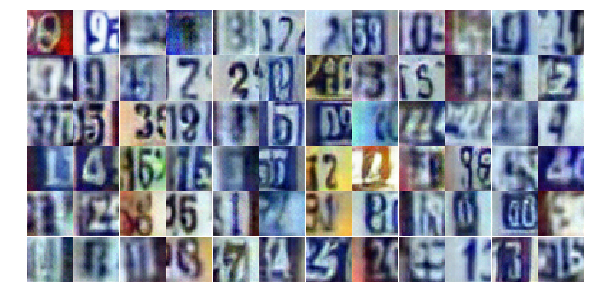

Epoch 23/25... Discriminator Loss: 0.6798... Generator Loss: 1.3913
Epoch 23/25... Discriminator Loss: 1.3291... Generator Loss: 0.6048
Epoch 23/25... Discriminator Loss: 1.4537... Generator Loss: 0.5734
Epoch 23/25... Discriminator Loss: 1.0482... Generator Loss: 0.8094
Epoch 23/25... Discriminator Loss: 0.4597... Generator Loss: 1.5641
Epoch 23/25... Discriminator Loss: 0.3520... Generator Loss: 2.0233
Epoch 23/25... Discriminator Loss: 1.3915... Generator Loss: 0.5897
Epoch 23/25... Discriminator Loss: 1.1111... Generator Loss: 0.6966
Epoch 23/25... Discriminator Loss: 0.6644... Generator Loss: 1.4772
Epoch 23/25... Discriminator Loss: 1.5198... Generator Loss: 0.4151


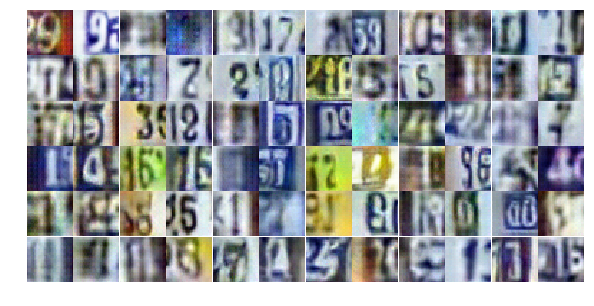

Epoch 23/25... Discriminator Loss: 1.4696... Generator Loss: 0.5697
Epoch 23/25... Discriminator Loss: 0.7925... Generator Loss: 1.1113
Epoch 23/25... Discriminator Loss: 0.1407... Generator Loss: 2.9494
Epoch 23/25... Discriminator Loss: 0.5054... Generator Loss: 1.5470
Epoch 23/25... Discriminator Loss: 0.0394... Generator Loss: 4.5562
Epoch 23/25... Discriminator Loss: 0.1424... Generator Loss: 2.7445
Epoch 23/25... Discriminator Loss: 0.7716... Generator Loss: 2.1617
Epoch 23/25... Discriminator Loss: 0.7101... Generator Loss: 1.5300
Epoch 23/25... Discriminator Loss: 0.7857... Generator Loss: 1.1037
Epoch 23/25... Discriminator Loss: 1.4634... Generator Loss: 0.6051


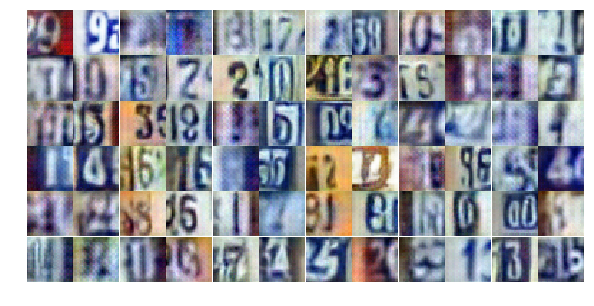

Epoch 23/25... Discriminator Loss: 0.7893... Generator Loss: 1.2846
Epoch 23/25... Discriminator Loss: 0.7799... Generator Loss: 1.1384
Epoch 23/25... Discriminator Loss: 0.5697... Generator Loss: 1.6858
Epoch 23/25... Discriminator Loss: 1.1265... Generator Loss: 0.6135
Epoch 23/25... Discriminator Loss: 1.0324... Generator Loss: 0.9845
Epoch 23/25... Discriminator Loss: 1.1209... Generator Loss: 0.7744
Epoch 23/25... Discriminator Loss: 1.3396... Generator Loss: 0.6031
Epoch 23/25... Discriminator Loss: 0.6004... Generator Loss: 1.3612
Epoch 23/25... Discriminator Loss: 0.7133... Generator Loss: 1.1597
Epoch 23/25... Discriminator Loss: 0.7259... Generator Loss: 1.0480


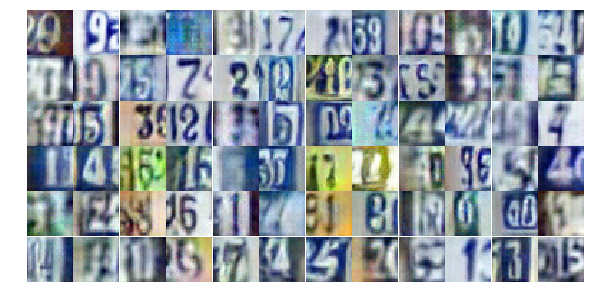

Epoch 23/25... Discriminator Loss: 1.1234... Generator Loss: 2.2064
Epoch 23/25... Discriminator Loss: 1.3499... Generator Loss: 0.5119
Epoch 23/25... Discriminator Loss: 1.2955... Generator Loss: 0.6387
Epoch 23/25... Discriminator Loss: 1.0909... Generator Loss: 0.7567
Epoch 23/25... Discriminator Loss: 0.7424... Generator Loss: 1.4625
Epoch 23/25... Discriminator Loss: 0.7787... Generator Loss: 1.1354
Epoch 23/25... Discriminator Loss: 0.0889... Generator Loss: 3.8566
Epoch 23/25... Discriminator Loss: 0.2423... Generator Loss: 2.2596
Epoch 23/25... Discriminator Loss: 0.9807... Generator Loss: 0.8513
Epoch 23/25... Discriminator Loss: 1.3824... Generator Loss: 3.5362


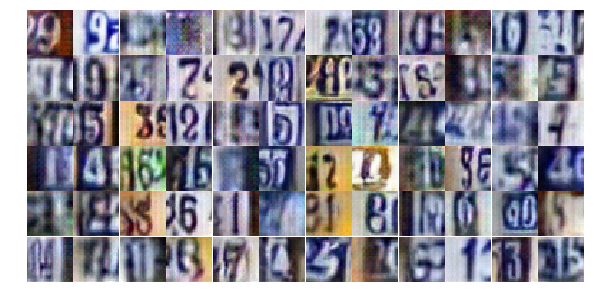

Epoch 23/25... Discriminator Loss: 1.8745... Generator Loss: 0.5880
Epoch 23/25... Discriminator Loss: 1.8200... Generator Loss: 0.5868
Epoch 23/25... Discriminator Loss: 1.4379... Generator Loss: 0.5464
Epoch 23/25... Discriminator Loss: 0.4153... Generator Loss: 2.1834
Epoch 23/25... Discriminator Loss: 1.2832... Generator Loss: 0.6365
Epoch 23/25... Discriminator Loss: 0.8137... Generator Loss: 1.1128
Epoch 23/25... Discriminator Loss: 1.0540... Generator Loss: 0.7752
Epoch 24/25... Discriminator Loss: 0.6955... Generator Loss: 1.1337
Epoch 24/25... Discriminator Loss: 1.0580... Generator Loss: 0.8312
Epoch 24/25... Discriminator Loss: 0.9872... Generator Loss: 1.9902


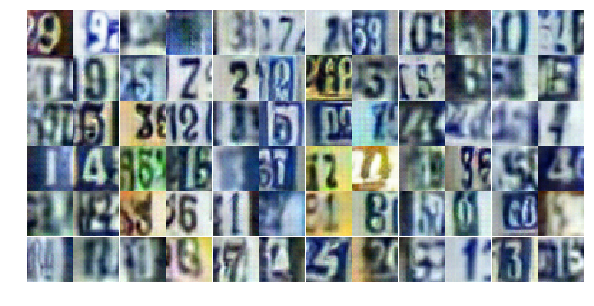

Epoch 24/25... Discriminator Loss: 0.7203... Generator Loss: 1.5062
Epoch 24/25... Discriminator Loss: 0.7601... Generator Loss: 1.3196
Epoch 24/25... Discriminator Loss: 0.7739... Generator Loss: 1.1659
Epoch 24/25... Discriminator Loss: 0.9385... Generator Loss: 1.2230
Epoch 24/25... Discriminator Loss: 1.1229... Generator Loss: 0.8453
Epoch 24/25... Discriminator Loss: 0.7543... Generator Loss: 1.1310
Epoch 24/25... Discriminator Loss: 0.9921... Generator Loss: 1.0526
Epoch 24/25... Discriminator Loss: 1.2628... Generator Loss: 0.5295
Epoch 24/25... Discriminator Loss: 0.7555... Generator Loss: 1.0857
Epoch 24/25... Discriminator Loss: 0.5946... Generator Loss: 1.3717


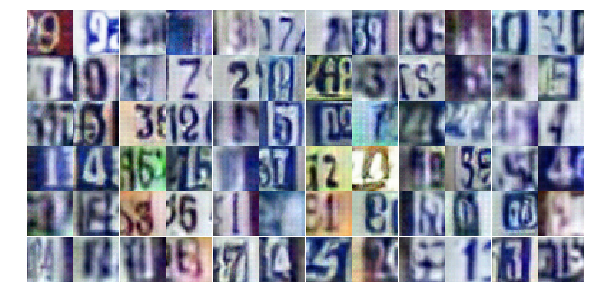

Epoch 24/25... Discriminator Loss: 0.9341... Generator Loss: 0.8327
Epoch 24/25... Discriminator Loss: 0.5609... Generator Loss: 2.6591
Epoch 24/25... Discriminator Loss: 2.5122... Generator Loss: 1.0196
Epoch 24/25... Discriminator Loss: 1.2823... Generator Loss: 0.8402
Epoch 24/25... Discriminator Loss: 1.9226... Generator Loss: 0.4347
Epoch 24/25... Discriminator Loss: 0.9933... Generator Loss: 0.9419
Epoch 24/25... Discriminator Loss: 0.9214... Generator Loss: 1.0045
Epoch 24/25... Discriminator Loss: 1.8390... Generator Loss: 0.2969
Epoch 24/25... Discriminator Loss: 1.2891... Generator Loss: 0.7069
Epoch 24/25... Discriminator Loss: 1.4760... Generator Loss: 0.5486


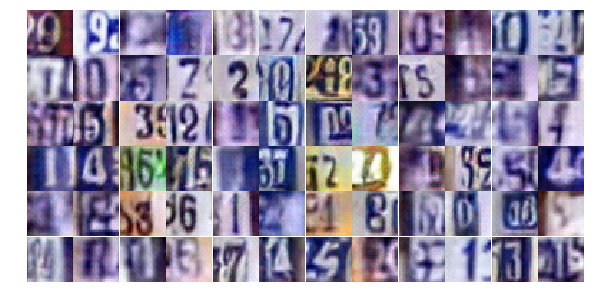

Epoch 24/25... Discriminator Loss: 1.1131... Generator Loss: 0.7001
Epoch 24/25... Discriminator Loss: 0.7743... Generator Loss: 1.1768
Epoch 24/25... Discriminator Loss: 0.4983... Generator Loss: 2.6466
Epoch 24/25... Discriminator Loss: 1.6071... Generator Loss: 0.4158
Epoch 24/25... Discriminator Loss: 1.0593... Generator Loss: 0.7682
Epoch 24/25... Discriminator Loss: 0.3591... Generator Loss: 2.1058
Epoch 24/25... Discriminator Loss: 0.5271... Generator Loss: 2.1101
Epoch 24/25... Discriminator Loss: 0.8697... Generator Loss: 3.4914
Epoch 24/25... Discriminator Loss: 0.6035... Generator Loss: 1.4970
Epoch 24/25... Discriminator Loss: 0.8242... Generator Loss: 1.2174


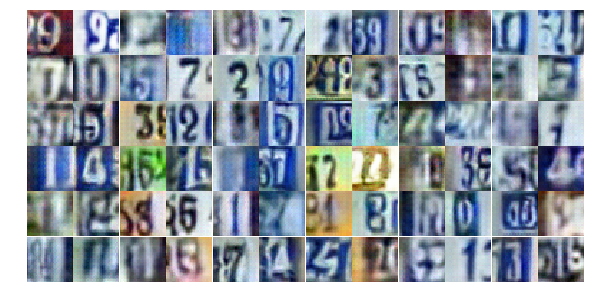

Epoch 24/25... Discriminator Loss: 0.5108... Generator Loss: 1.7107
Epoch 24/25... Discriminator Loss: 0.6018... Generator Loss: 1.3868
Epoch 24/25... Discriminator Loss: 1.0089... Generator Loss: 0.8380
Epoch 24/25... Discriminator Loss: 0.6119... Generator Loss: 1.2736
Epoch 24/25... Discriminator Loss: 0.0887... Generator Loss: 3.6714
Epoch 24/25... Discriminator Loss: 2.5101... Generator Loss: 0.2207
Epoch 24/25... Discriminator Loss: 0.5971... Generator Loss: 1.3993
Epoch 24/25... Discriminator Loss: 0.6519... Generator Loss: 1.1178
Epoch 24/25... Discriminator Loss: 0.0519... Generator Loss: 4.3948
Epoch 24/25... Discriminator Loss: 0.0793... Generator Loss: 3.3884


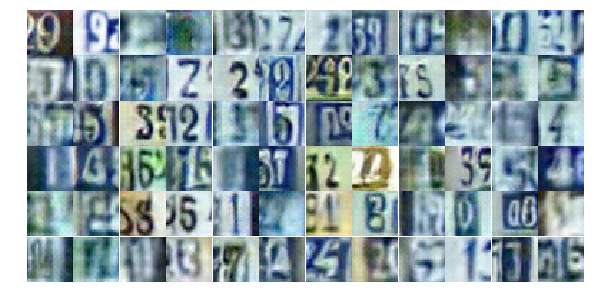

Epoch 24/25... Discriminator Loss: 0.0939... Generator Loss: 3.2014
Epoch 24/25... Discriminator Loss: 1.2143... Generator Loss: 0.6911
Epoch 24/25... Discriminator Loss: 1.4753... Generator Loss: 0.5603
Epoch 24/25... Discriminator Loss: 1.0750... Generator Loss: 2.8074
Epoch 24/25... Discriminator Loss: 1.9006... Generator Loss: 0.4508
Epoch 24/25... Discriminator Loss: 0.5024... Generator Loss: 1.5980
Epoch 24/25... Discriminator Loss: 1.2969... Generator Loss: 0.8157
Epoch 24/25... Discriminator Loss: 0.7368... Generator Loss: 1.0787
Epoch 24/25... Discriminator Loss: 1.0304... Generator Loss: 1.5771
Epoch 24/25... Discriminator Loss: 1.0370... Generator Loss: 2.2109


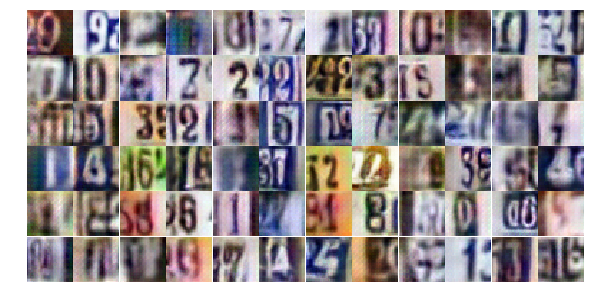

Epoch 24/25... Discriminator Loss: 1.6432... Generator Loss: 0.4167
Epoch 24/25... Discriminator Loss: 1.2955... Generator Loss: 0.6170
Epoch 24/25... Discriminator Loss: 1.3895... Generator Loss: 0.5255
Epoch 24/25... Discriminator Loss: 1.9339... Generator Loss: 4.2923
Epoch 24/25... Discriminator Loss: 1.6617... Generator Loss: 0.4466
Epoch 25/25... Discriminator Loss: 1.1398... Generator Loss: 0.7760
Epoch 25/25... Discriminator Loss: 0.5741... Generator Loss: 1.8809
Epoch 25/25... Discriminator Loss: 0.7357... Generator Loss: 1.1474
Epoch 25/25... Discriminator Loss: 0.7178... Generator Loss: 1.2077
Epoch 25/25... Discriminator Loss: 1.9621... Generator Loss: 0.3275


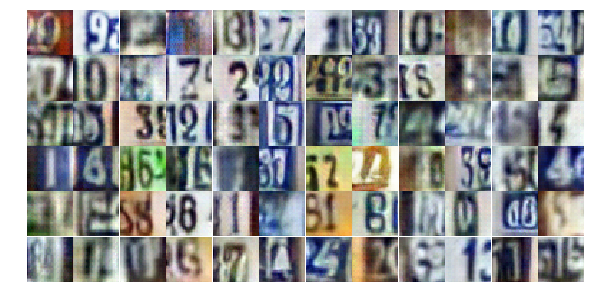

Epoch 25/25... Discriminator Loss: 1.5404... Generator Loss: 0.6009
Epoch 25/25... Discriminator Loss: 0.4668... Generator Loss: 1.7005
Epoch 25/25... Discriminator Loss: 0.1082... Generator Loss: 3.0992
Epoch 25/25... Discriminator Loss: 1.4379... Generator Loss: 0.6283
Epoch 25/25... Discriminator Loss: 1.8543... Generator Loss: 3.9196
Epoch 25/25... Discriminator Loss: 1.9572... Generator Loss: 0.4361
Epoch 25/25... Discriminator Loss: 1.7172... Generator Loss: 0.3821
Epoch 25/25... Discriminator Loss: 0.6842... Generator Loss: 1.2726
Epoch 25/25... Discriminator Loss: 0.8676... Generator Loss: 0.9206
Epoch 25/25... Discriminator Loss: 1.5745... Generator Loss: 0.4166


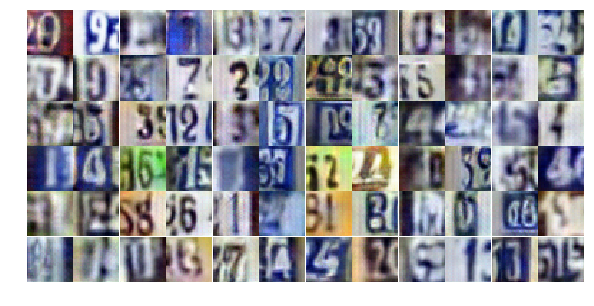

Epoch 25/25... Discriminator Loss: 0.7982... Generator Loss: 1.1038
Epoch 25/25... Discriminator Loss: 0.5962... Generator Loss: 2.7925
Epoch 25/25... Discriminator Loss: 1.1216... Generator Loss: 0.9389
Epoch 25/25... Discriminator Loss: 2.0017... Generator Loss: 0.5941
Epoch 25/25... Discriminator Loss: 1.4152... Generator Loss: 0.5698
Epoch 25/25... Discriminator Loss: 0.7235... Generator Loss: 1.2463
Epoch 25/25... Discriminator Loss: 1.6181... Generator Loss: 0.4104
Epoch 25/25... Discriminator Loss: 0.9736... Generator Loss: 0.9484
Epoch 25/25... Discriminator Loss: 0.9452... Generator Loss: 0.8622
Epoch 25/25... Discriminator Loss: 2.0120... Generator Loss: 0.7136


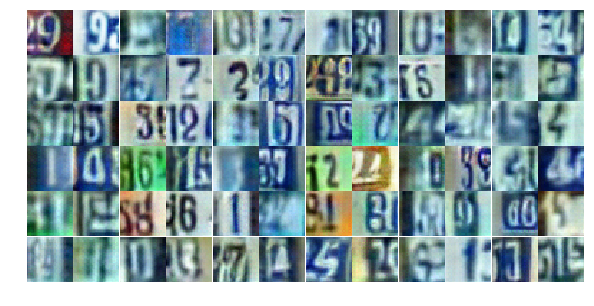

Epoch 25/25... Discriminator Loss: 0.9384... Generator Loss: 1.0955
Epoch 25/25... Discriminator Loss: 0.9669... Generator Loss: 0.7734
Epoch 25/25... Discriminator Loss: 2.5550... Generator Loss: 0.3153
Epoch 25/25... Discriminator Loss: 1.7342... Generator Loss: 0.5032
Epoch 25/25... Discriminator Loss: 0.8622... Generator Loss: 1.1339
Epoch 25/25... Discriminator Loss: 0.5929... Generator Loss: 1.2924
Epoch 25/25... Discriminator Loss: 0.7802... Generator Loss: 1.2789
Epoch 25/25... Discriminator Loss: 0.8848... Generator Loss: 0.9921
Epoch 25/25... Discriminator Loss: 1.8962... Generator Loss: 5.1486
Epoch 25/25... Discriminator Loss: 0.7251... Generator Loss: 1.8519


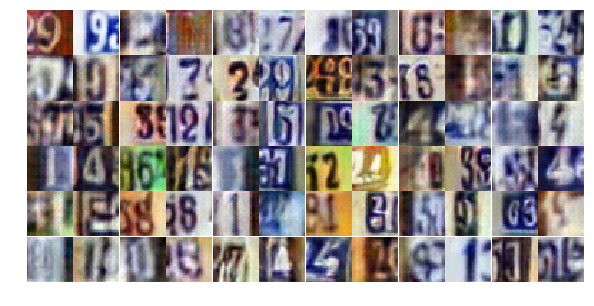

Epoch 25/25... Discriminator Loss: 0.9528... Generator Loss: 1.9605
Epoch 25/25... Discriminator Loss: 1.1502... Generator Loss: 0.7169
Epoch 25/25... Discriminator Loss: 0.3767... Generator Loss: 2.0319
Epoch 25/25... Discriminator Loss: 1.1270... Generator Loss: 0.6794
Epoch 25/25... Discriminator Loss: 1.3699... Generator Loss: 0.5540
Epoch 25/25... Discriminator Loss: 2.0500... Generator Loss: 0.4245
Epoch 25/25... Discriminator Loss: 0.9199... Generator Loss: 1.0428
Epoch 25/25... Discriminator Loss: 0.6128... Generator Loss: 1.5318
Epoch 25/25... Discriminator Loss: 2.5142... Generator Loss: 0.2718
Epoch 25/25... Discriminator Loss: 0.4179... Generator Loss: 1.7479


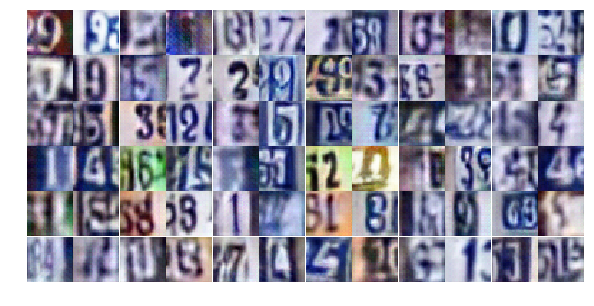

Epoch 25/25... Discriminator Loss: 0.8349... Generator Loss: 0.9356
Epoch 25/25... Discriminator Loss: 0.8215... Generator Loss: 1.0943
Epoch 25/25... Discriminator Loss: 0.9752... Generator Loss: 0.8668
Epoch 25/25... Discriminator Loss: 1.8988... Generator Loss: 0.4731
Epoch 25/25... Discriminator Loss: 2.1566... Generator Loss: 0.3074
Epoch 25/25... Discriminator Loss: 0.7795... Generator Loss: 0.9425
Epoch 25/25... Discriminator Loss: 1.2248... Generator Loss: 0.6306
Epoch 25/25... Discriminator Loss: 1.3541... Generator Loss: 0.5591
Epoch 25/25... Discriminator Loss: 1.0691... Generator Loss: 0.8514
Epoch 25/25... Discriminator Loss: 1.0241... Generator Loss: 0.6891


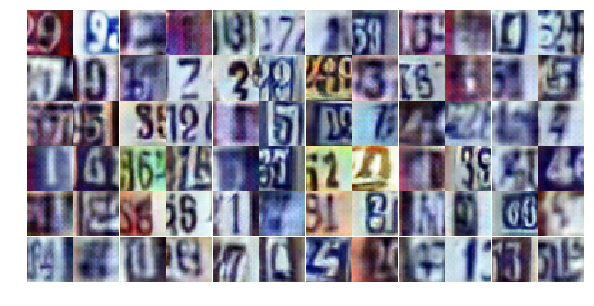

Epoch 25/25... Discriminator Loss: 0.3616... Generator Loss: 3.6982
Epoch 25/25... Discriminator Loss: 0.8673... Generator Loss: 1.2325


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

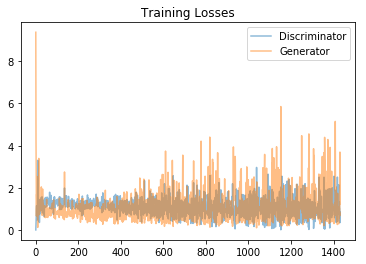

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

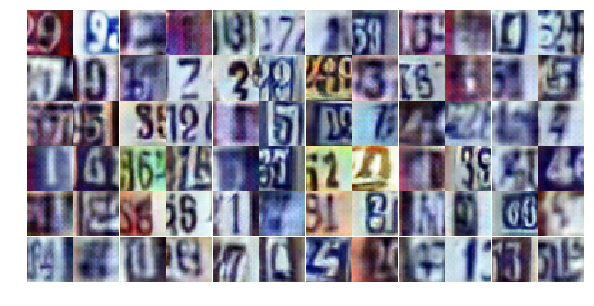

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))